In [10]:
from pycisTopic.clust_vis import find_clusters, run_umap, run_tsne, plot_metadata, plot_topic
import os
import glob
import pickle
import pandas as pd
import matplotlib.pyplot as plt
from IPython.display import Image, display
import math

In [11]:
samples = [x.split('/')[-1].split('__')[0] for x in sorted(glob.glob("cistopic_objects/*singlets.model*topics.pkl"))]
if len(samples) > len(set(samples)):
    print("samples are not unique!")
else:
    print("samples are unique.")

samples are unique.


In [12]:
prediction_path_dict = {x.split('/')[-1].split(f'__')[0]: x for x in sorted(glob.glob("cell_type_classification/*__cell_type_seurat.txt"))}
prediction_path_dict

{'BIO_ddseq_1.FULL': 'cell_type_classification/BIO_ddseq_1.FULL__cell_type_seurat.txt',
 'BIO_ddseq_2.FULL': 'cell_type_classification/BIO_ddseq_2.FULL__cell_type_seurat.txt',
 'BIO_ddseq_3.FULL': 'cell_type_classification/BIO_ddseq_3.FULL__cell_type_seurat.txt',
 'BIO_ddseq_4.FULL': 'cell_type_classification/BIO_ddseq_4.FULL__cell_type_seurat.txt',
 'BRO_mtscatac_1.FULL': 'cell_type_classification/BRO_mtscatac_1.FULL__cell_type_seurat.txt',
 'BRO_mtscatac_2.FULL': 'cell_type_classification/BRO_mtscatac_2.FULL__cell_type_seurat.txt',
 'CNA_10xmultiome_1.FULL': 'cell_type_classification/CNA_10xmultiome_1.FULL__cell_type_seurat.txt',
 'CNA_10xmultiome_2.FULL': 'cell_type_classification/CNA_10xmultiome_2.FULL__cell_type_seurat.txt',
 'CNA_10xv11_1.FULL': 'cell_type_classification/CNA_10xv11_1.FULL__cell_type_seurat.txt',
 'CNA_10xv11_2.FULL': 'cell_type_classification/CNA_10xv11_2.FULL__cell_type_seurat.txt',
 'CNA_10xv11_3.FULL': 'cell_type_classification/CNA_10xv11_3.FULL__cell_type_seu

In [13]:
cto_model_path_dict = {x.split('/')[-1].split(f'__')[0]: x for x in sorted(glob.glob("cistopic_objects/*singlets.model*topics.pkl"))}
cto_model_path_dict

{'BIO_ddseq_1.FULL': 'cistopic_objects/BIO_ddseq_1.FULL__cto.scrublet0-4.fmx.singlets.model_11topics.pkl',
 'BIO_ddseq_2.FULL': 'cistopic_objects/BIO_ddseq_2.FULL__cto.scrublet0-4.fmx.singlets.model_9topics.pkl',
 'BIO_ddseq_3.FULL': 'cistopic_objects/BIO_ddseq_3.FULL__cto.scrublet0-4.fmx.singlets.model_11topics.pkl',
 'BIO_ddseq_4.FULL': 'cistopic_objects/BIO_ddseq_4.FULL__cto.scrublet0-4.fmx.singlets.model_9topics.pkl',
 'BRO_mtscatac_1.FULL': 'cistopic_objects/BRO_mtscatac_1.FULL__cto.scrublet0-4.fmx.singlets.model_11topics.pkl',
 'BRO_mtscatac_2.FULL': 'cistopic_objects/BRO_mtscatac_2.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.pkl',
 'CNA_10xmultiome_1.FULL': 'cistopic_objects/CNA_10xmultiome_1.FULL__cto.scrublet0-4.fmx.singlets.model_12topics.pkl',
 'CNA_10xmultiome_2.FULL': 'cistopic_objects/CNA_10xmultiome_2.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.pkl',
 'CNA_10xv11_1.FULL': 'cistopic_objects/CNA_10xv11_1.FULL__cto.scrublet0-4.fmx.singlets.model_8topics.pkl',
 '

BIO_ddseq_1.FULL
	cistopic_objects/BIO_ddseq_1.FULL__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.pkl exists, skipping


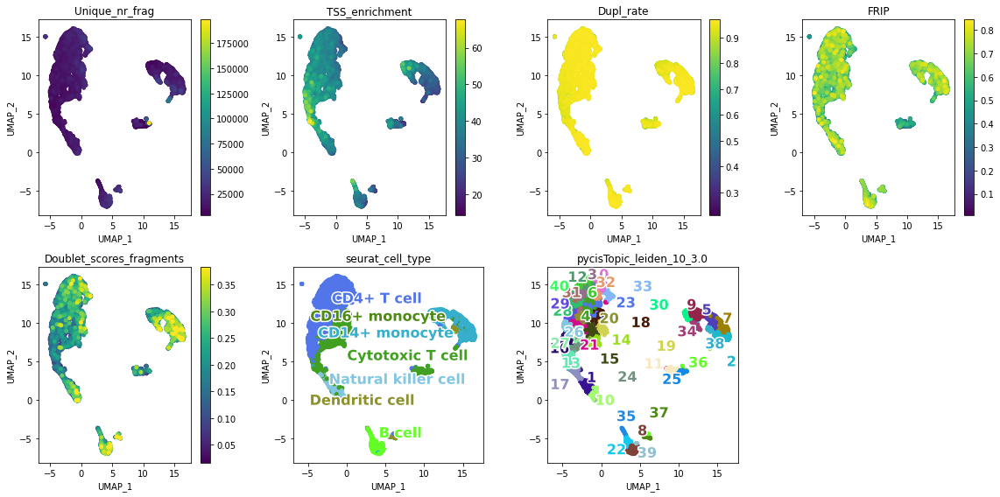

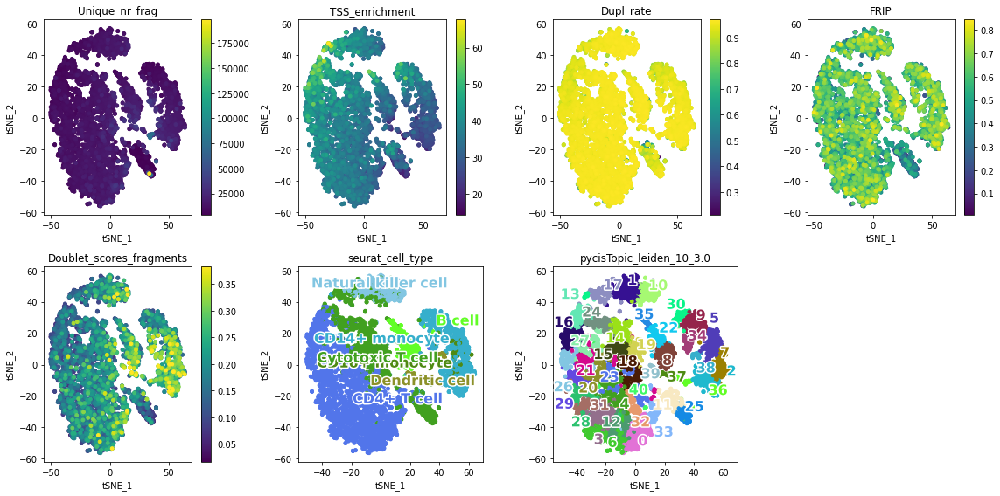

BIO_ddseq_2.FULL
	cistopic_objects/BIO_ddseq_2.FULL__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.pkl exists, skipping


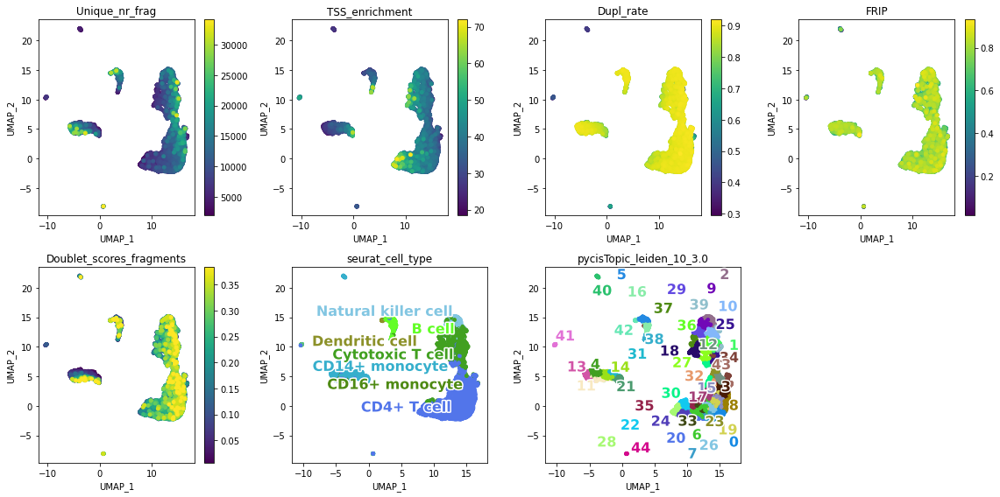

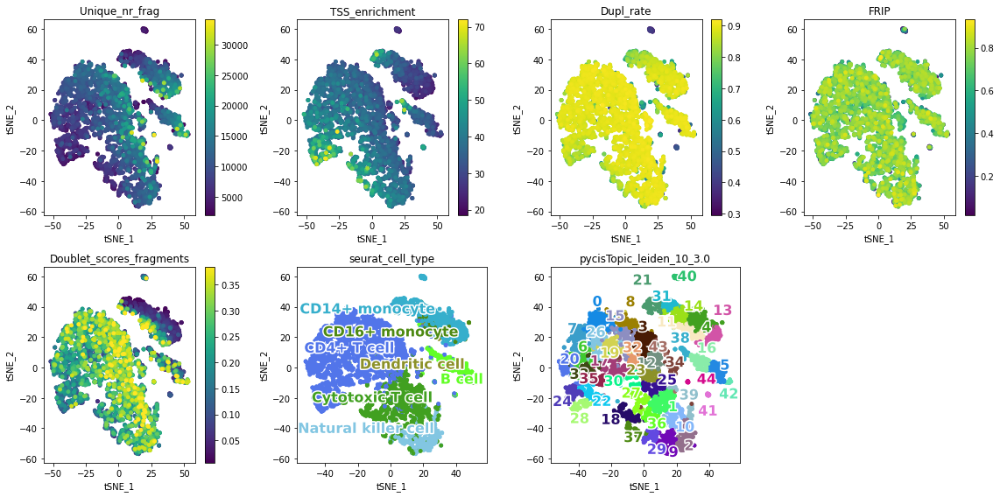

BIO_ddseq_3.FULL
	cistopic_objects/BIO_ddseq_3.FULL__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.pkl exists, skipping


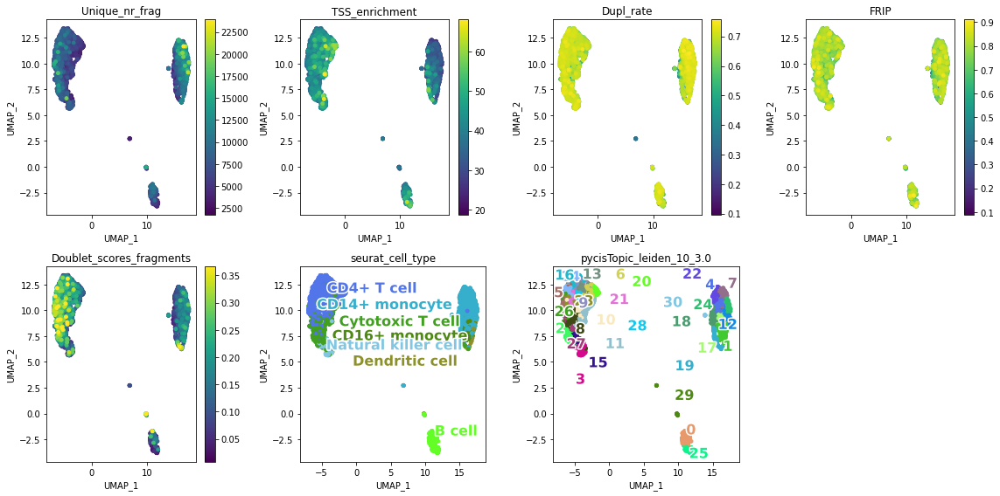

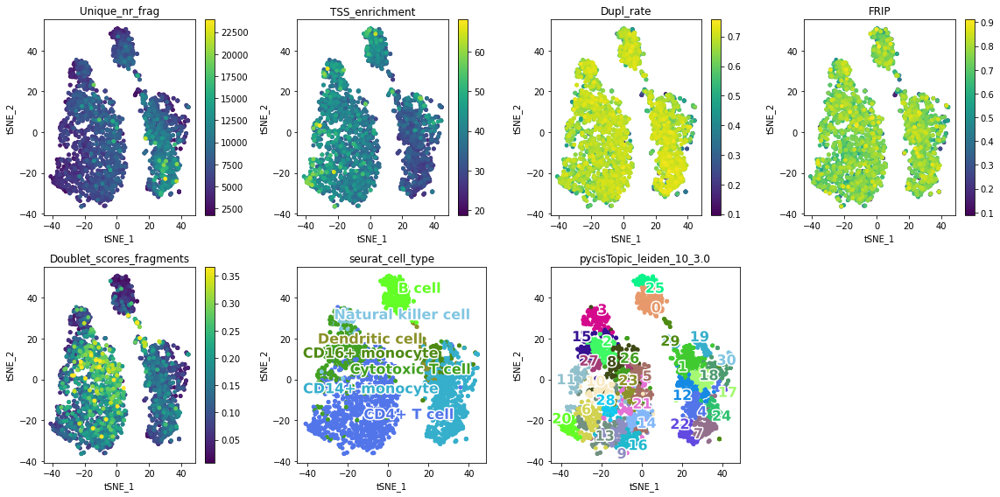

BIO_ddseq_4.FULL
	cistopic_objects/BIO_ddseq_4.FULL__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.pkl exists, skipping


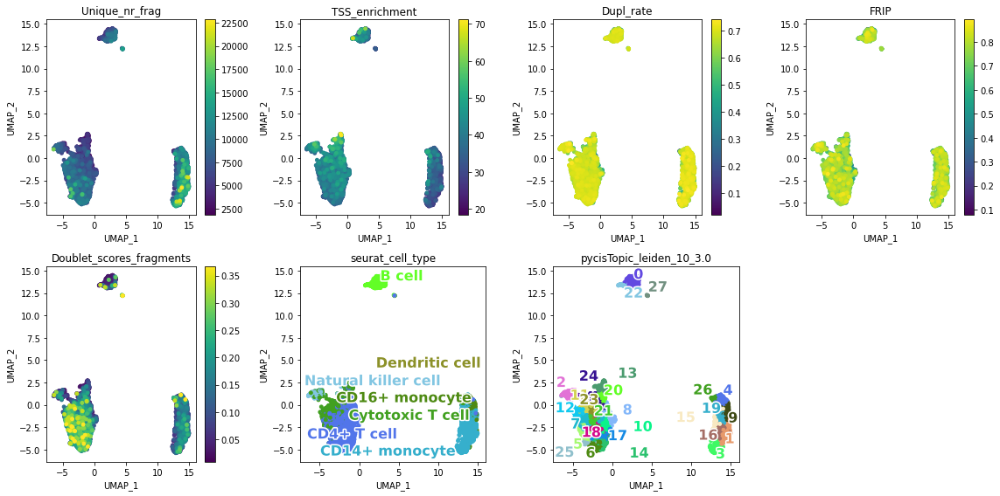

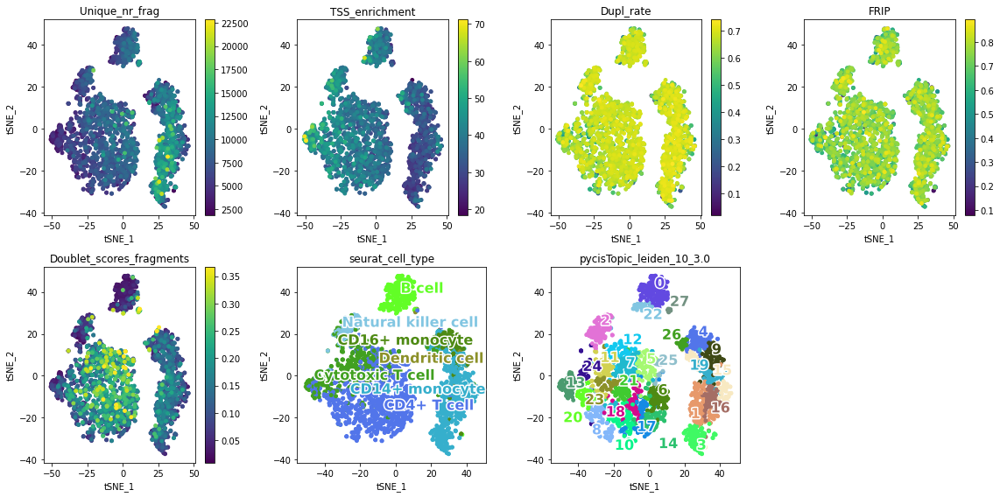

BRO_mtscatac_1.FULL
	cistopic_objects/BRO_mtscatac_1.FULL__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.pkl exists, skipping


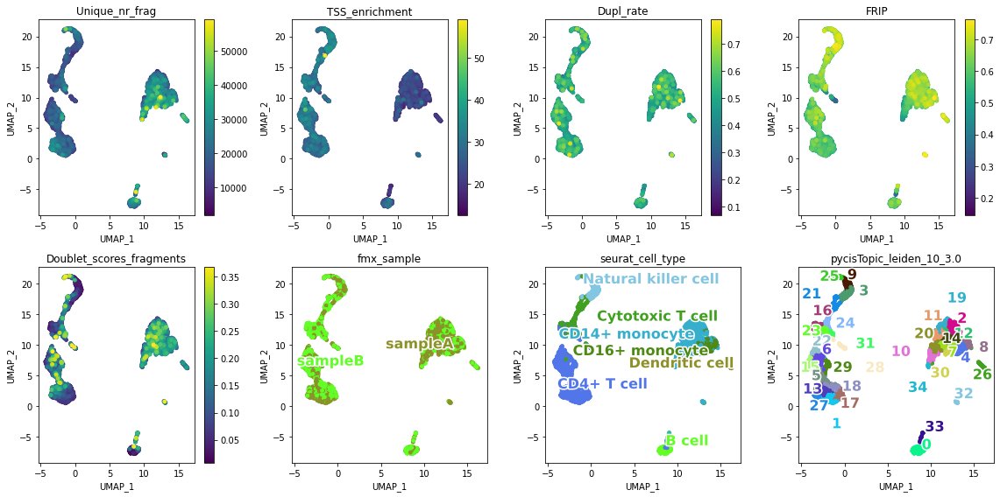

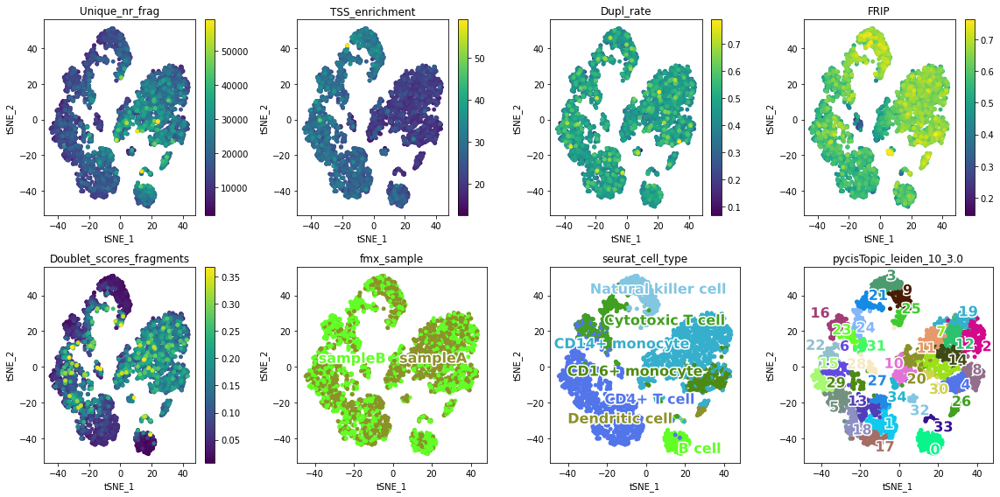

BRO_mtscatac_2.FULL
	cistopic_objects/BRO_mtscatac_2.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.pkl exists, skipping


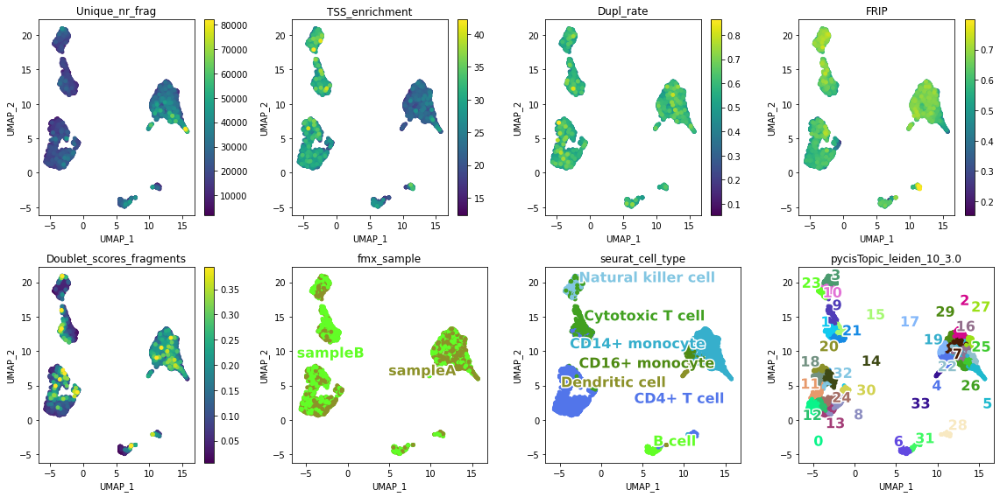

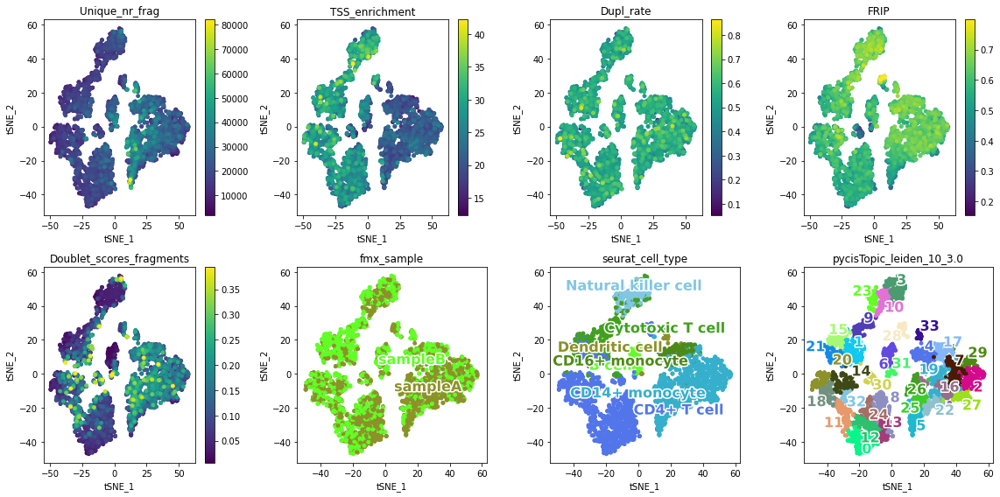

CNA_10xmultiome_1.FULL
	cistopic_objects/CNA_10xmultiome_1.FULL__cto.scrublet0-4.fmx.singlets.model_12topics.dimreduc.pkl exists, skipping


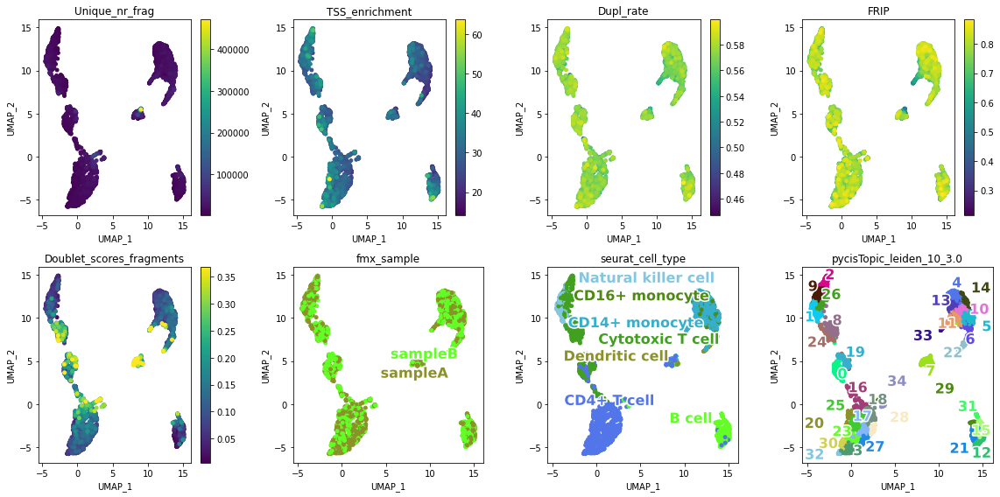

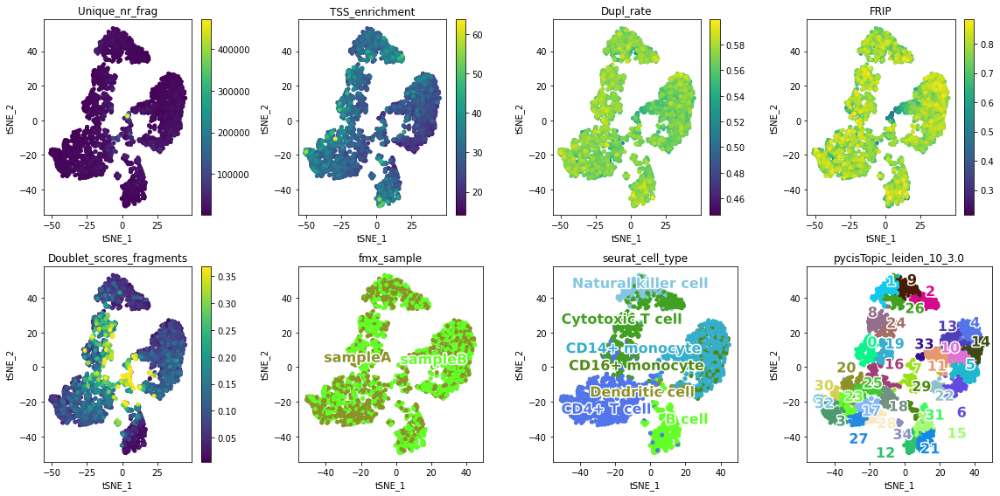

CNA_10xmultiome_2.FULL
	cistopic_objects/CNA_10xmultiome_2.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.pkl exists, skipping


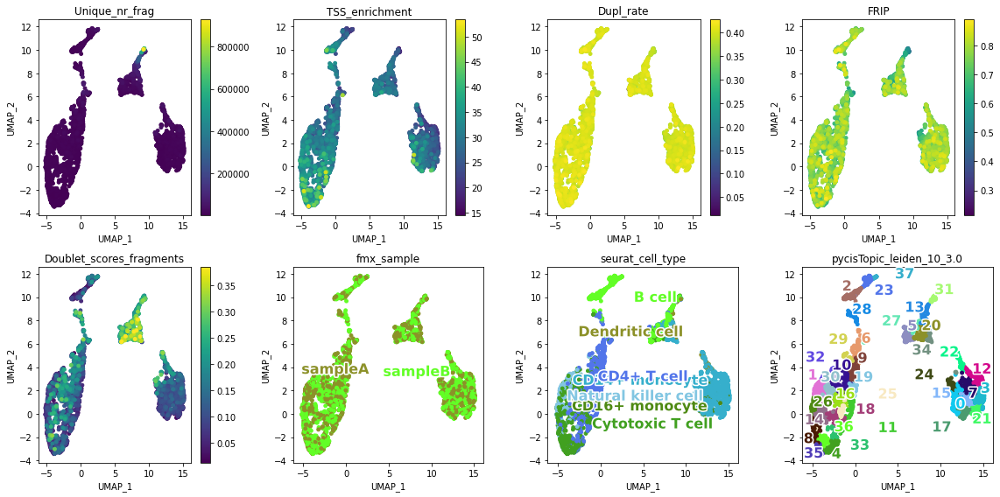

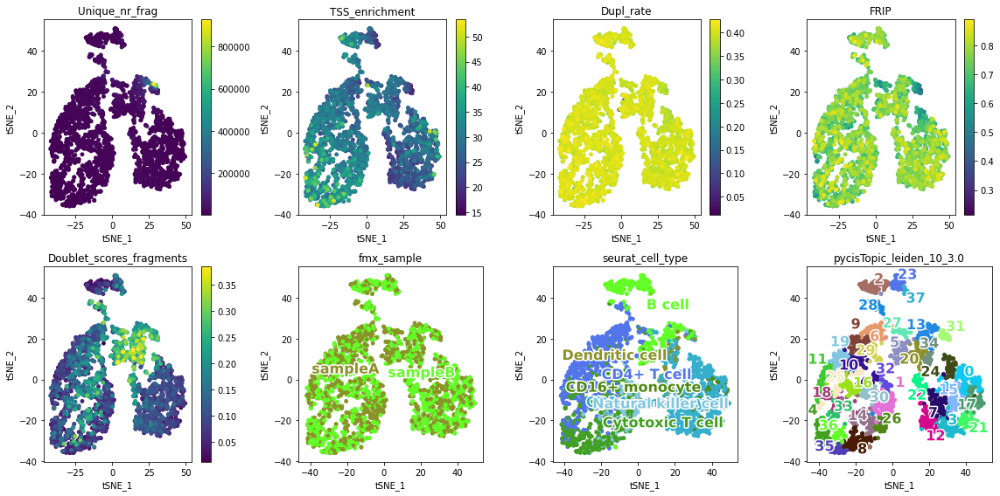

CNA_10xv11_1.FULL
	cistopic_objects/CNA_10xv11_1.FULL__cto.scrublet0-4.fmx.singlets.model_8topics.dimreduc.pkl exists, skipping


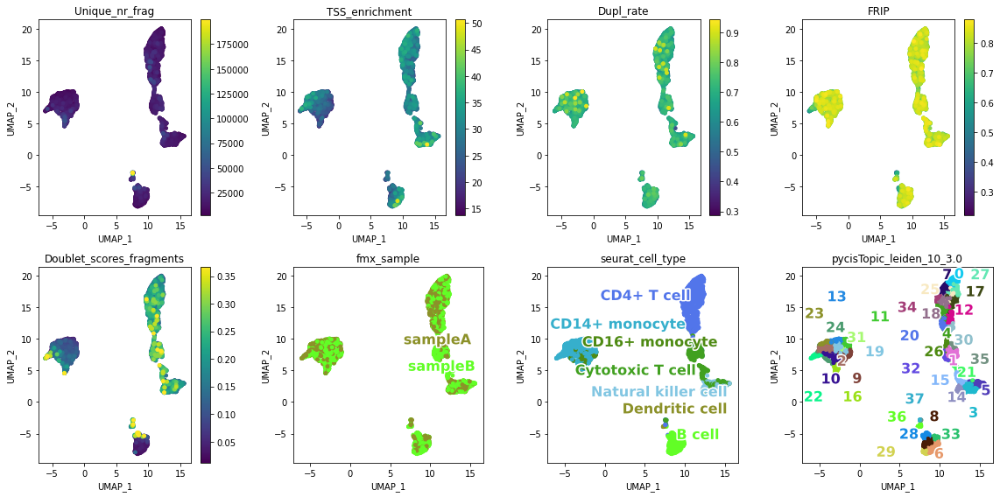

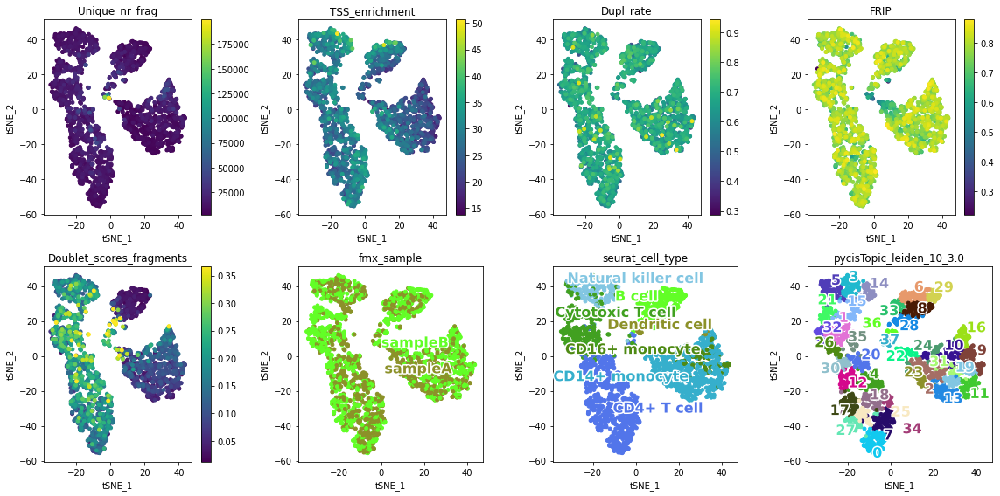

CNA_10xv11_2.FULL
	cistopic_objects/CNA_10xv11_2.FULL__cto.scrublet0-4.fmx.singlets.model_13topics.dimreduc.pkl exists, skipping


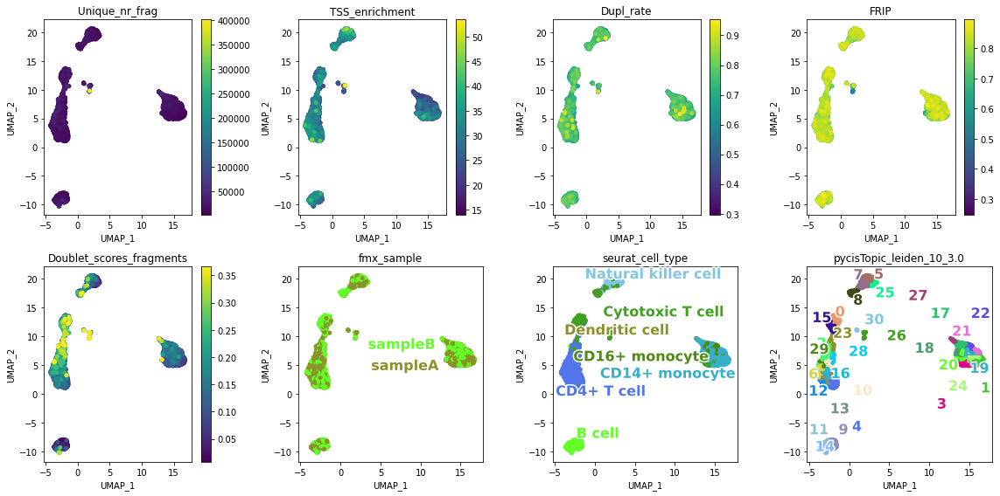

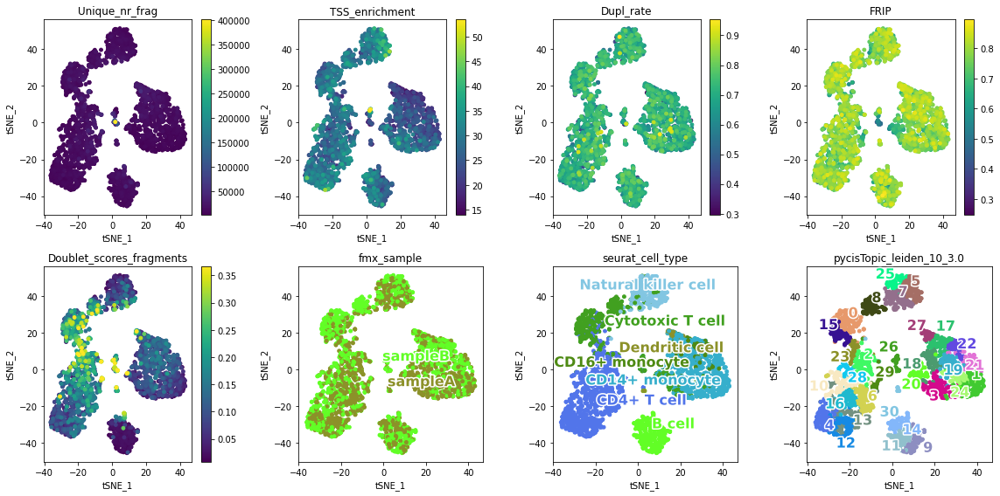

CNA_10xv11_3.FULL
	cistopic_objects/CNA_10xv11_3.FULL__cto.scrublet0-4.fmx.singlets.model_12topics.dimreduc.pkl exists, skipping


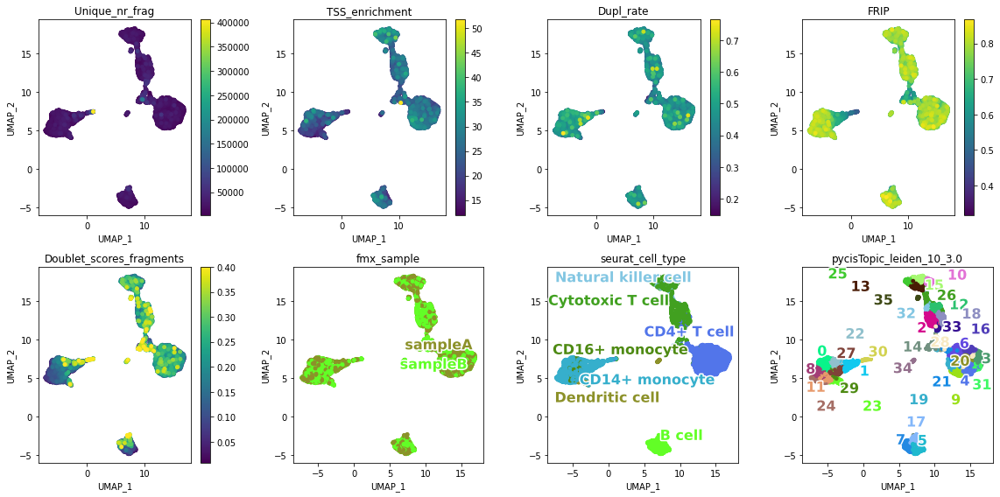

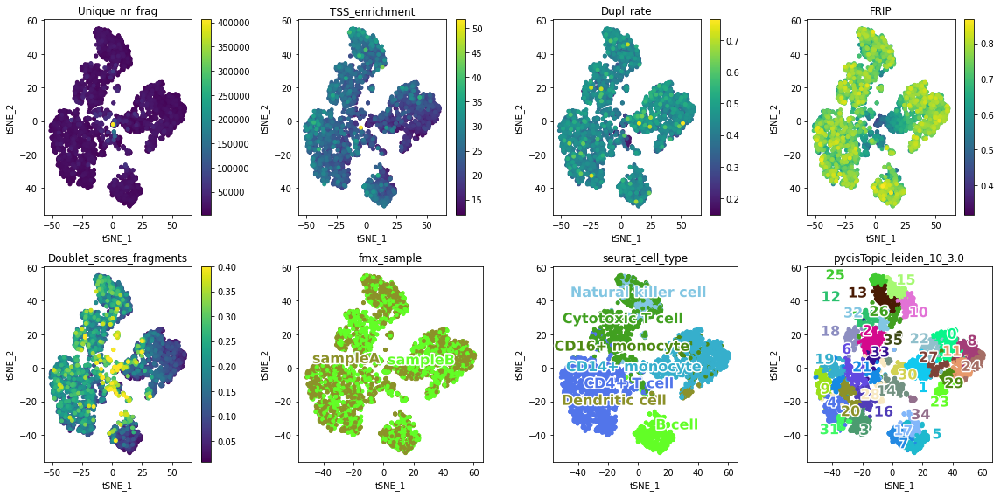

CNA_10xv11_4.FULL
	cistopic_objects/CNA_10xv11_4.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.pkl exists, skipping


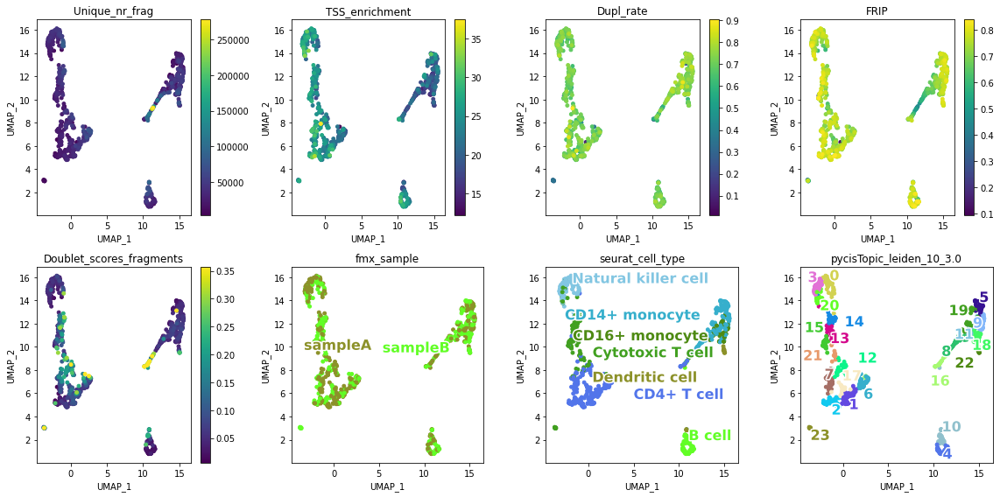

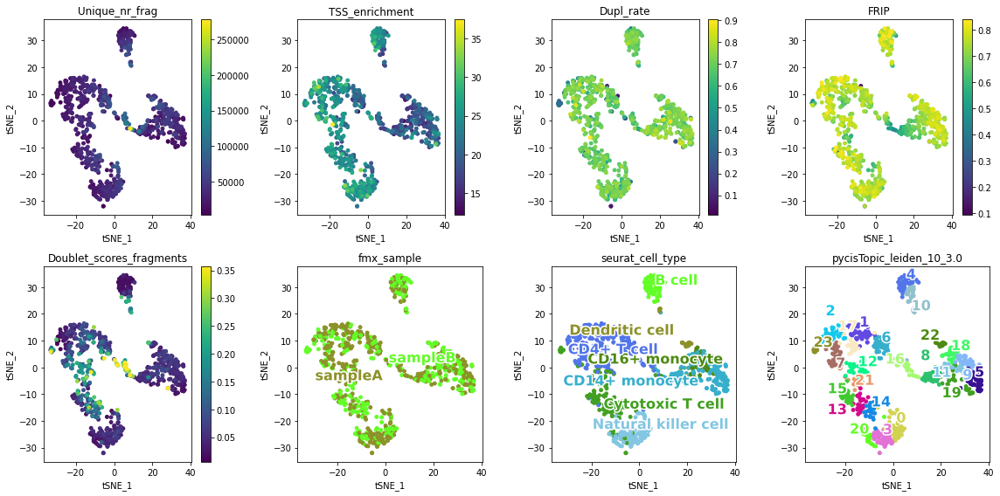

CNA_10xv11_5.FULL
	cistopic_objects/CNA_10xv11_5.FULL__cto.scrublet0-4.fmx.singlets.model_13topics.dimreduc.pkl exists, skipping


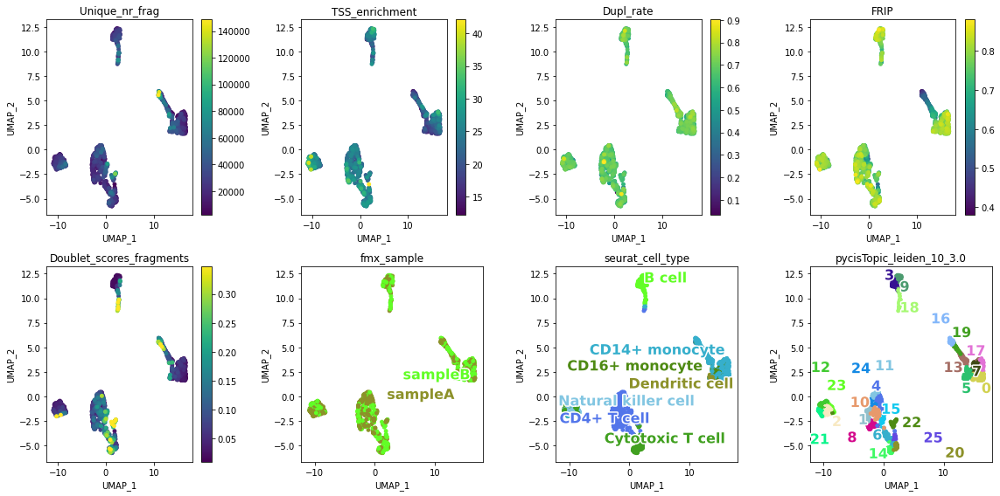

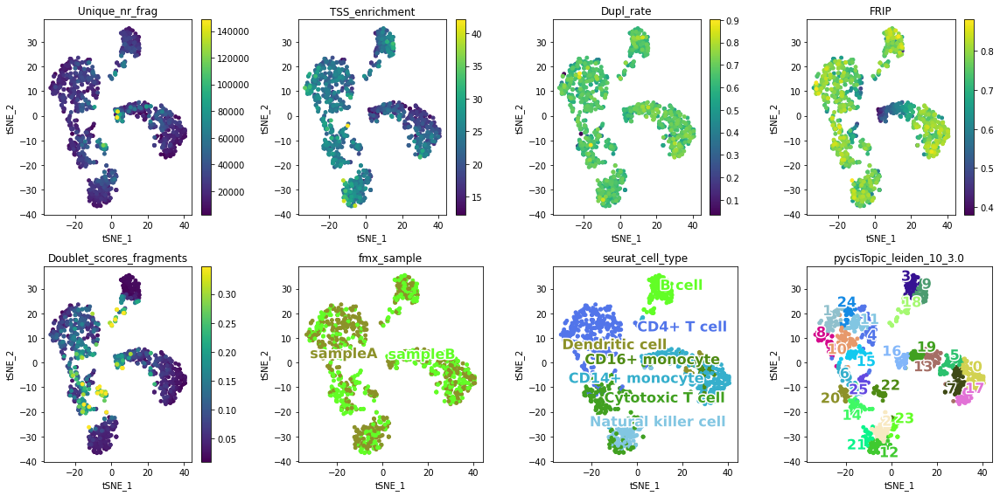

CNA_10xv2_1.FULL
	cistopic_objects/CNA_10xv2_1.FULL__cto.scrublet0-4.fmx.singlets.model_13topics.dimreduc.pkl exists, skipping


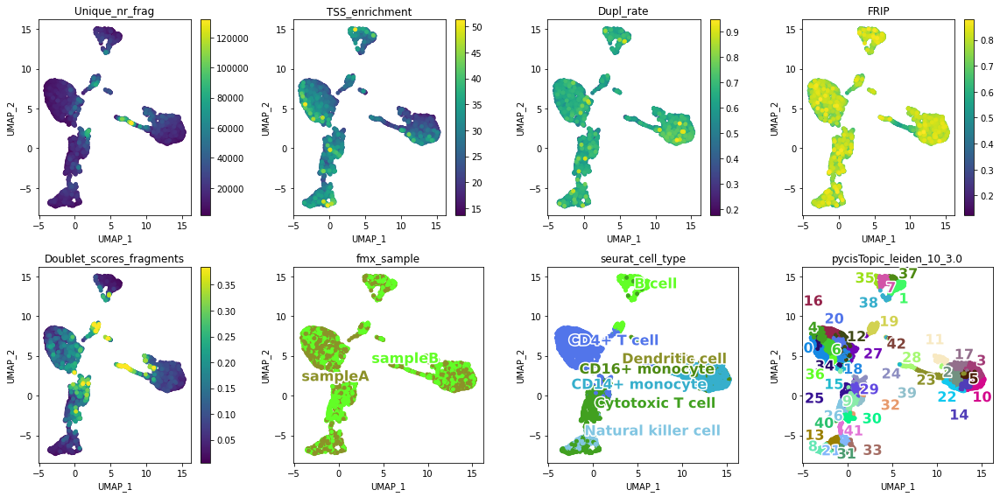

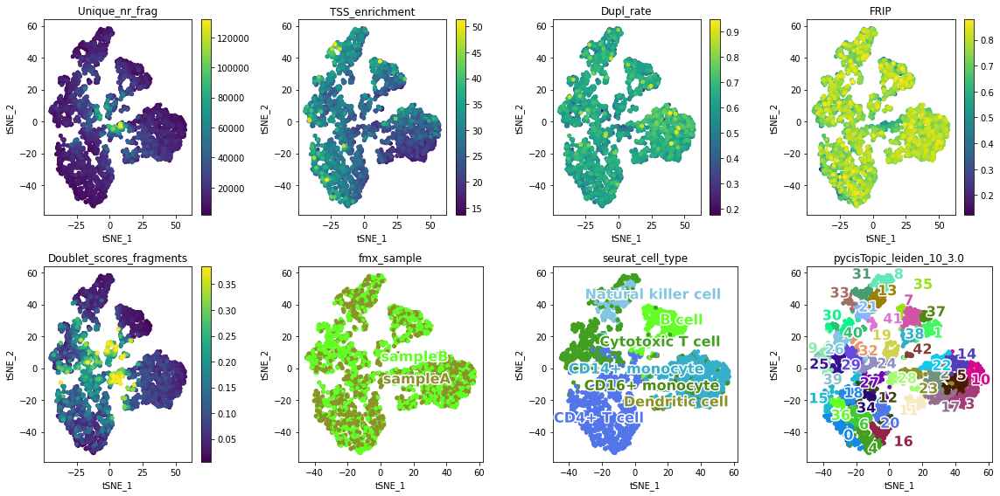

CNA_10xv2_2.FULL
	cistopic_objects/CNA_10xv2_2.FULL__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.pkl exists, skipping


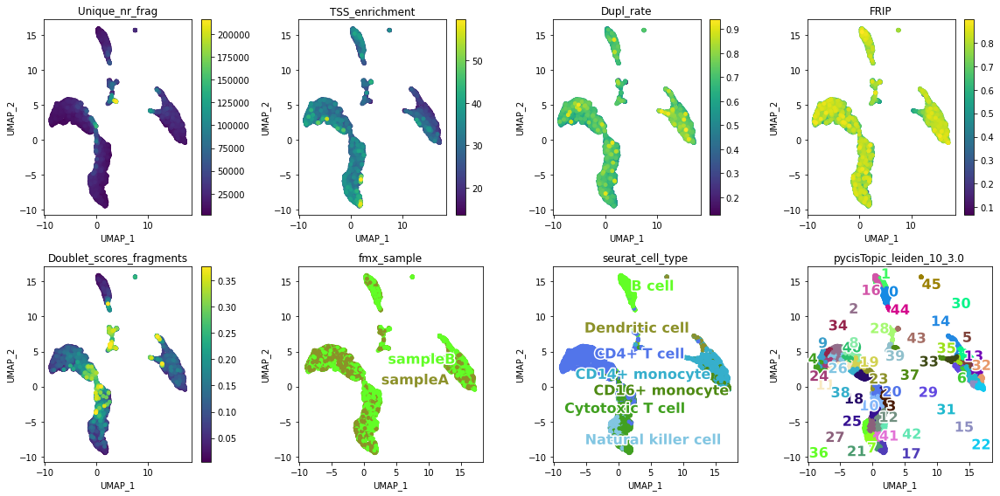

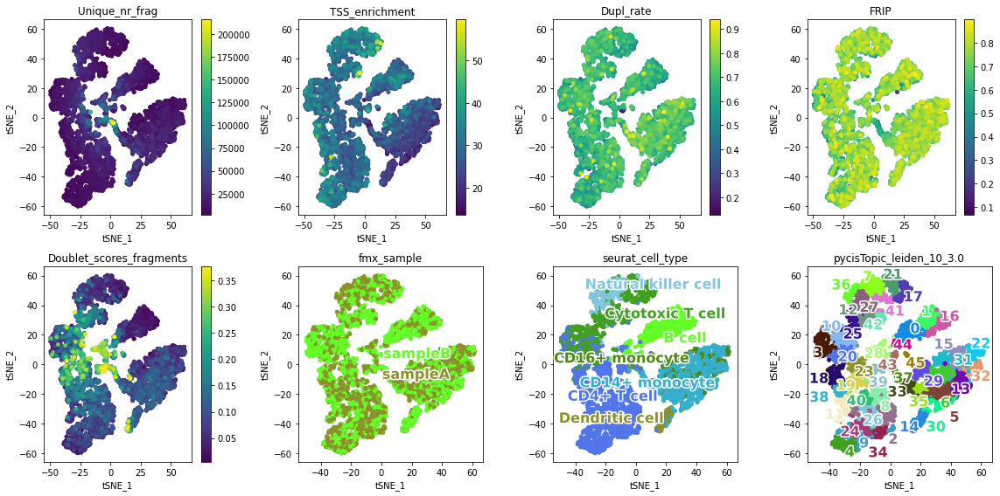

CNA_hydrop_1.FULL
	cistopic_objects/CNA_hydrop_1.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.pkl exists, skipping


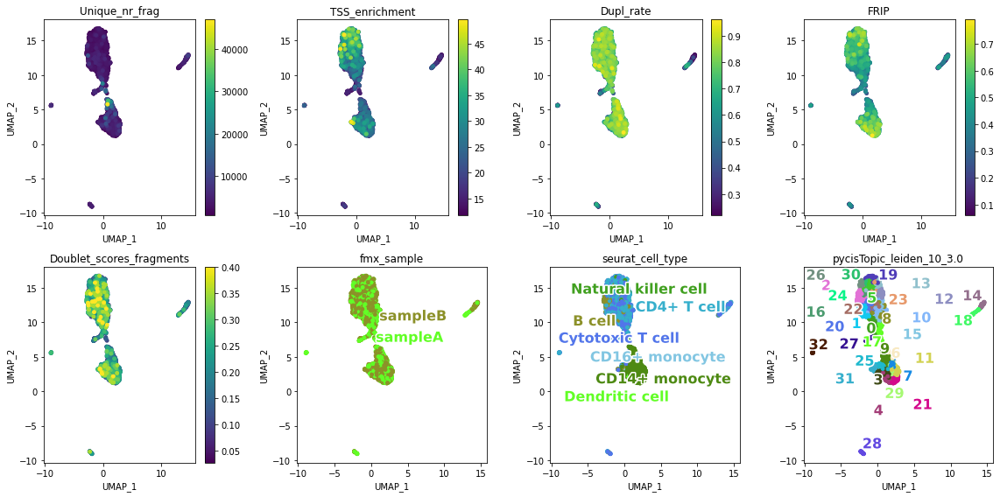

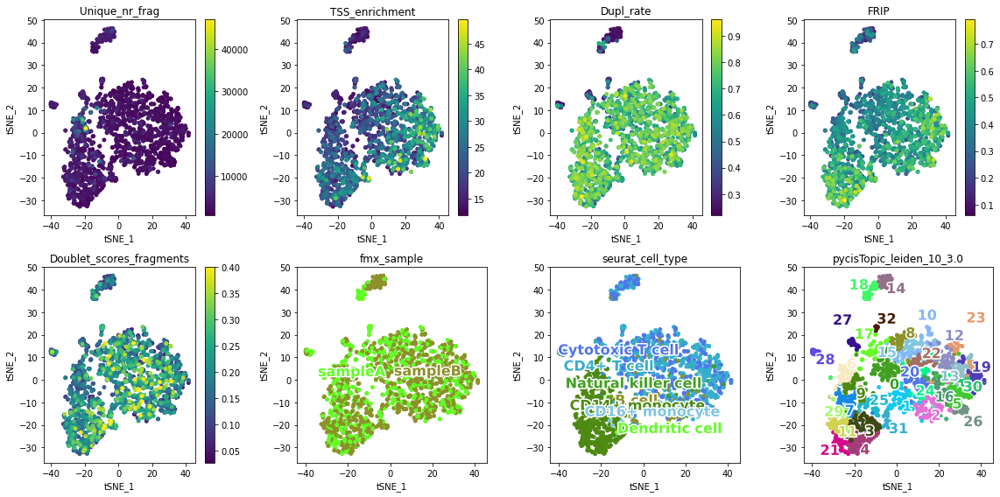

CNA_hydrop_2.FULL
	cistopic_objects/CNA_hydrop_2.FULL__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.pkl exists, skipping


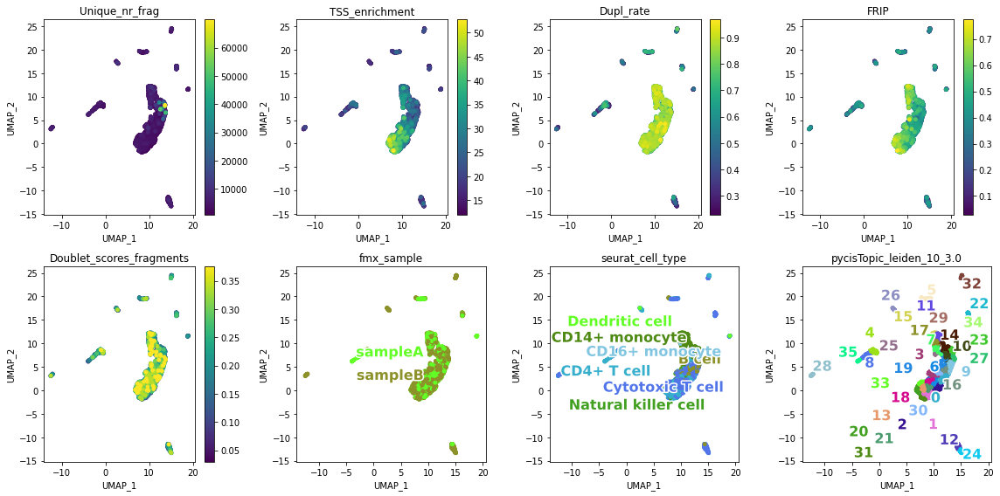

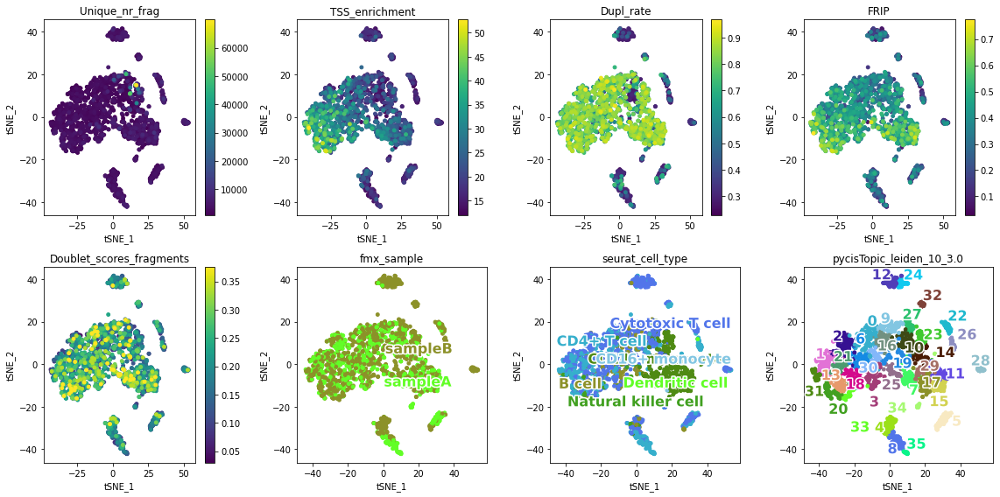

CNA_hydrop_3.FULL
	cistopic_objects/CNA_hydrop_3.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.pkl exists, skipping


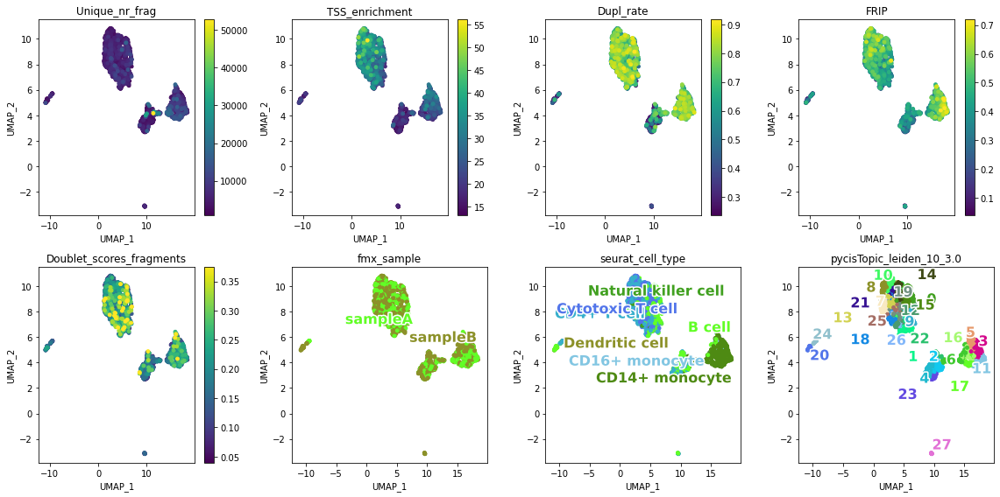

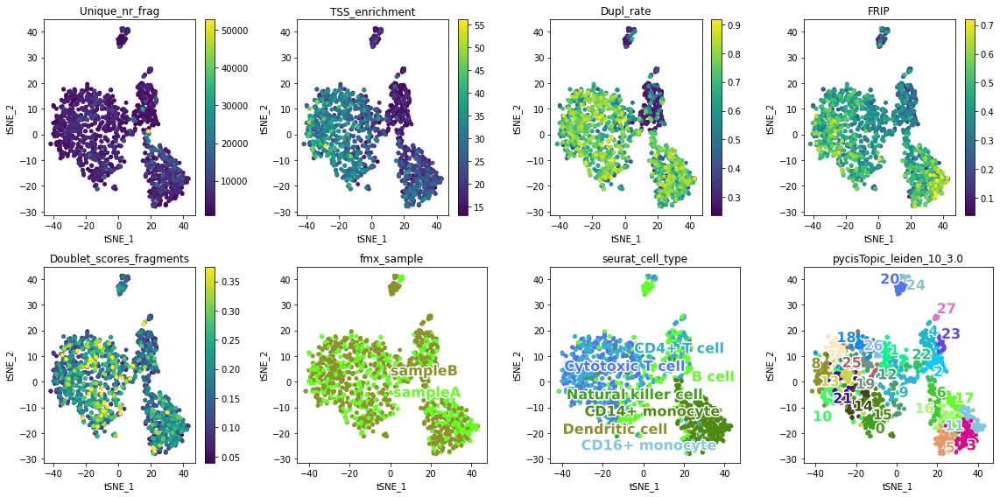

CNA_mtscatac_1.FULL
	cistopic_objects/CNA_mtscatac_1.FULL__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.pkl exists, skipping


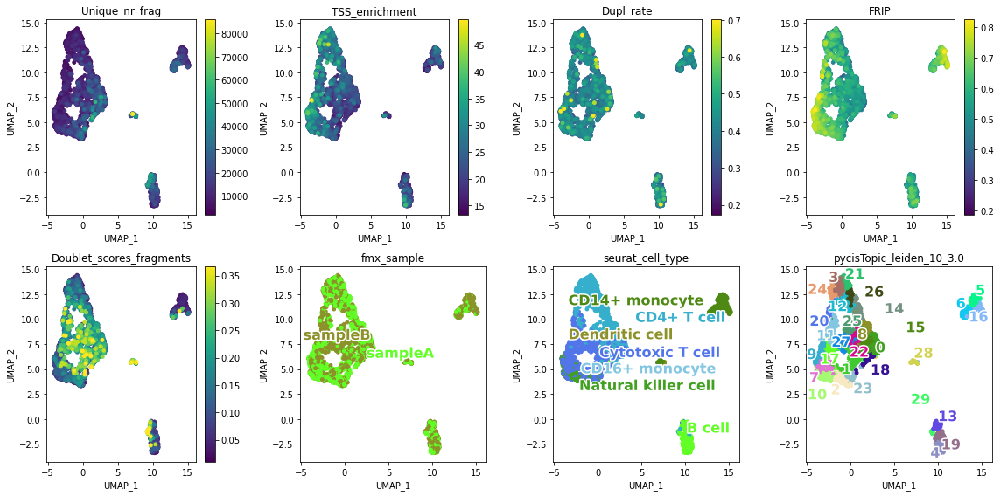

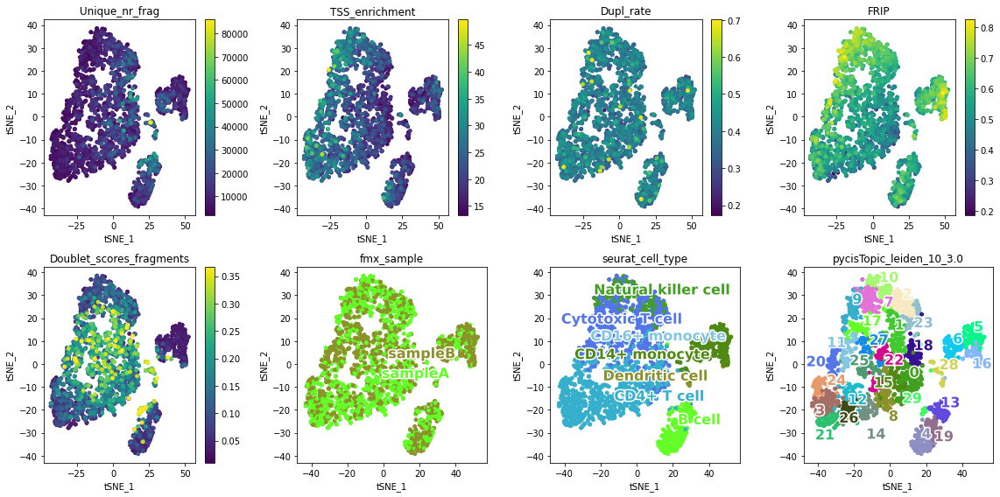

CNA_mtscatac_2.FULL
	cistopic_objects/CNA_mtscatac_2.FULL__cto.scrublet0-4.fmx.singlets.model_12topics.dimreduc.pkl exists, skipping


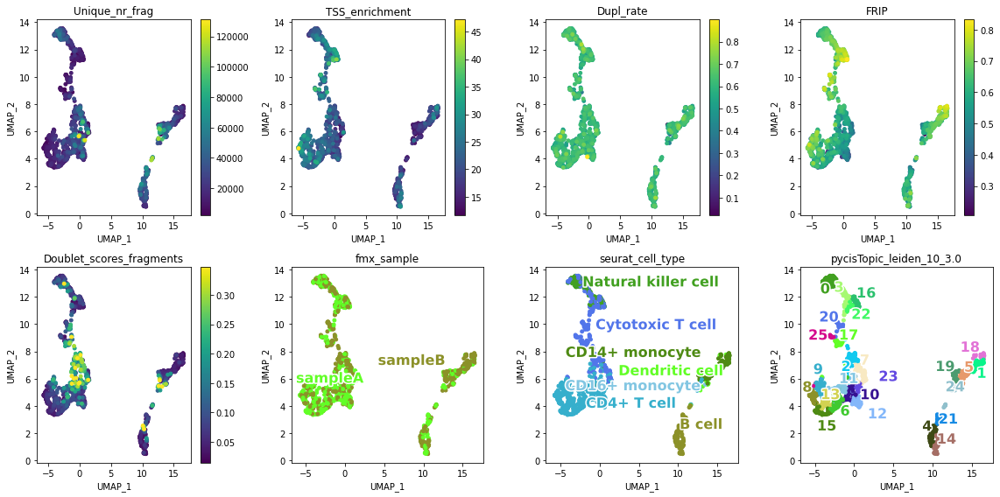

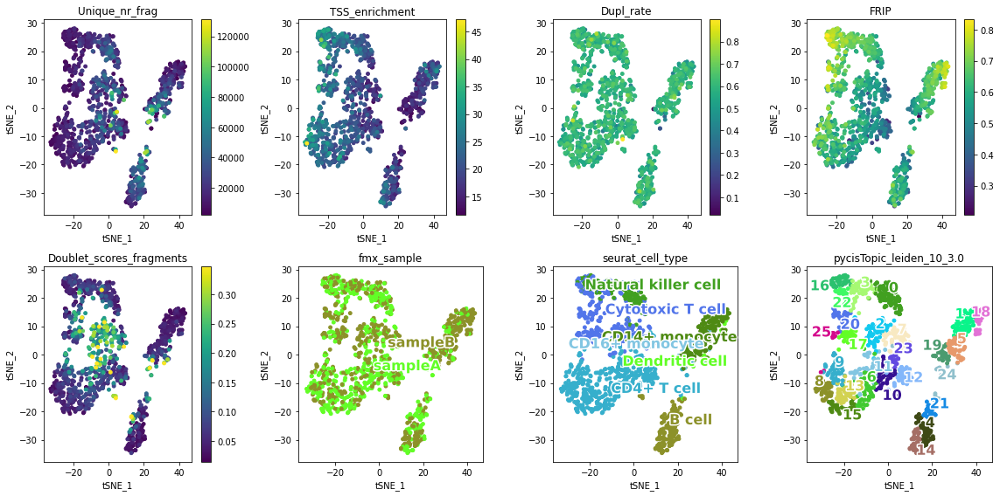

EPF_hydrop_1.FULL
	cistopic_objects/EPF_hydrop_1.FULL__cto.scrublet0-4.fmx.singlets.model_8topics.dimreduc.pkl exists, skipping


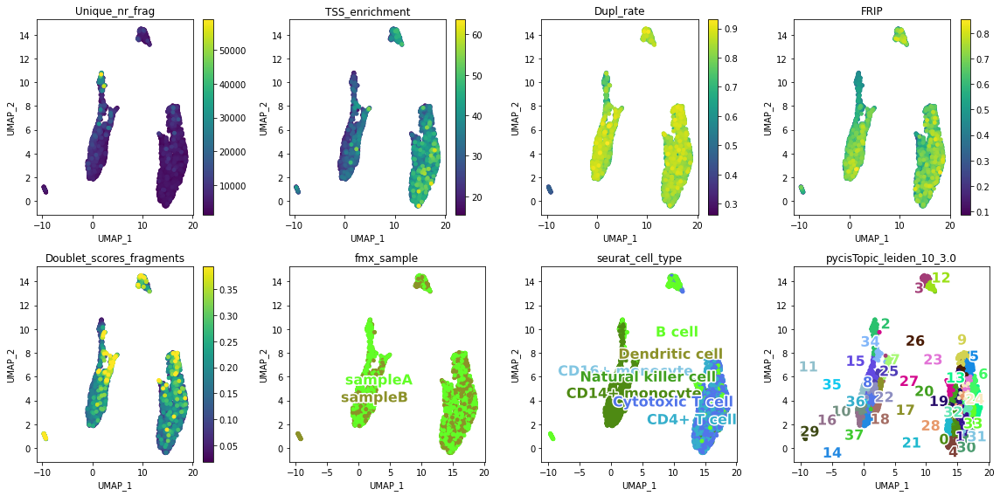

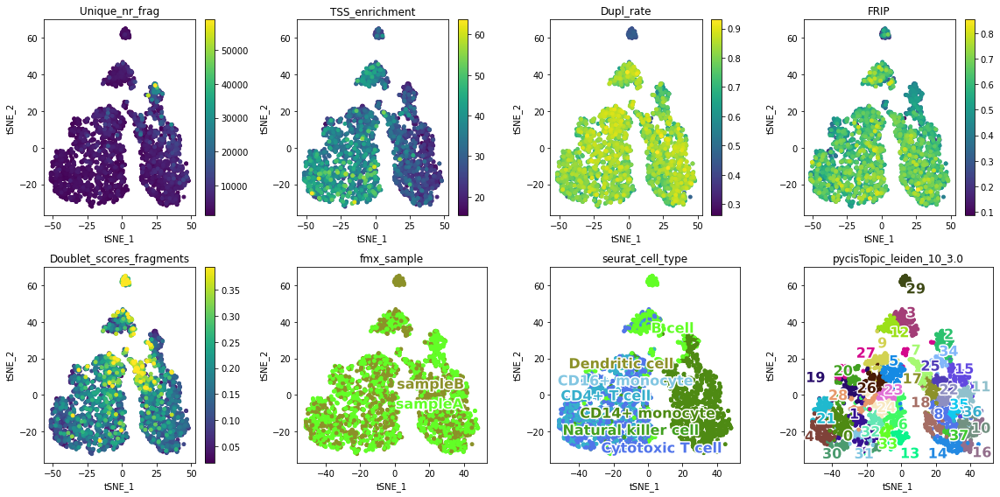

EPF_hydrop_2.FULL
	cistopic_objects/EPF_hydrop_2.FULL__cto.scrublet0-4.fmx.singlets.model_8topics.dimreduc.pkl exists, skipping


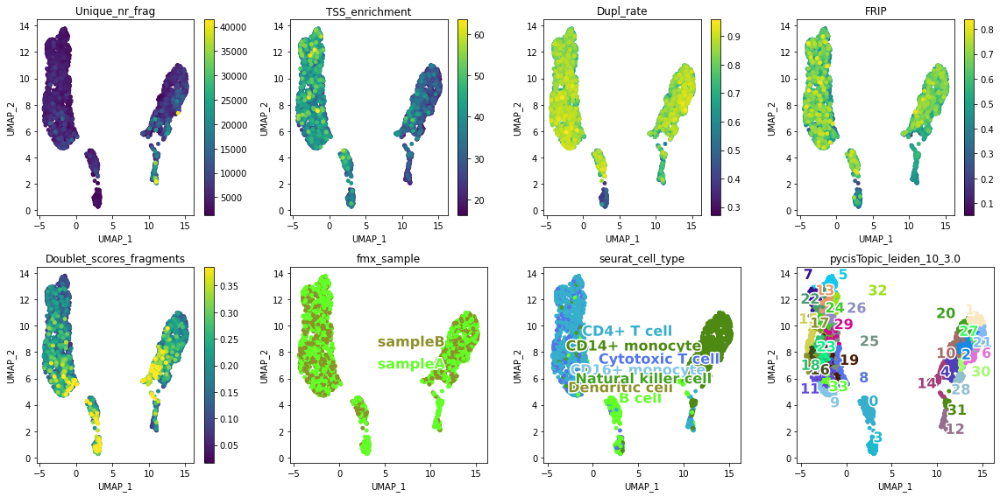

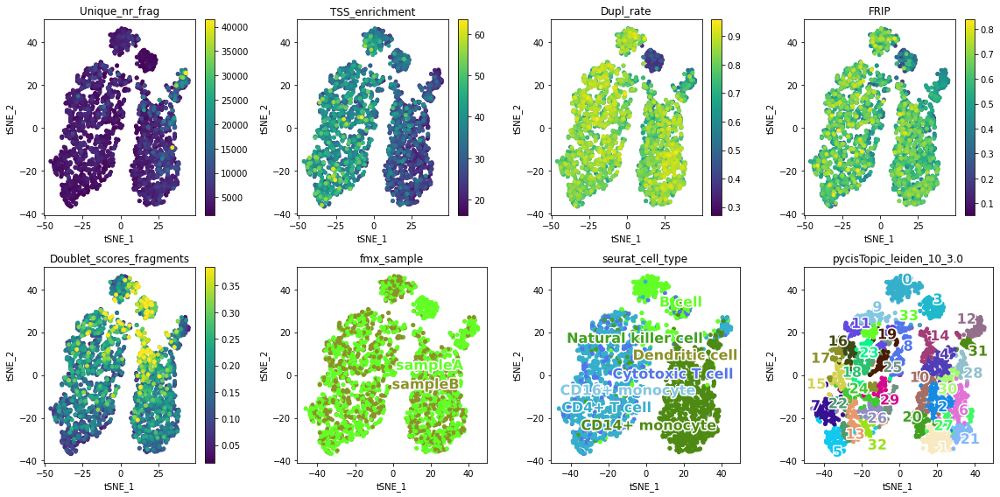

EPF_hydrop_3.FULL
	cistopic_objects/EPF_hydrop_3.FULL__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.pkl exists, skipping


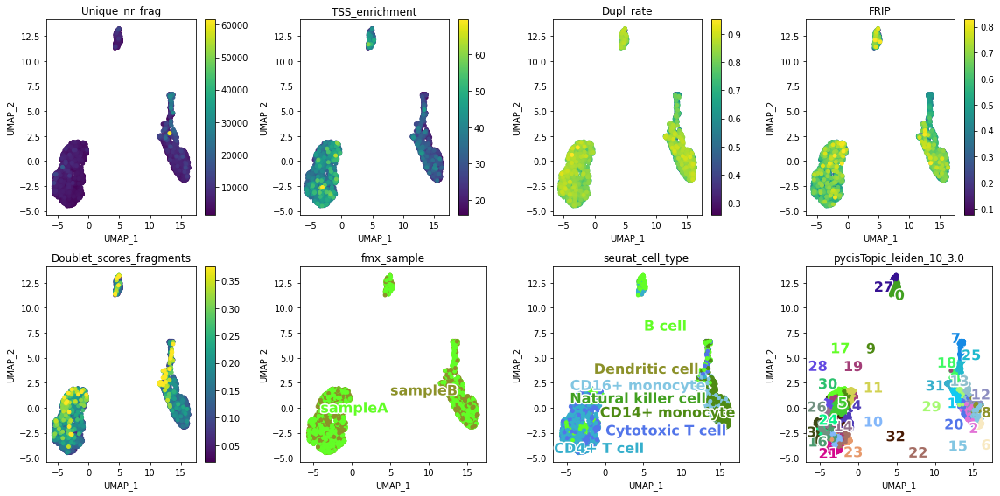

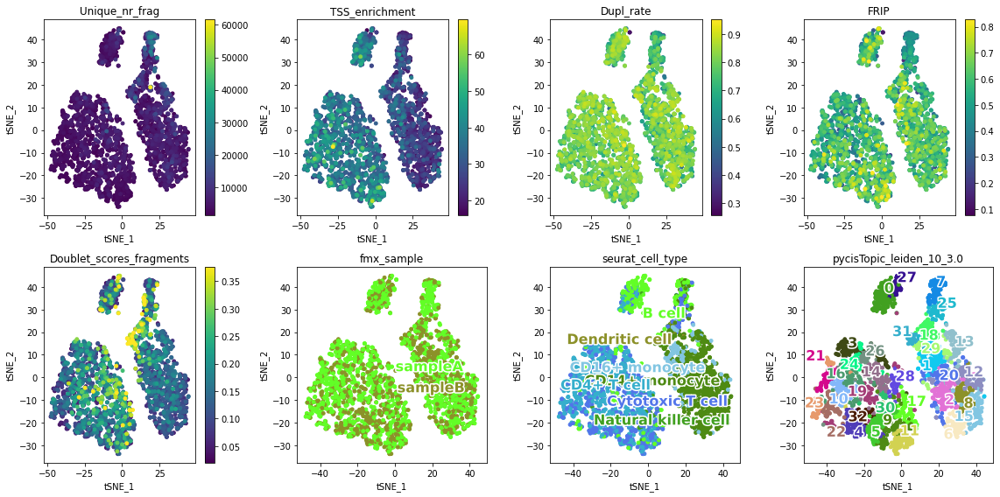

EPF_hydrop_4.FULL
	cistopic_objects/EPF_hydrop_4.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.pkl exists, skipping


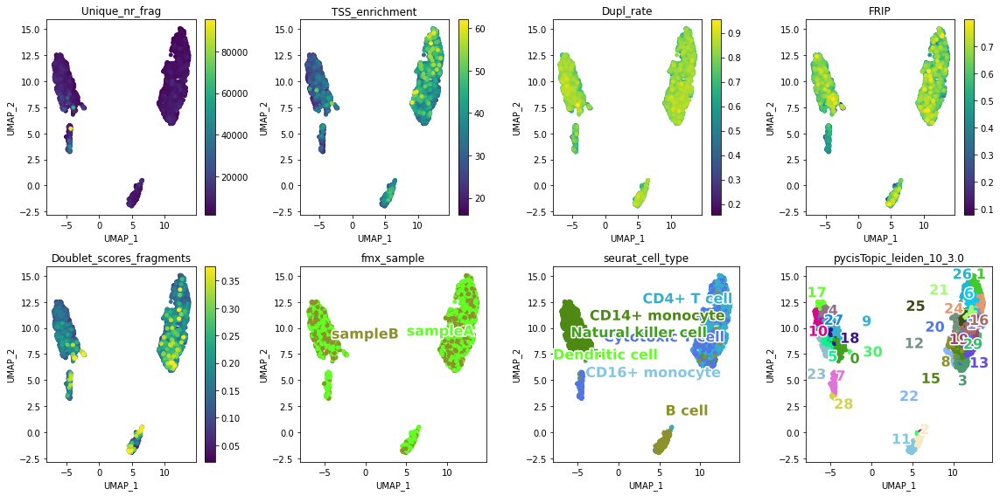

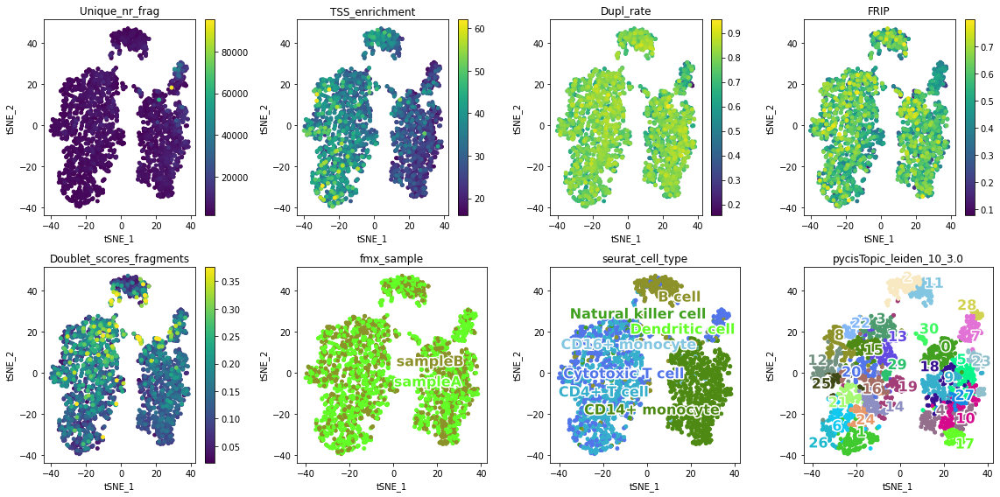

HAR_ddseq_1.FULL
	cistopic_objects/HAR_ddseq_1.FULL__cto.scrublet0-4.fmx.singlets.model_8topics.dimreduc.pkl exists, skipping


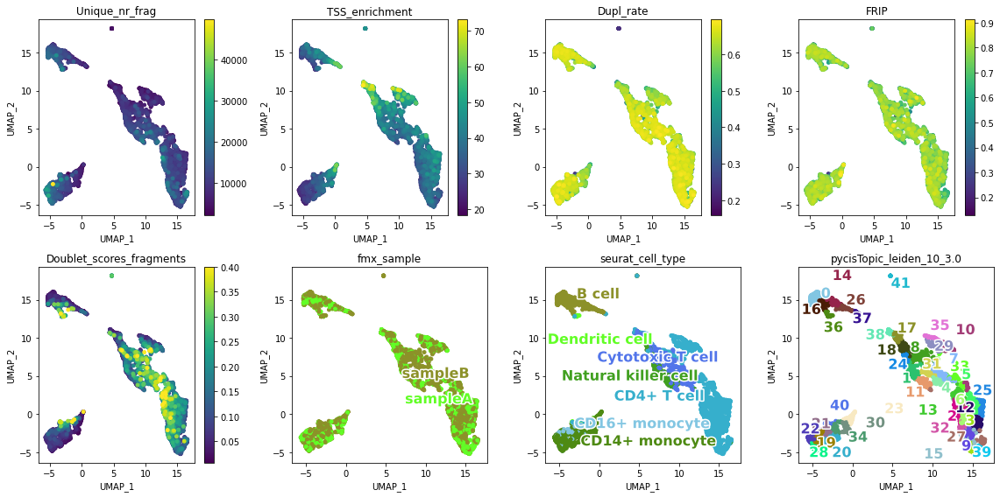

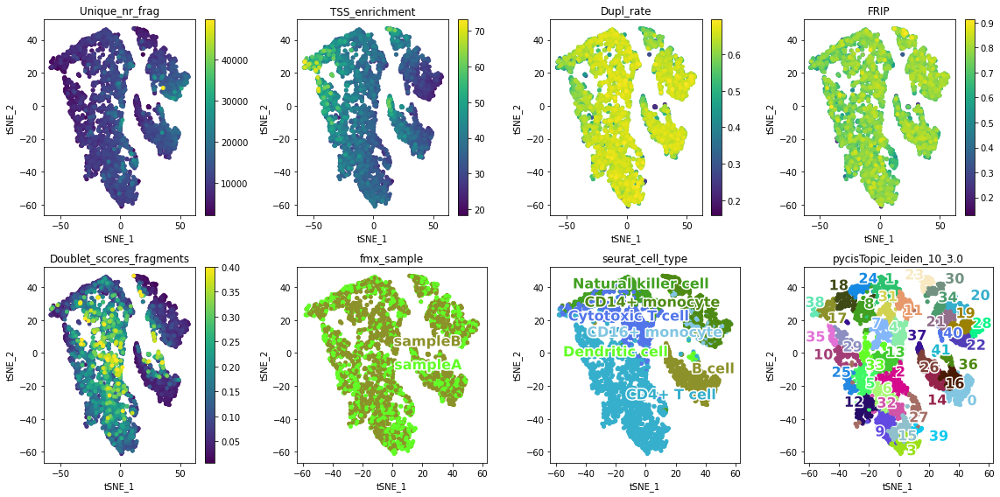

HAR_ddseq_2.FULL
	cistopic_objects/HAR_ddseq_2.FULL__cto.scrublet0-4.fmx.singlets.model_12topics.dimreduc.pkl exists, skipping


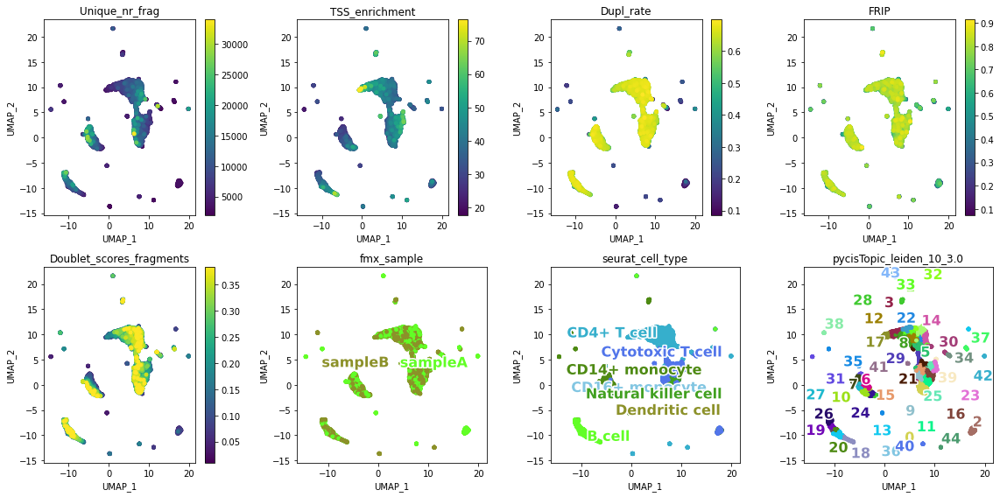

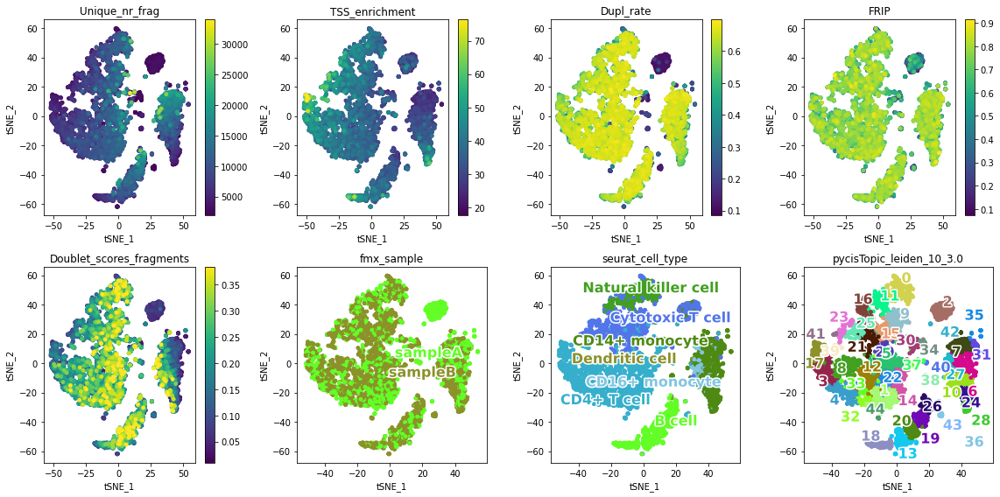

MDC_mtscatac_1.FULL
	cistopic_objects/MDC_mtscatac_1.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.pkl exists, skipping


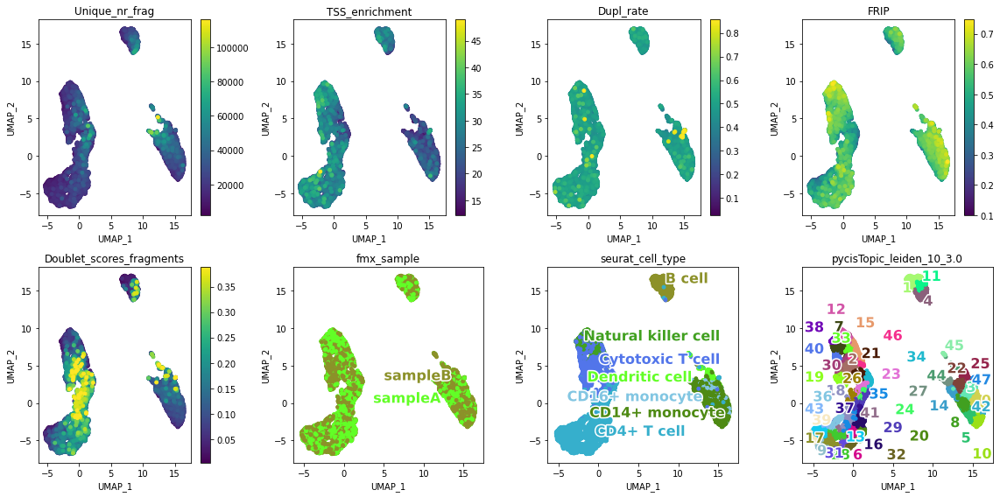

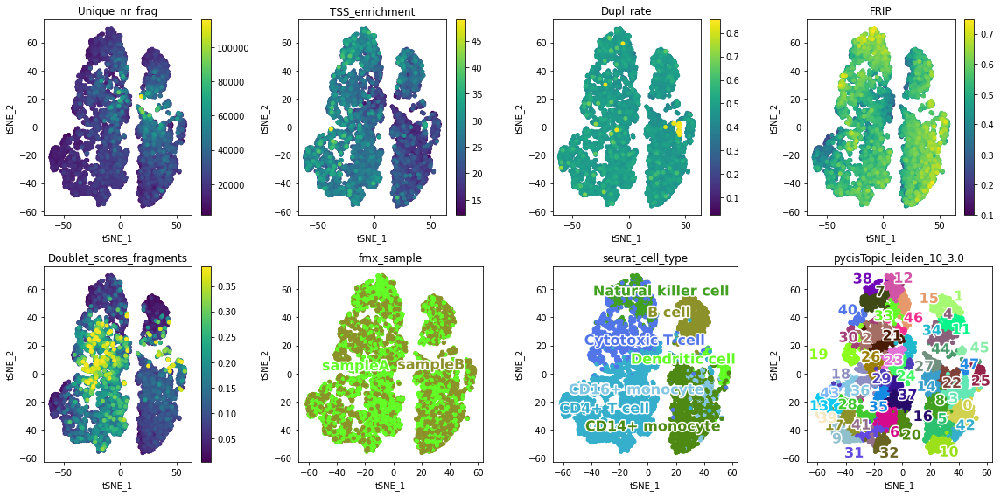

MDC_mtscatac_2.FULL
	cistopic_objects/MDC_mtscatac_2.FULL__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.pkl exists, skipping


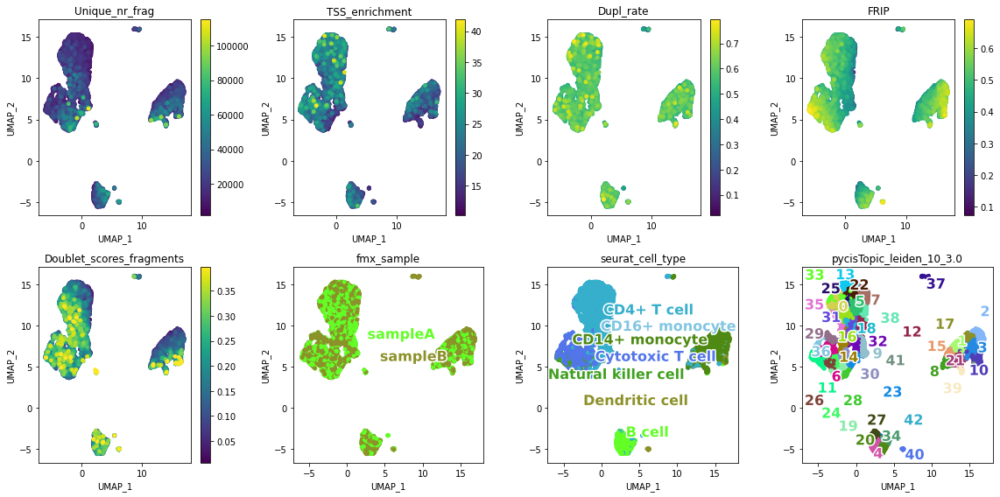

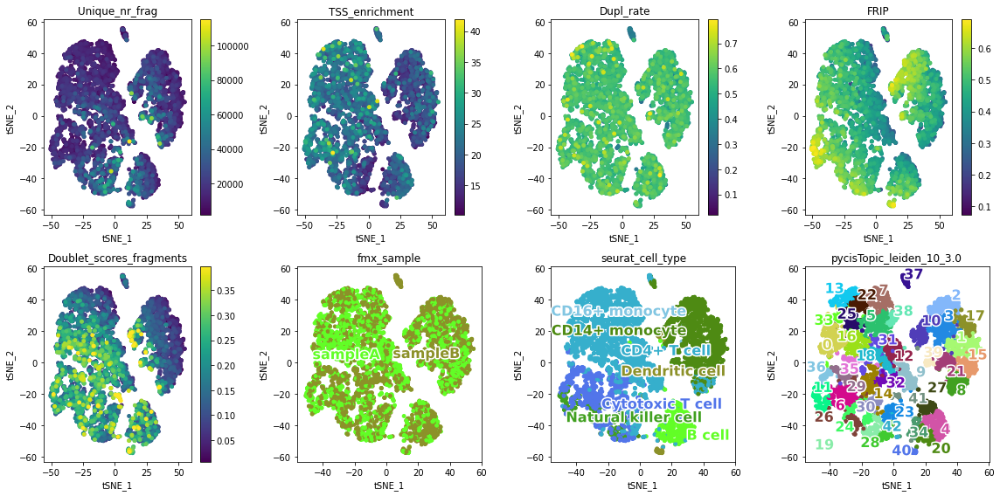

OHS_s3atac_1.FULL
	cistopic_objects/OHS_s3atac_1.FULL__cto.scrublet0-4.fmx.singlets.model_13topics.dimreduc.pkl exists, skipping


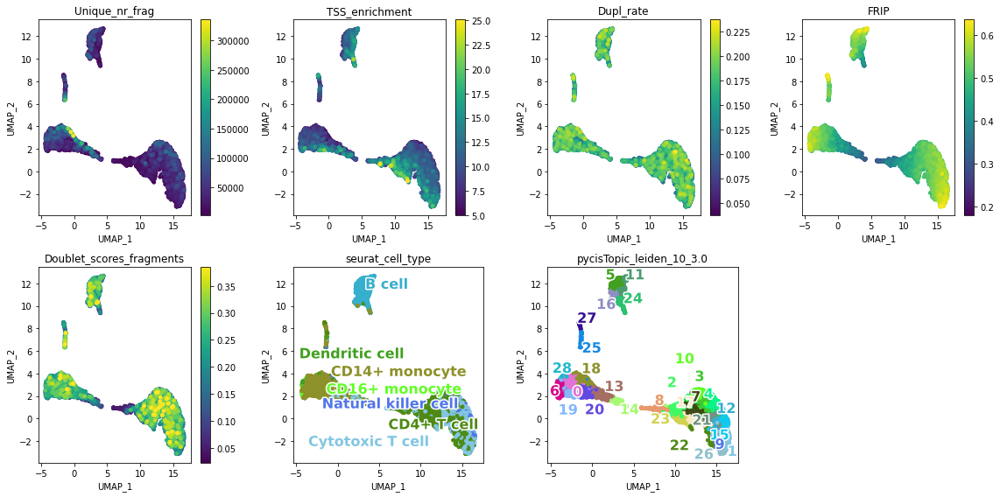

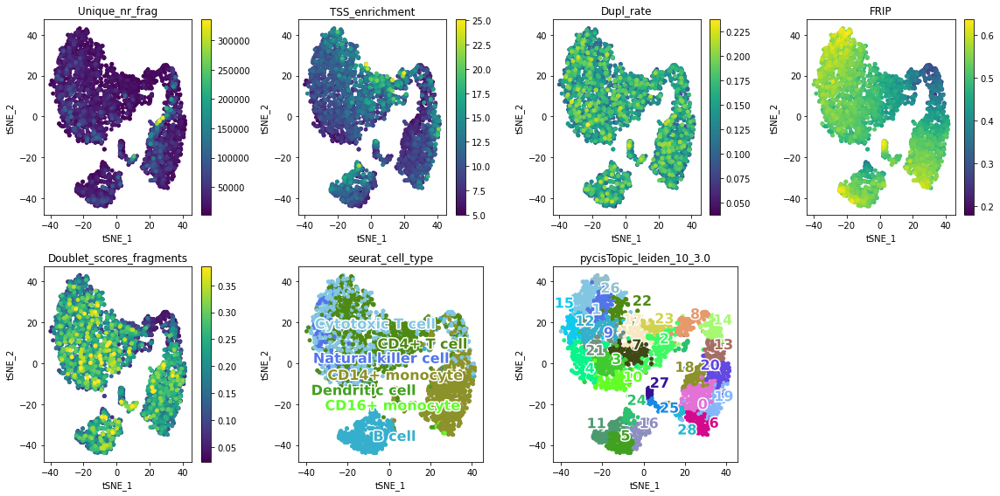

OHS_s3atac_2.FULL
	cistopic_objects/OHS_s3atac_2.FULL__cto.scrublet0-4.fmx.singlets.model_7topics.dimreduc.pkl exists, skipping


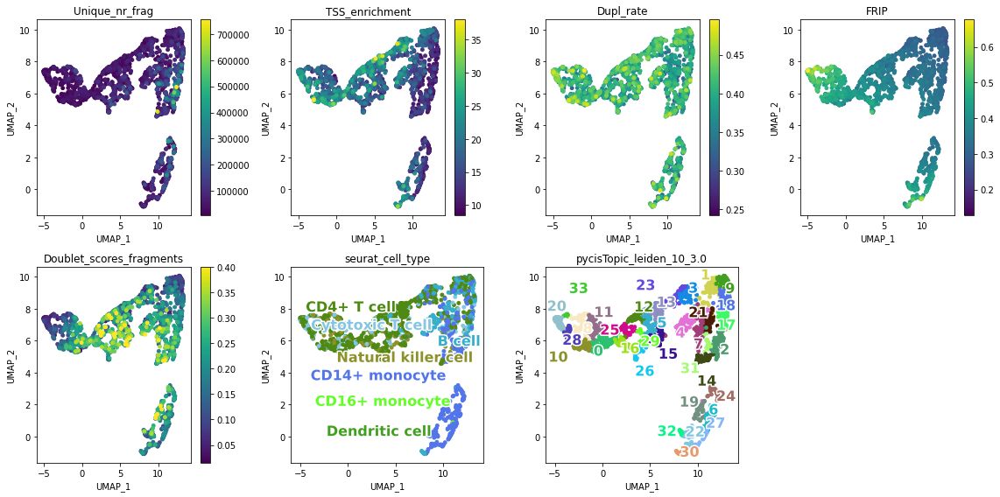

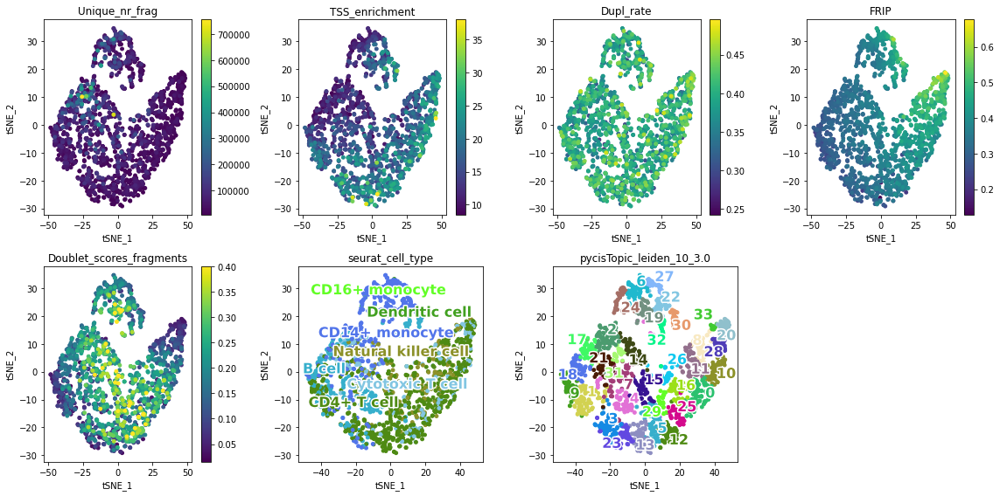

SAN_10xmultiome_1.FULL
	cistopic_objects/SAN_10xmultiome_1.FULL__cto.scrublet0-4.fmx.singlets.model_12topics.dimreduc.pkl exists, skipping


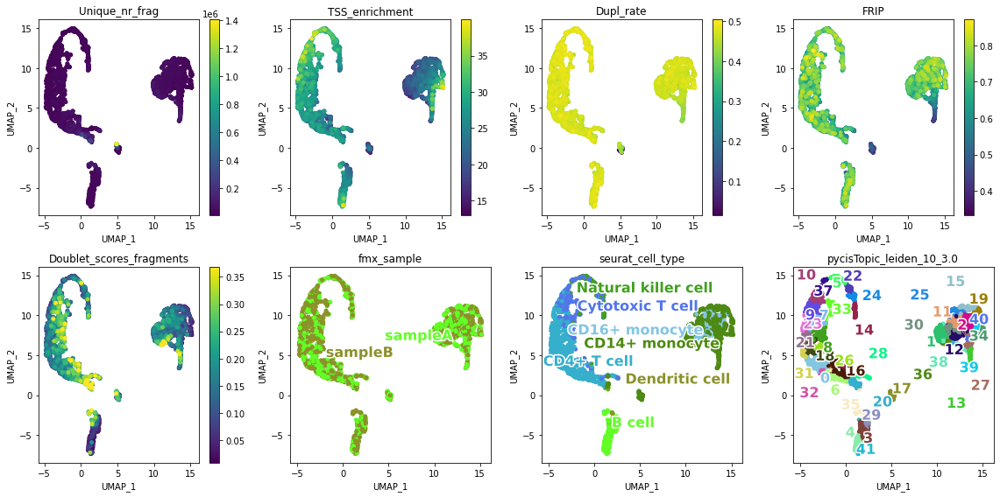

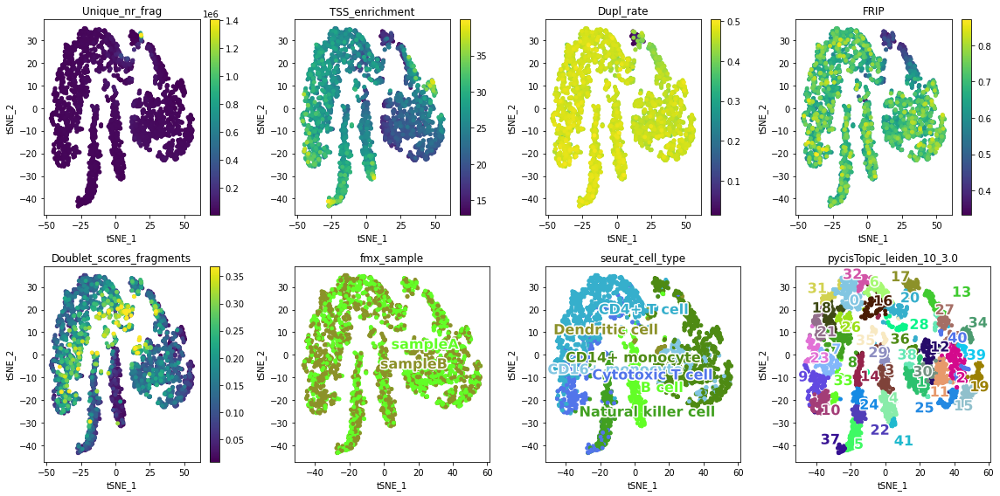

SAN_10xmultiome_2.FULL
	cistopic_objects/SAN_10xmultiome_2.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.pkl exists, skipping


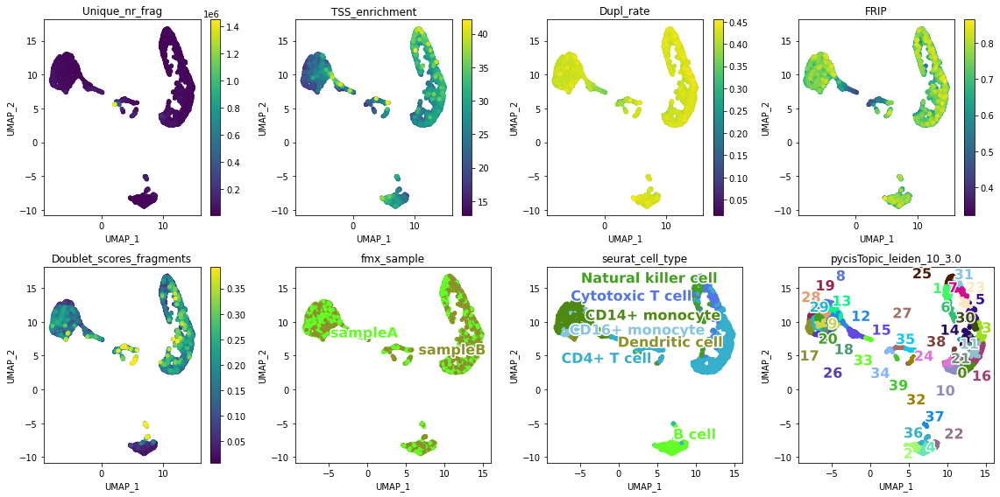

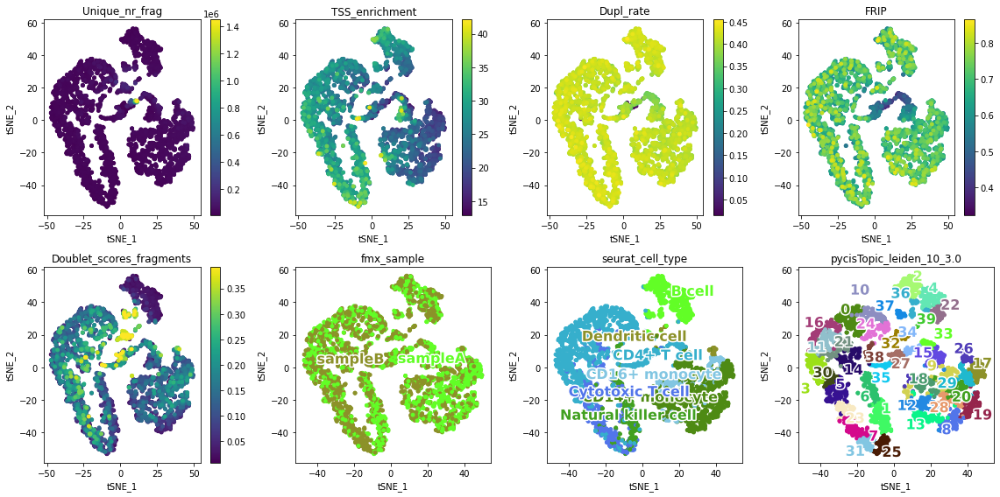

STA_10xv11_1.FULL
	cistopic_objects/STA_10xv11_1.FULL__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.pkl exists, skipping


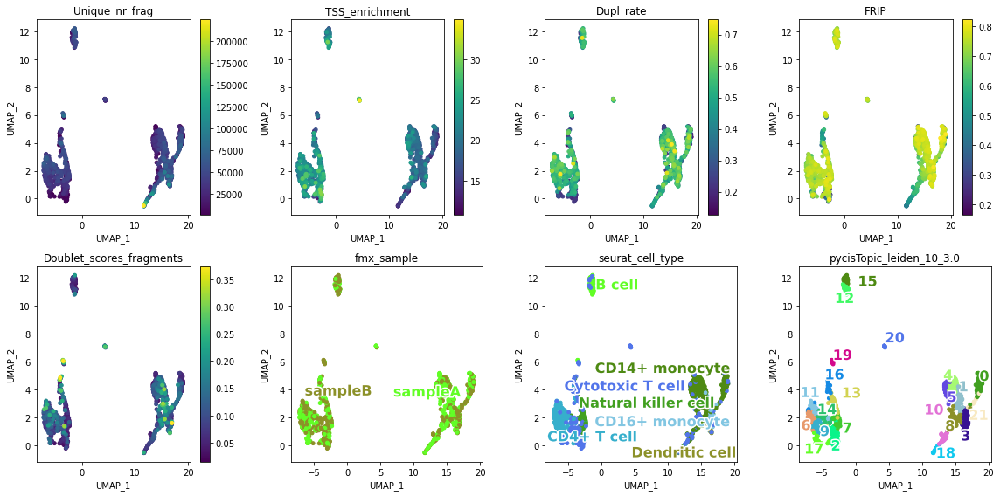

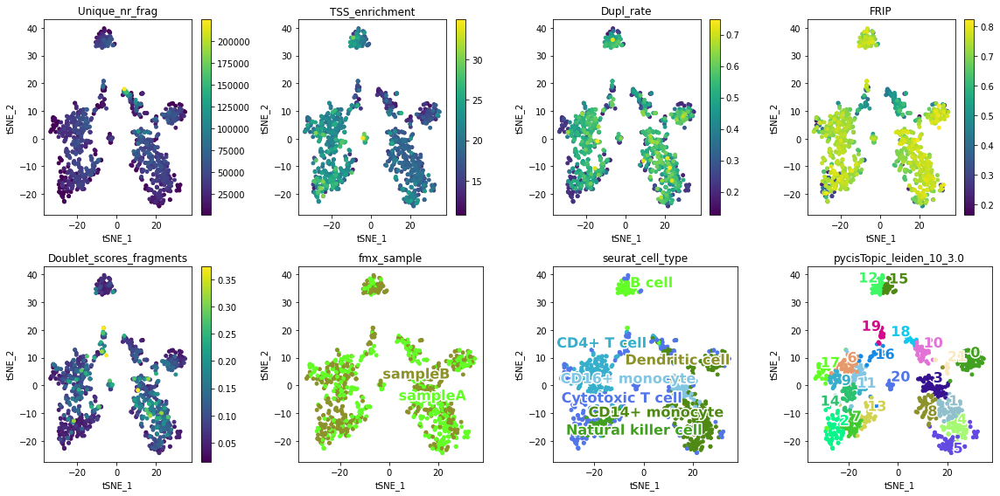

STA_10xv11_2.FULL
	cistopic_objects/STA_10xv11_2.FULL__cto.scrublet0-4.fmx.singlets.model_12topics.dimreduc.pkl exists, skipping


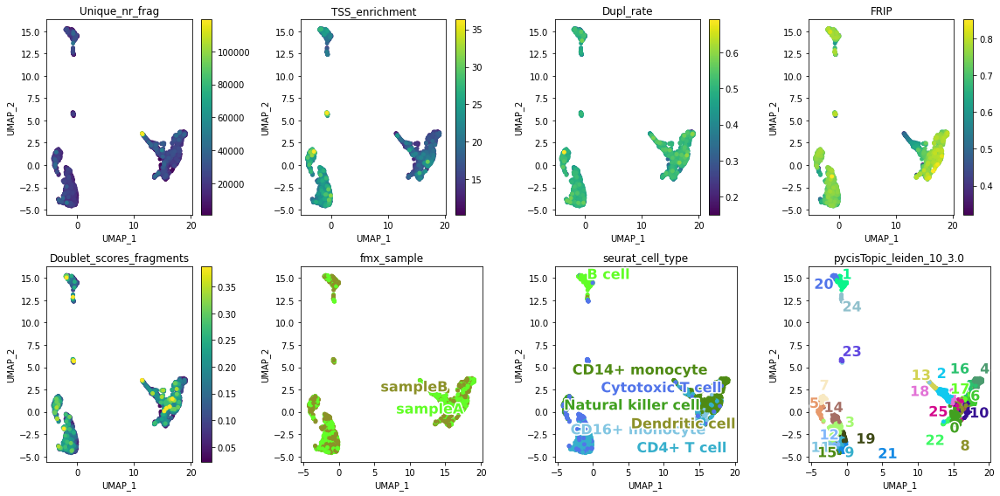

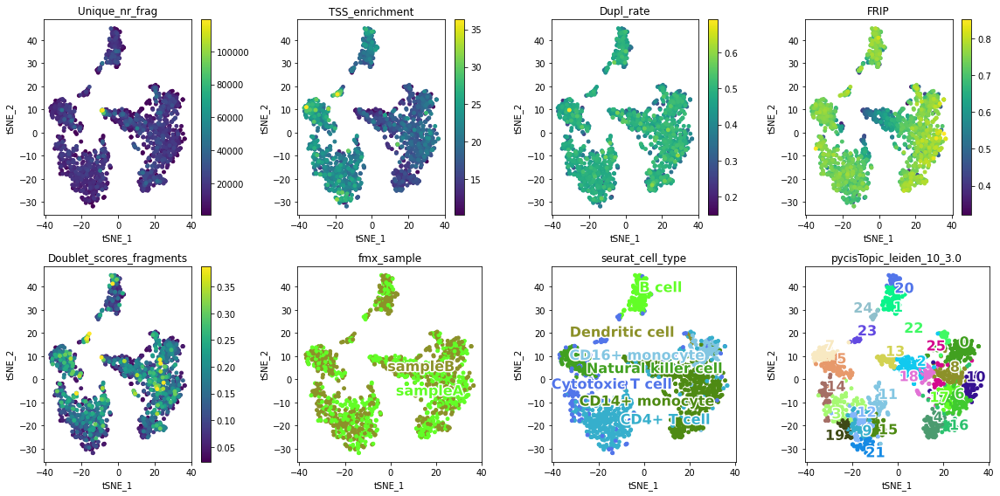

TXG_10xv11_1.FULL
	cistopic_objects/TXG_10xv11_1.FULL__cto.scrublet0-4.fmx.singlets.model_16topics.dimreduc.pkl exists, skipping


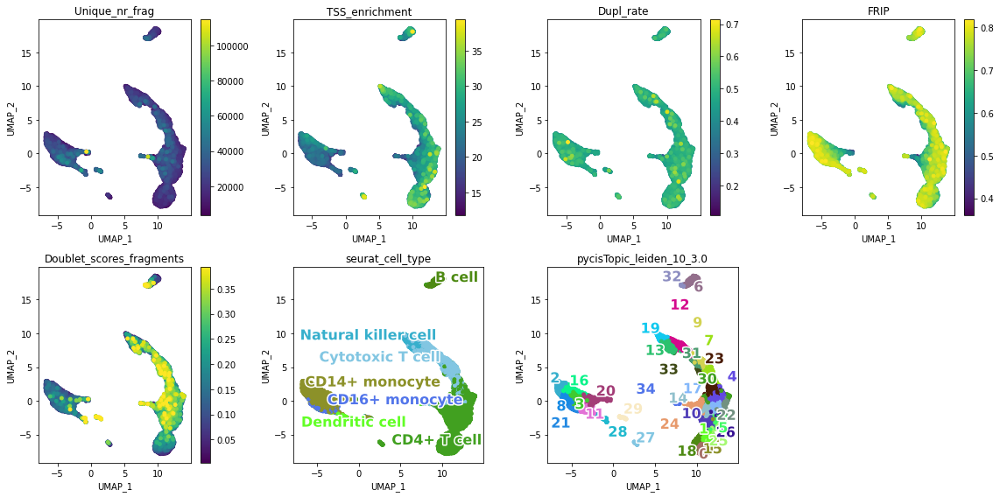

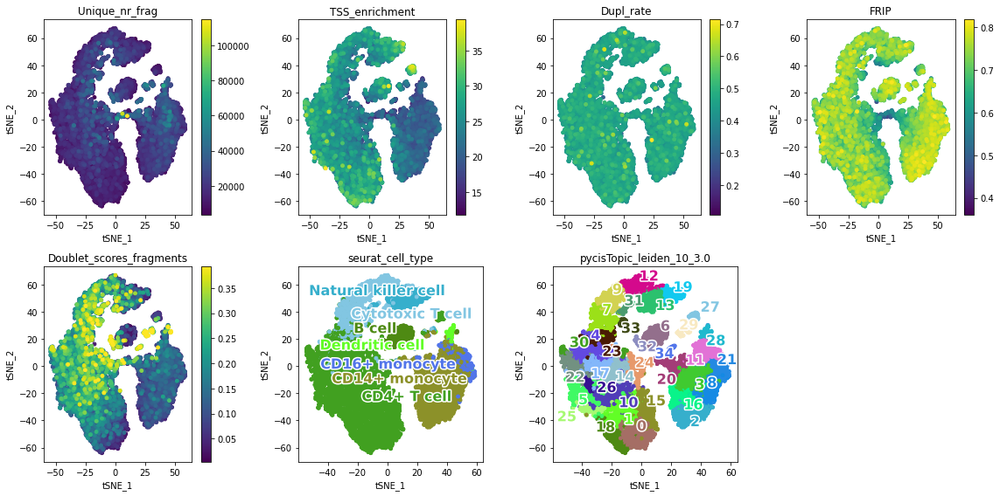

TXG_10xv2_1.FULL
	cistopic_objects/TXG_10xv2_1.FULL__cto.scrublet0-4.fmx.singlets.model_18topics.dimreduc.pkl exists, skipping


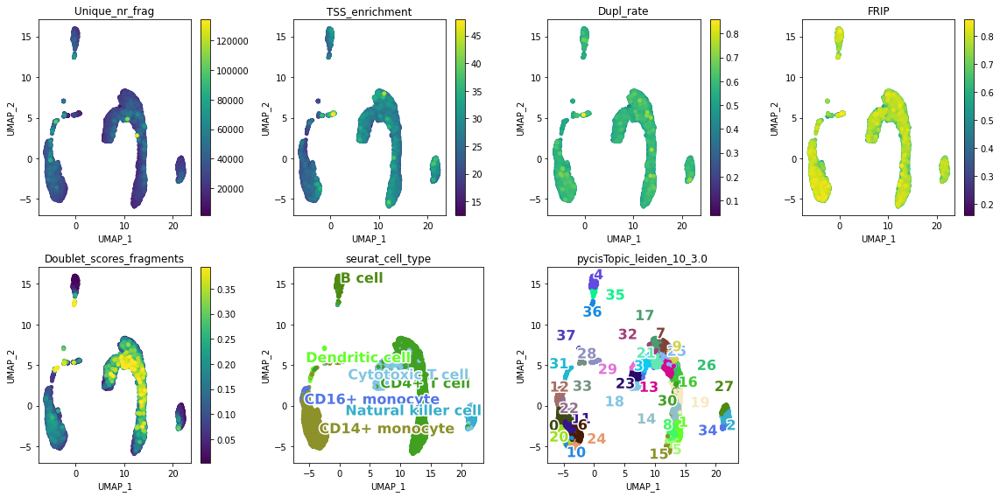

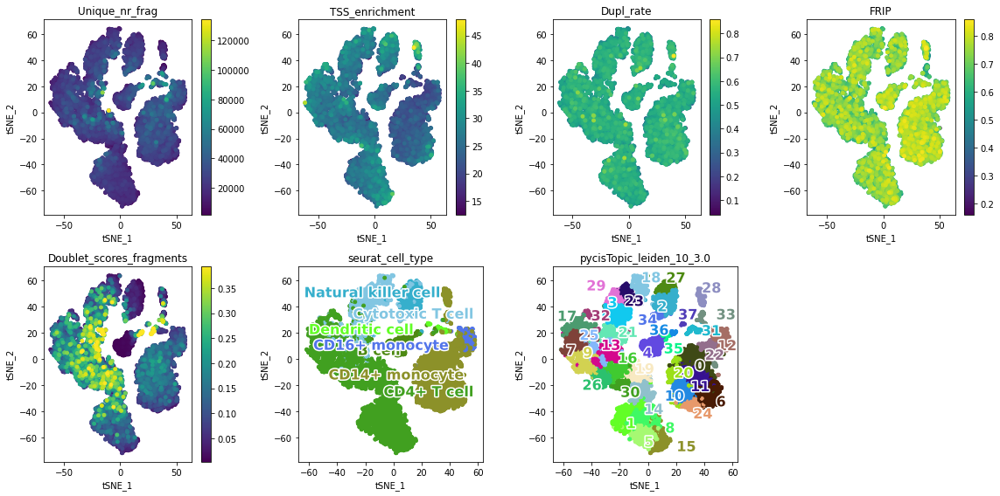

TXG_10xv2_2.FULL
	cistopic_objects/TXG_10xv2_2.FULL__cto.scrublet0-4.fmx.singlets.model_16topics.dimreduc.pkl exists, skipping


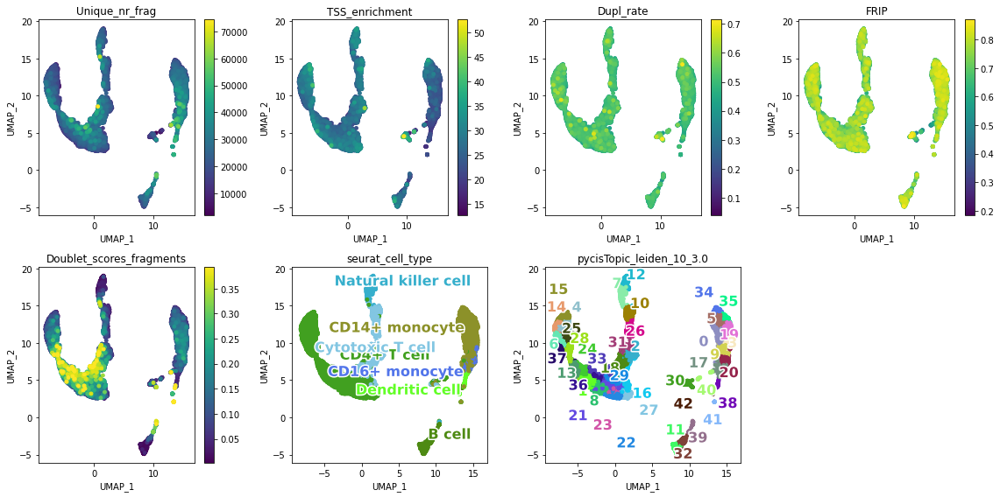

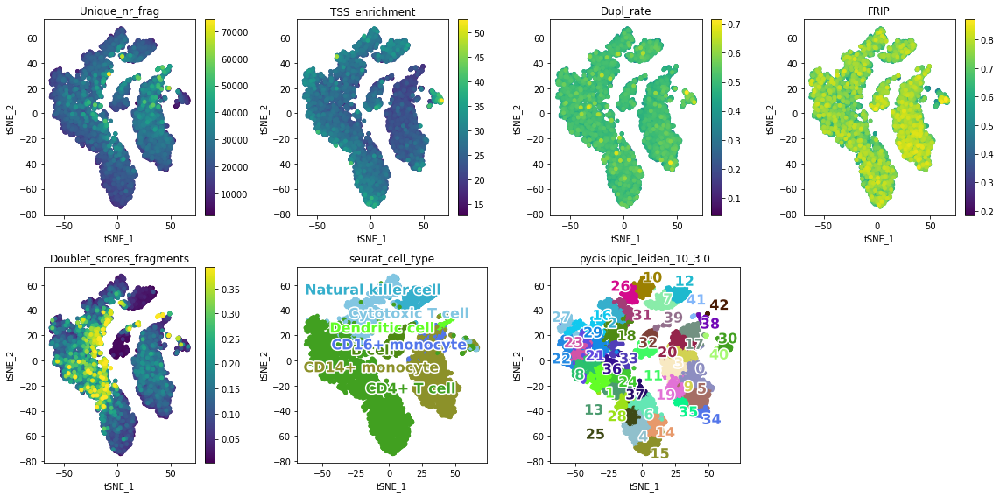

UCS_ddseq_1.FULL
	cistopic_objects/UCS_ddseq_1.FULL__cto.scrublet0-4.fmx.singlets.model_12topics.dimreduc.pkl exists, skipping


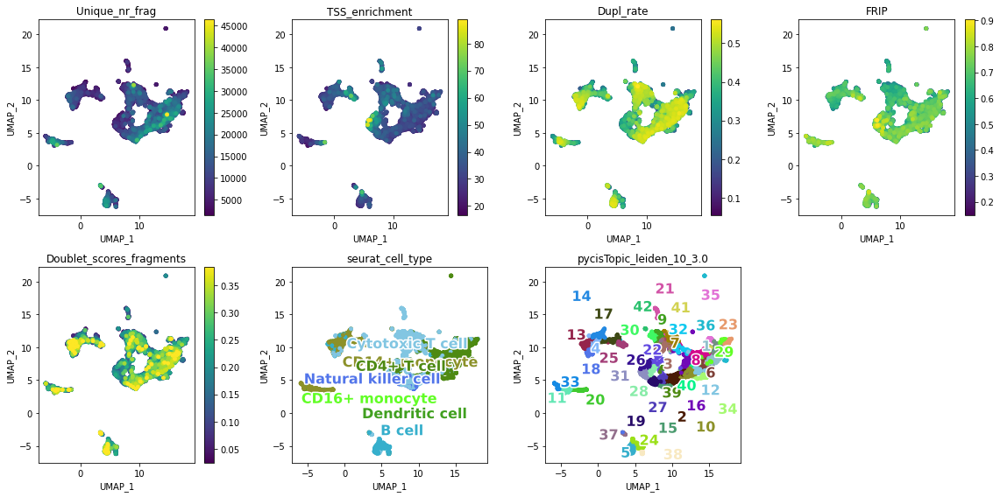

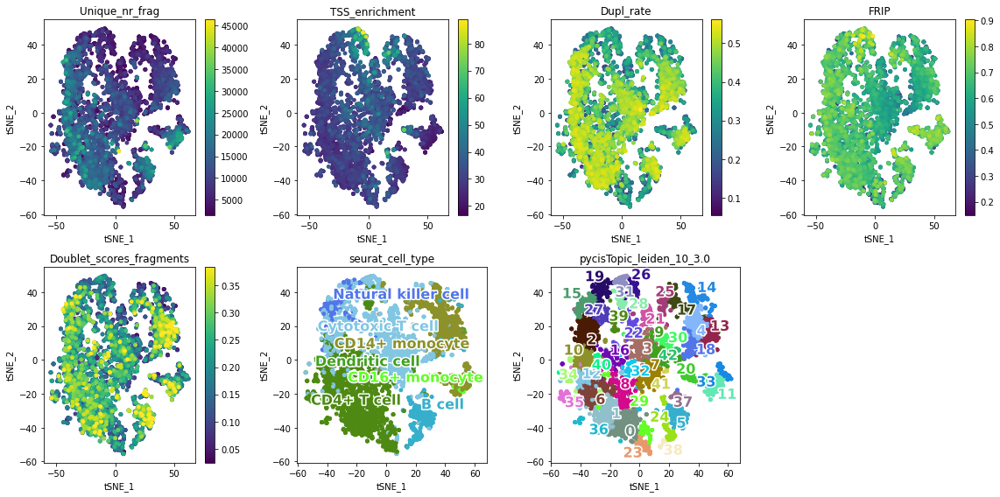

UCS_ddseq_2.FULL
	cistopic_objects/UCS_ddseq_2.FULL__cto.scrublet0-4.fmx.singlets.model_17topics.dimreduc.pkl exists, skipping


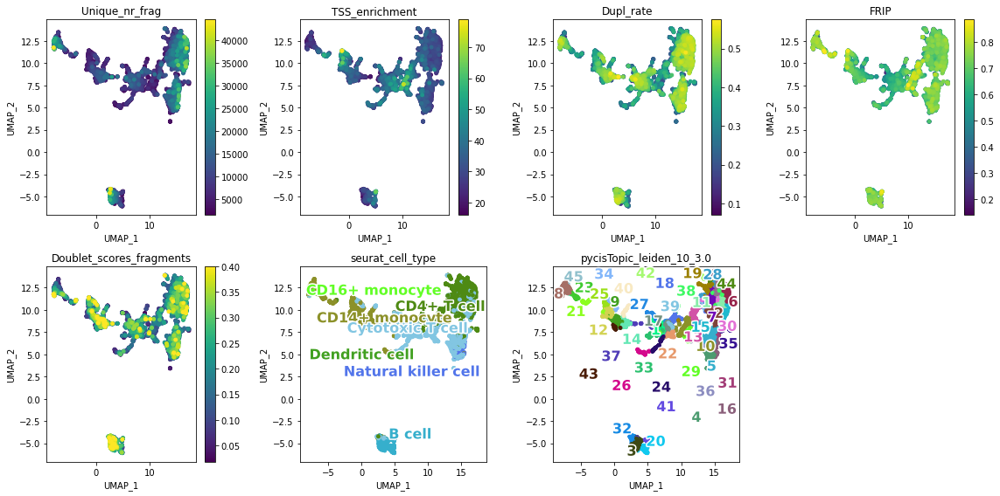

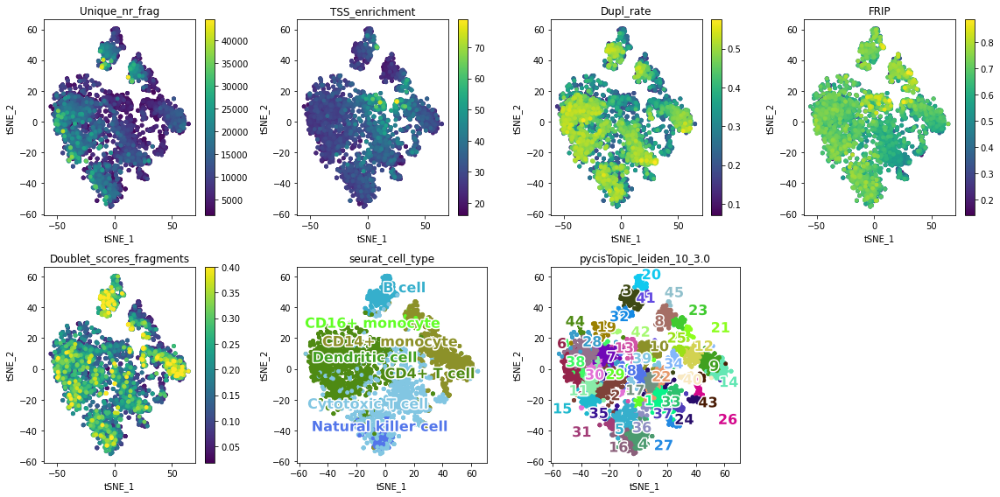

VIB_10xmultiome_1.FULL
	cistopic_objects/VIB_10xmultiome_1.FULL__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.pkl exists, skipping


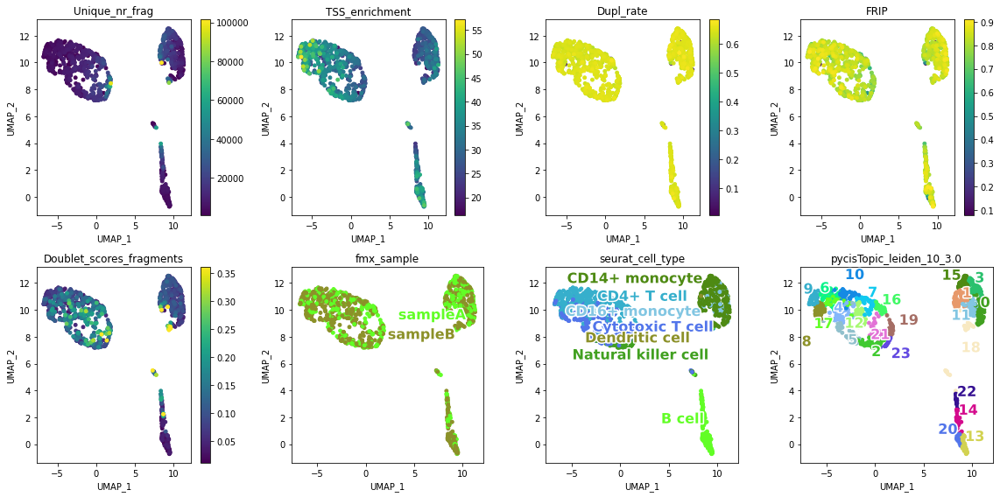

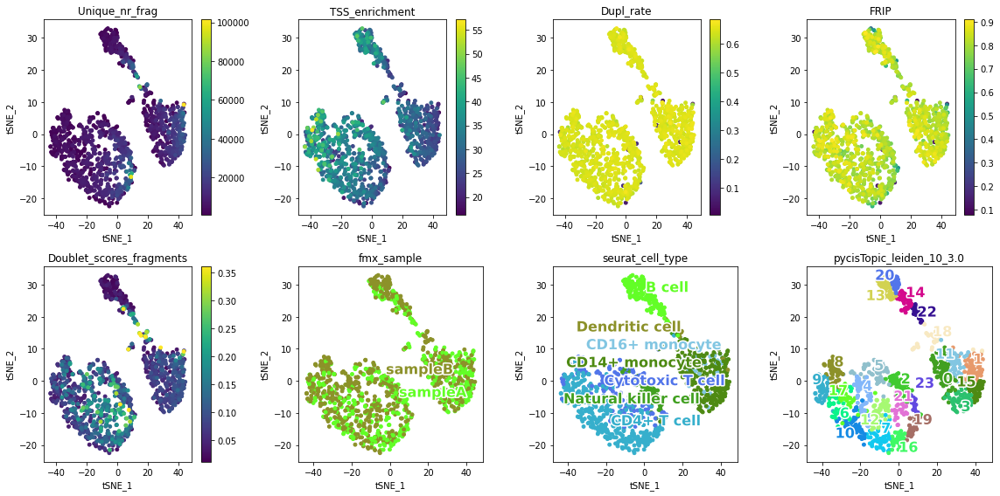

VIB_10xmultiome_2.FULL
	cistopic_objects/VIB_10xmultiome_2.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.pkl exists, skipping


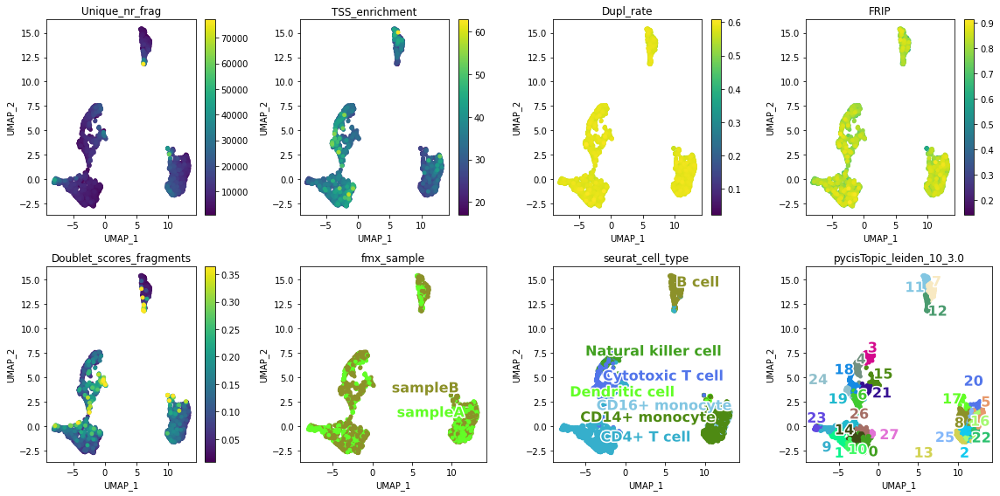

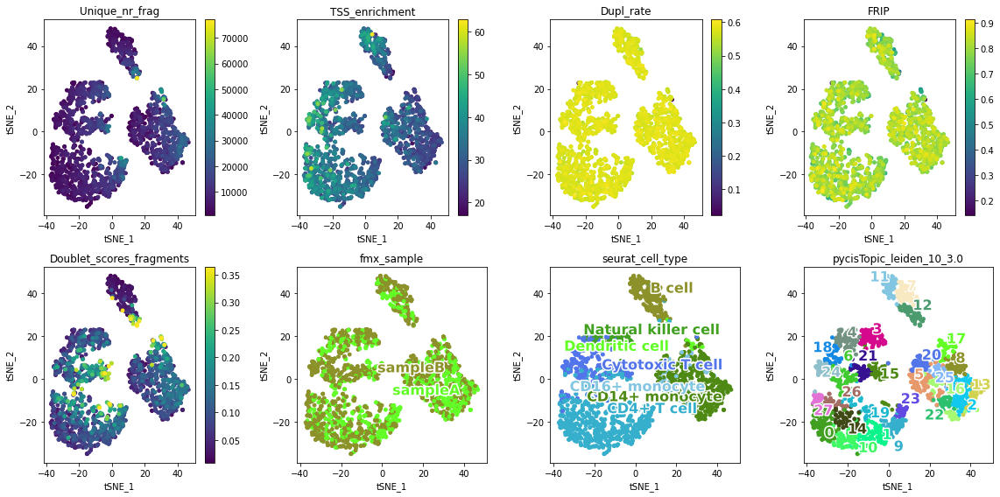

VIB_10xv1_1.FULL
	cistopic_objects/VIB_10xv1_1.FULL__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.pkl exists, skipping


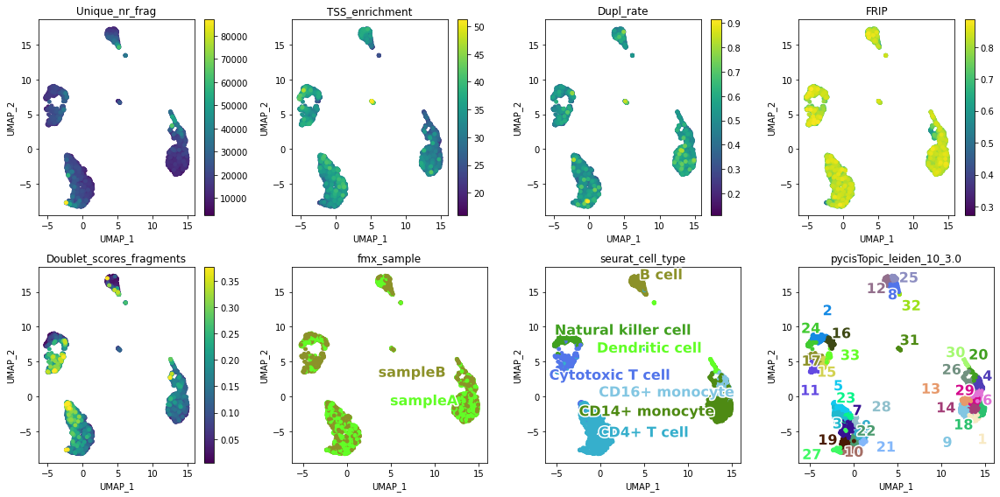

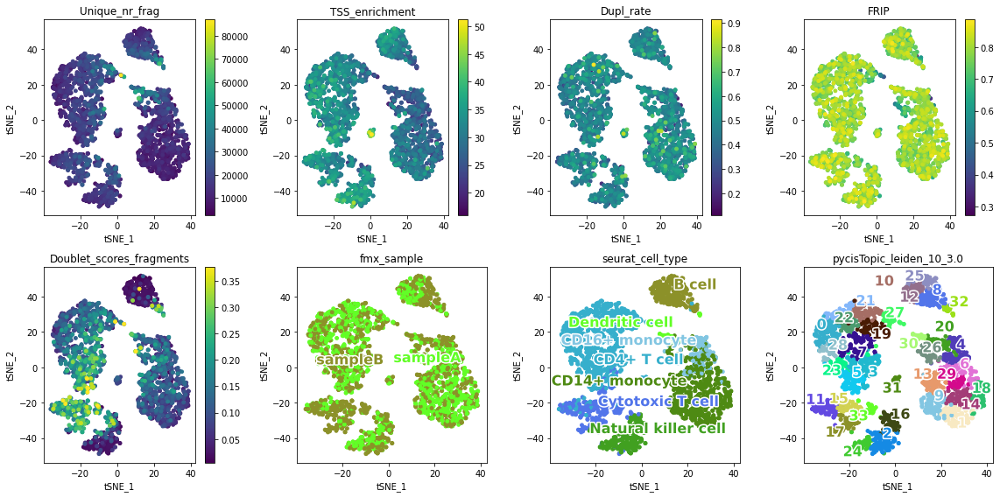

VIB_10xv1_2.FULL
	cistopic_objects/VIB_10xv1_2.FULL__cto.scrublet0-4.fmx.singlets.model_8topics.dimreduc.pkl exists, skipping


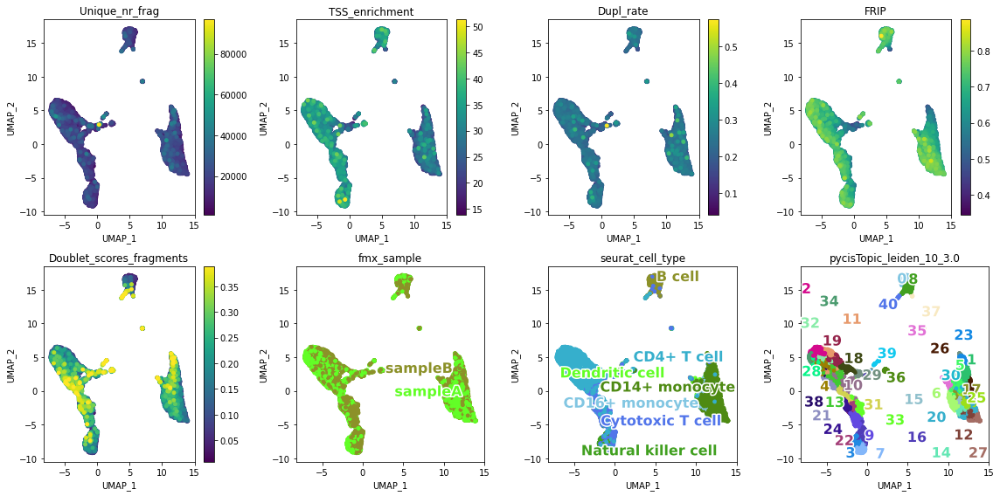

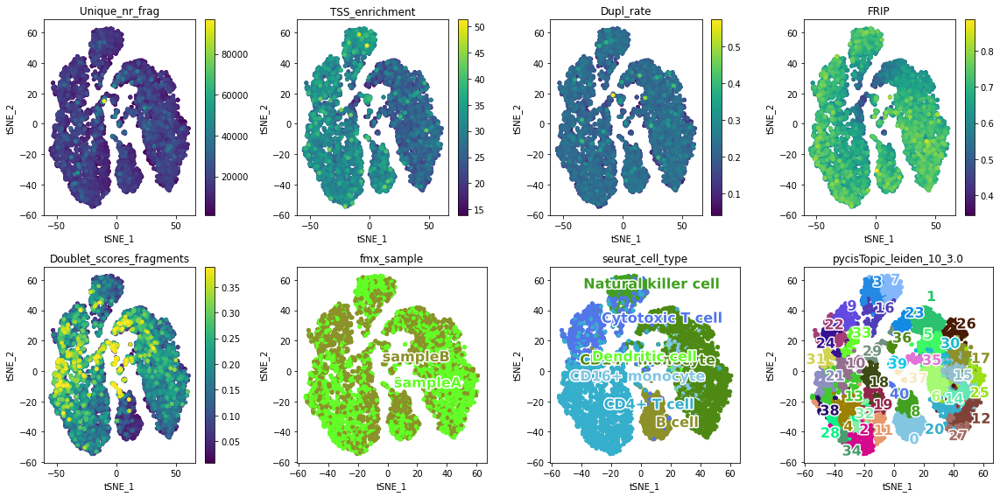

VIB_10xv2_1.FULL
	cistopic_objects/VIB_10xv2_1.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.pkl exists, skipping


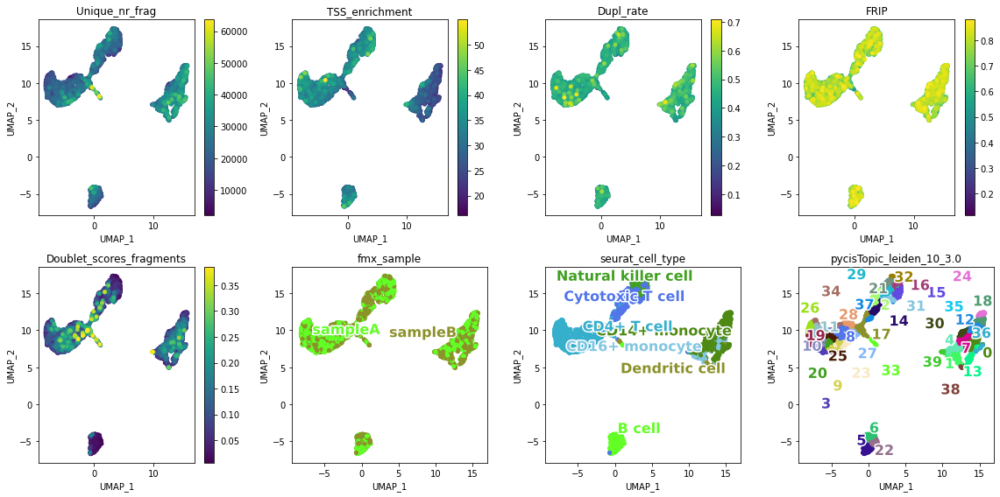

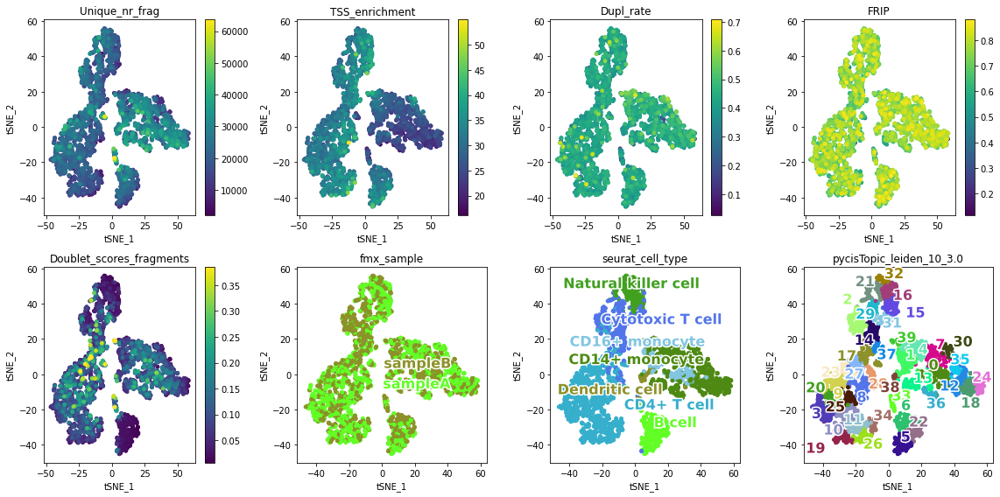

VIB_10xv2_2.FULL
	cistopic_objects/VIB_10xv2_2.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.pkl exists, skipping


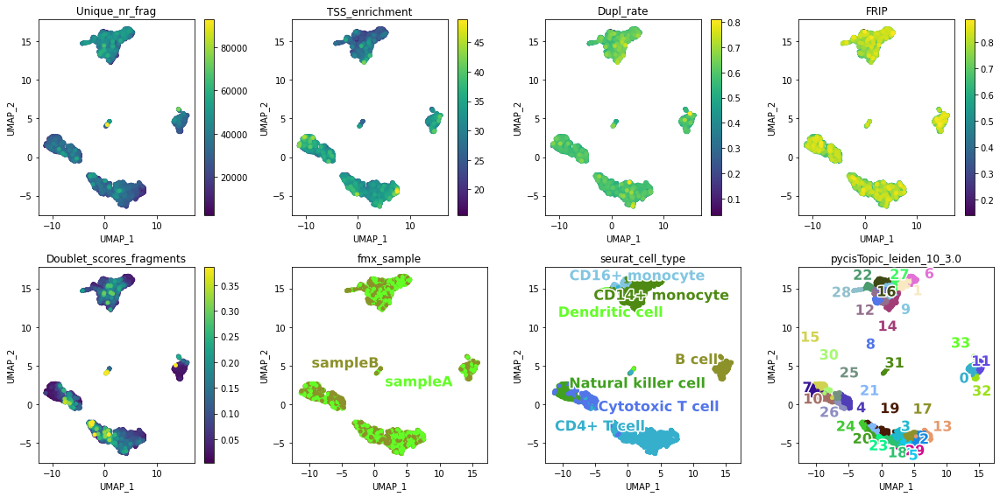

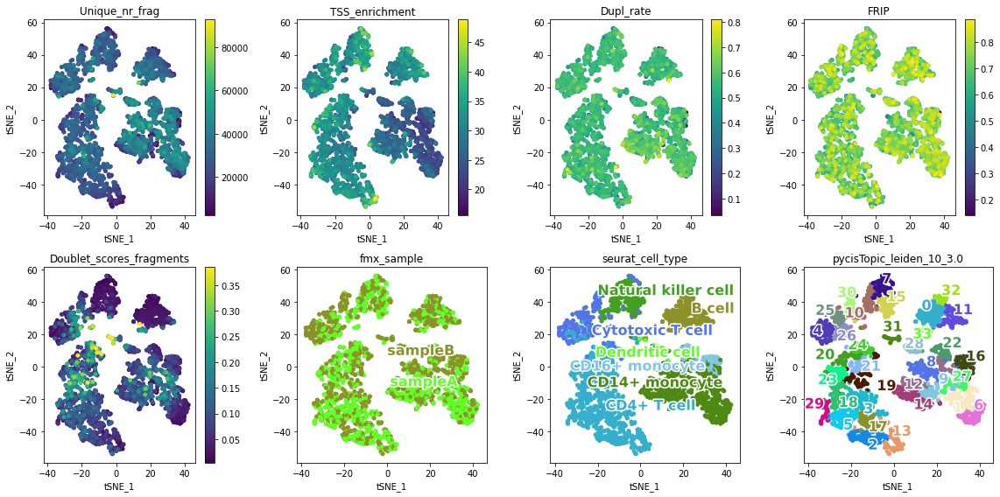

VIB_hydrop_1.FULL
	cistopic_objects/VIB_hydrop_1.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.pkl exists, skipping


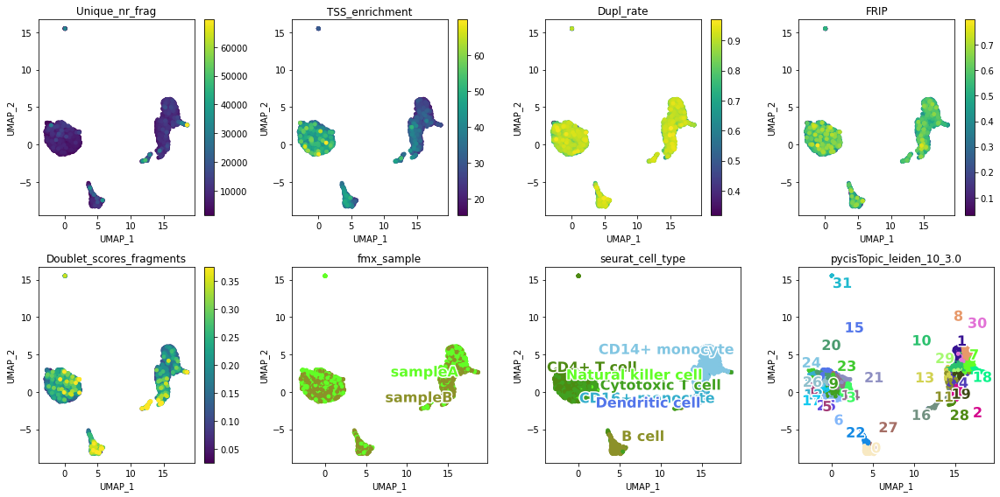

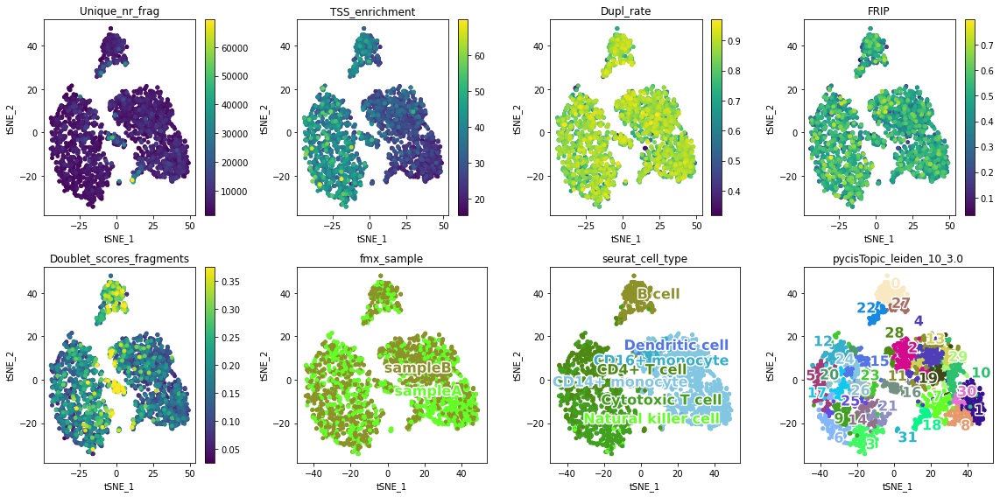

VIB_hydrop_11.FULL
	cistopic_objects/VIB_hydrop_11.FULL__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.pkl exists, skipping


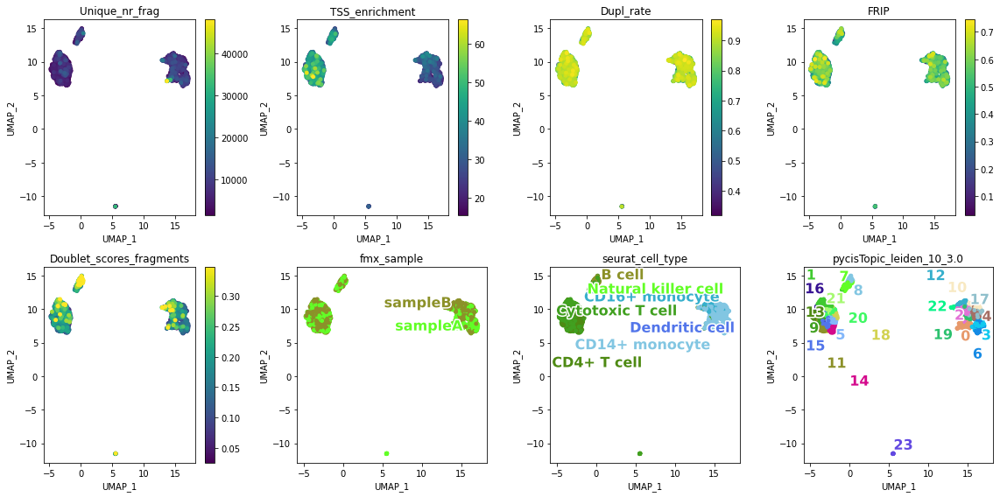

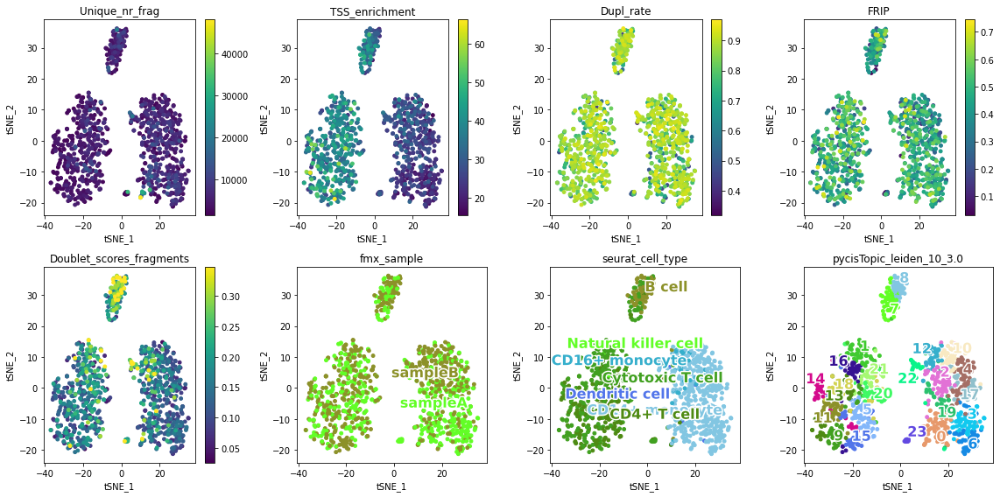

VIB_hydrop_12.FULL
	cistopic_objects/VIB_hydrop_12.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.pkl exists, skipping


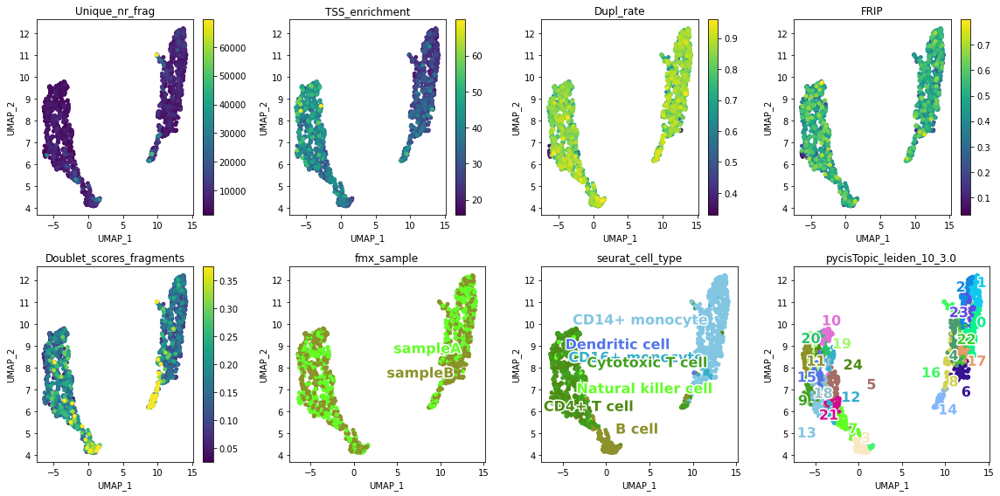

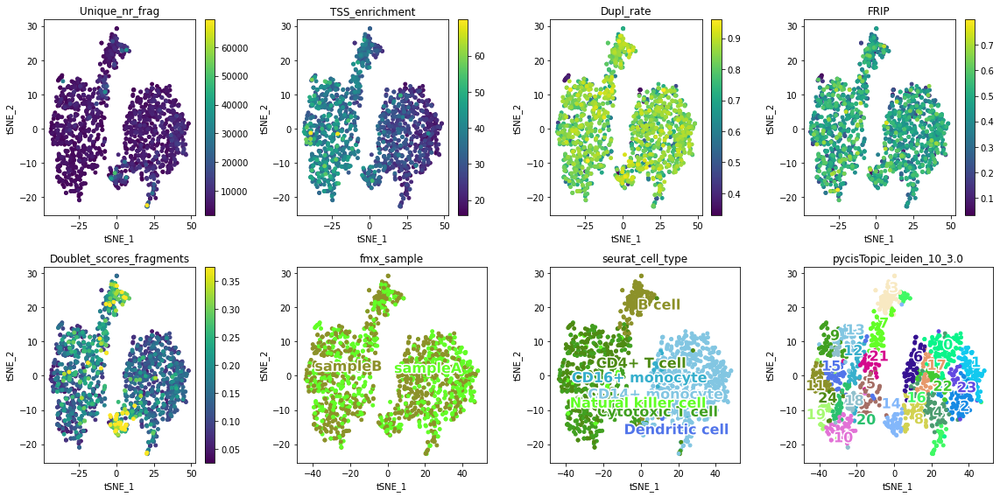

VIB_hydrop_2.FULL
	cistopic_objects/VIB_hydrop_2.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.pkl exists, skipping


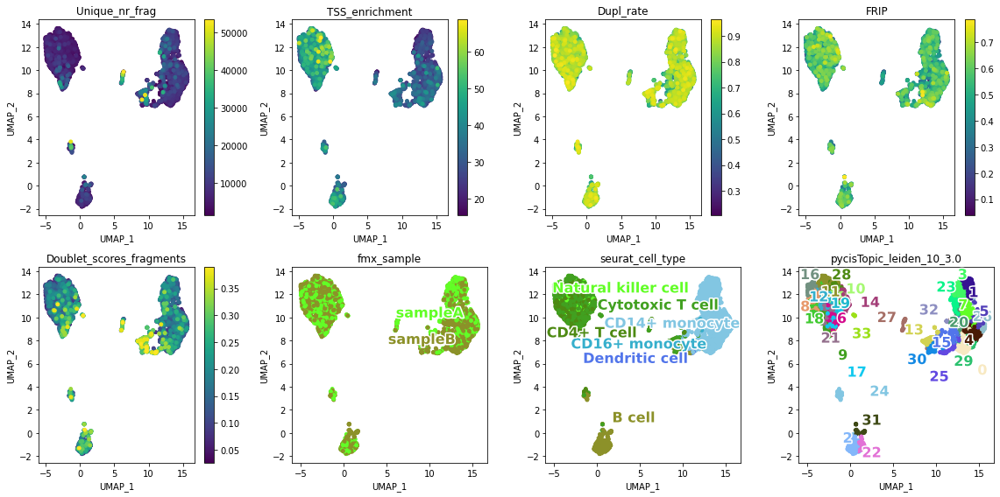

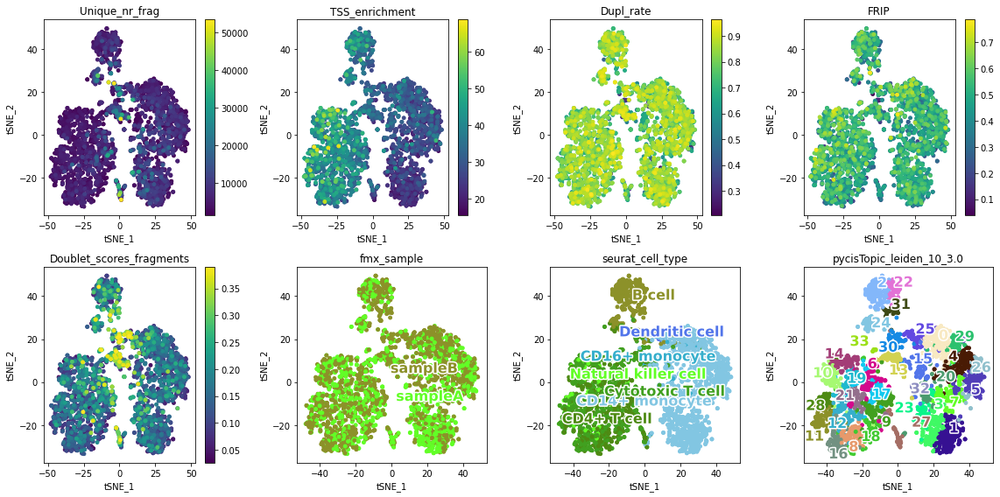

VIB_hydrop_21.FULL
	cistopic_objects/VIB_hydrop_21.FULL__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.pkl exists, skipping


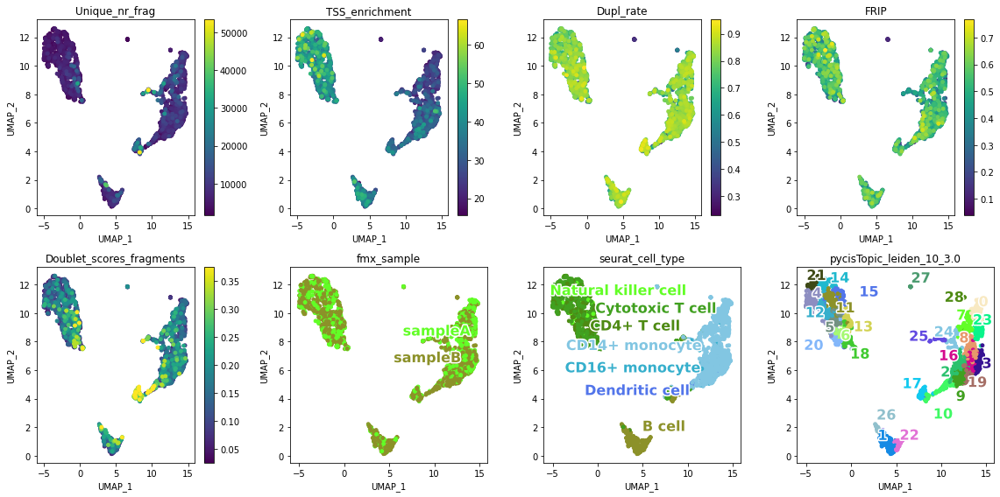

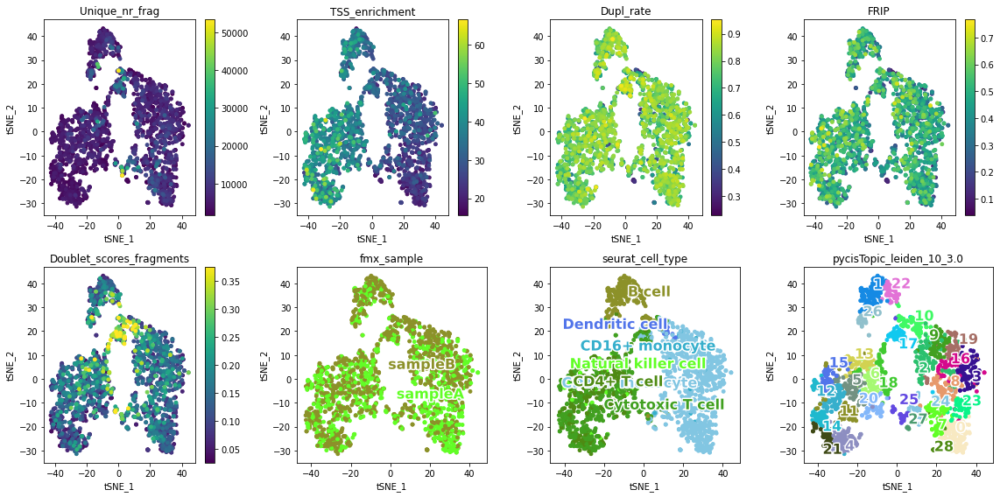

VIB_hydrop_22.FULL
	cistopic_objects/VIB_hydrop_22.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.pkl exists, skipping


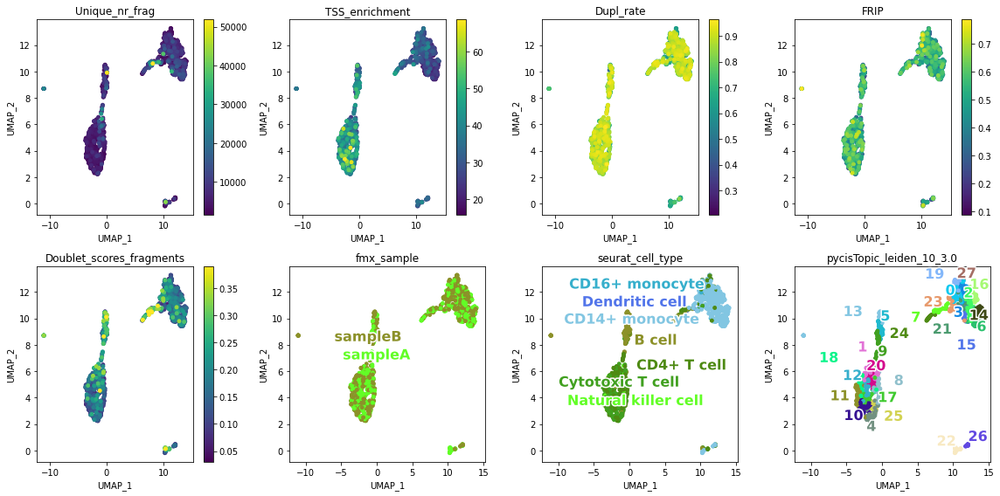

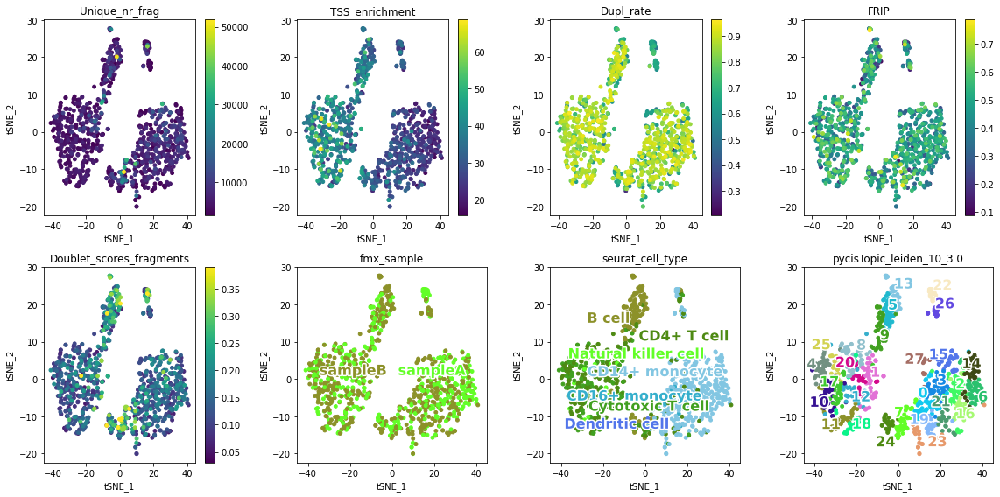

In [14]:
leiden_res = [3.0]
to_plot_leiden = ["pycisTopic_leiden_10_" + str(x) for x in leiden_res]

to_plot_vars = ['Unique_nr_frag', 'TSS_enrichment', 'Dupl_rate', 'FRIP', 'Doublet_scores_fragments', 'fmx_sample', 'seurat_cell_type']

# for sample in ['VIB_hydrop_1.FULL', 'VIB_hydrop_2.FULL']:
for sample in cto_model_path_dict.keys():
    to_plot = to_plot_vars + to_plot_leiden
    
    print(sample)
    cto_path = cto_model_path_dict[sample]
    cto_path_new = cto_path.replace('.pkl', '.dimreduc.pkl')
    
    if not sample in prediction_path_dict.keys():
        print(f'\tPredictions do not exist for {sample}! Skipping')
        
    else:
        predictions_path = prediction_path_dict[sample]

        if not os.path.exists(cto_path_new):
            with open(cto_path, 'rb') as f:
                cto = pickle.load(f)
                
            ct_pred = pd.read_csv(predictions_path,sep='\t')

            # format to add to cistopic object:
            ct_annot = ct_pred[['composite_sample_id','cell_type','cell_type_pred_score']].copy().set_index('composite_sample_id')
            ct_annot.columns = ['seurat_cell_type','seurat_cell_type_pred_score']
            ct_annot.index = [x.replace('-', '___') for x in ct_annot.index]
            index_old = cto.cell_data.index

            if sample.split('.')[0] in ['VIB_hydrop_1', 'VIB_hydrop_2']:
            #     ct_annot.index = [x.split('___')[0] + '___' + x.split('___')[2].split('.')[0] + x.split('___')[1] + '.' + x.split('___')[2].split('.')[-1] for x in ct_annot.index]
                cto.cell_data.index = [x.replace('-1','').replace('-2','') for x in cto.cell_data.index]
                
            cto.add_cell_data(ct_annot)
            cto.cell_data.index = index_old

            cto.projections['cell'] = {}
            find_clusters(cto,
                      target  = 'cell',
                      k = 10,
                      res = leiden_res,
                      prefix = 'pycisTopic_')
            run_umap(cto, target = 'cell')
            run_tsne(cto, target = 'cell')
            
            if not "fmx_sample" in cto.cell_data.columns:
                to_plot.remove('fmx_sample')
                
            n_to_plot = len(to_plot)
            n_cols = 4
            n_rows = math.ceil(n_to_plot/n_cols)
            
            plot_metadata(cto,
            reduction_name='UMAP',
            variables=to_plot,
            target='cell',
            num_columns=4,
            text_size=16,
            dot_size=15,
            figsize=(n_cols*4,n_rows*4),
            save=f"plots_qc/{sample}__umap_summary.png"
            )

            plot_metadata(cto,
            reduction_name='tSNE',
            variables=to_plot,
            target='cell',
            num_columns=4,
            text_size=16,
            dot_size=15,
            figsize=(n_cols*4,n_rows*4),
            save=f"plots_qc/{sample}__tsne_summary.png"
            )
            
            with open(cto_path_new, "wb") as f:
                pickle.dump(cto, f, protocol=4)
                
        else:
            print(f"\t{cto_path_new} exists, skipping")
            
            umap_path = f"plots_qc/{sample}__umap_summary.png"
            tsne_path = f"plots_qc/{sample}__tsne_summary.png"
            
            if os.path.exists(umap_path):
                display(Image(umap_path))
                
            else:
                with open(cto_path_new, 'rb') as f:
                    cto = pickle.load(f)

                if not "fmx_sample" in cto.cell_data.columns:
                    to_plot.remove('fmx_sample')

                n_to_plot = len(to_plot)
                n_cols = 4
                n_rows = math.ceil(n_to_plot/n_cols)

                plot_metadata(cto,
                reduction_name='UMAP',
                variables=to_plot,
                target='cell',
                num_columns=4,
                text_size=16,
                dot_size=15,
                figsize=(n_cols*4,n_rows*4),
                save=f"plots_qc/{sample}__umap_summary.png"
                )
                
            if os.path.exists(tsne_path):
                display(Image(tsne_path))
                
            else:
                with open(cto_path_new, 'rb') as f:
                    cto = pickle.load(f)
                    
                n_to_plot = len(to_plot)
                n_cols = 4
                n_rows = math.ceil(n_to_plot/n_cols)
                
                plot_metadata(cto,
                reduction_name='tSNE',
                variables=to_plot,
                target='cell',
                num_columns=4,
                text_size=16,
                dot_size=15,
                figsize=(n_cols*4,n_rows*4),
                save=f"plots_qc/{sample}__tsne_summary.png"
                )

# derive consensus clusters

In [15]:
cto_model_path_dict = {x.split('/')[-1].split(f'__')[0]: x for x in sorted(glob.glob("cistopic_objects/*singlets.model*dimreduc.pkl"))}
cto_model_path_dict

{'BIO_ddseq_1.FULL': 'cistopic_objects/BIO_ddseq_1.FULL__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.pkl',
 'BIO_ddseq_2.FULL': 'cistopic_objects/BIO_ddseq_2.FULL__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.pkl',
 'BIO_ddseq_3.FULL': 'cistopic_objects/BIO_ddseq_3.FULL__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.pkl',
 'BIO_ddseq_4.FULL': 'cistopic_objects/BIO_ddseq_4.FULL__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.pkl',
 'BRO_mtscatac_1.FULL': 'cistopic_objects/BRO_mtscatac_1.FULL__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.pkl',
 'BRO_mtscatac_2.FULL': 'cistopic_objects/BRO_mtscatac_2.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.pkl',
 'CNA_10xmultiome_1.FULL': 'cistopic_objects/CNA_10xmultiome_1.FULL__cto.scrublet0-4.fmx.singlets.model_12topics.dimreduc.pkl',
 'CNA_10xmultiome_2.FULL': 'cistopic_objects/CNA_10xmultiome_2.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.pkl',
 'CNA_10xv11_1.FULL': 'cistopic_object

cell_types = list(celldata['seurat_cell_type'].unique())
palette = list(sns.color_palette('husl',len(cell_types)))
palette = list(sns.color_palette('Set2'))

color_palette = {cell_type: palette[cell_types.index(cell_type)] for cell_type in cell_types}

pprint.pprint(color_palette)

In [16]:
color_palette = {
    'B cell': (0.5105309046900421, 0.6614299289084904, 0.1930849118538962),
    'CD14+ monocyte': (0.7757319041862729, 0.5784925270759935, 0.19475566538551875),
    'CD16+ monocyte': (0.21662978923073606, 0.6676586160122123, 0.7318695594345369),
    'CD4+ T cell': (0.20433460114757862, 0.6863857739476534, 0.5407103379425205),
    'Cytotoxic T cell': (0.9587050080494409, 0.3662259565791742, 0.9231469575614251),
    'Dendritic cell': (0.5049017849530067, 0.5909119231215284, 0.9584657252128558),
    'Natural killer cell': (0.9677975592919913, 0.44127456009157356, 0.5358103155058701)
}

In [17]:
palette_dict = {x: color_palette for x in ['seurat_cell_type', "consensus_cell_type"]}

cistopic_objects/BIO_ddseq_1.FULL__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.consensus.pkl already exists!


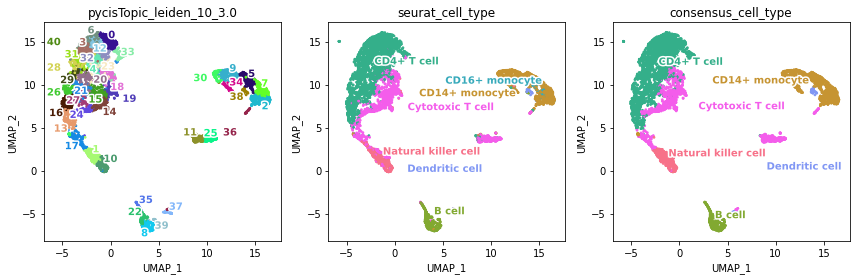

cistopic_objects/BIO_ddseq_2.FULL__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.consensus.pkl already exists!


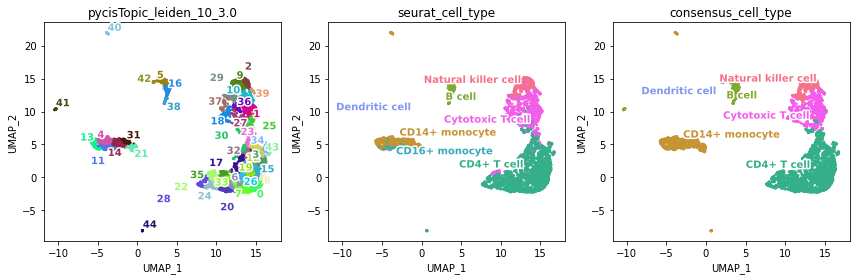

cistopic_objects/BIO_ddseq_3.FULL__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.consensus.pkl already exists!


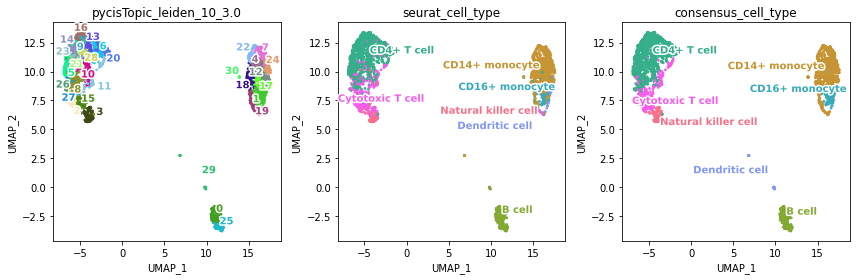

cistopic_objects/BIO_ddseq_4.FULL__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.consensus.pkl already exists!


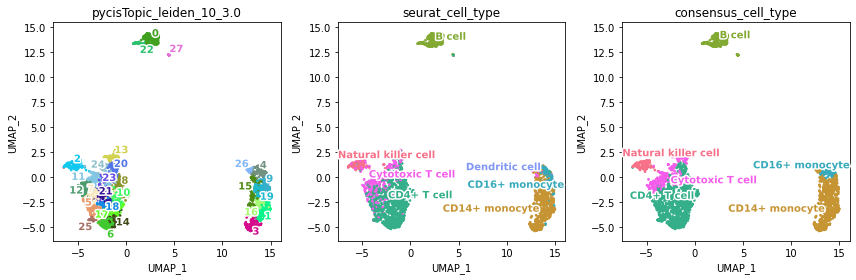

cistopic_objects/BRO_mtscatac_1.FULL__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.consensus.pkl already exists!


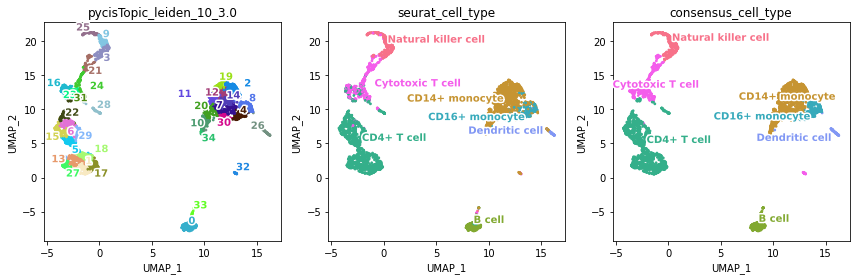

cistopic_objects/BRO_mtscatac_2.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.consensus.pkl already exists!


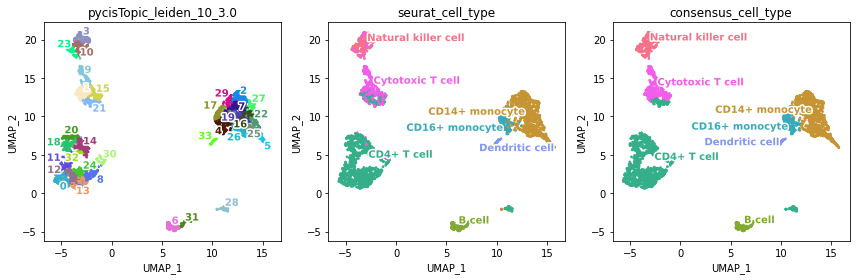

cistopic_objects/CNA_10xmultiome_1.FULL__cto.scrublet0-4.fmx.singlets.model_12topics.dimreduc.consensus.pkl already exists!


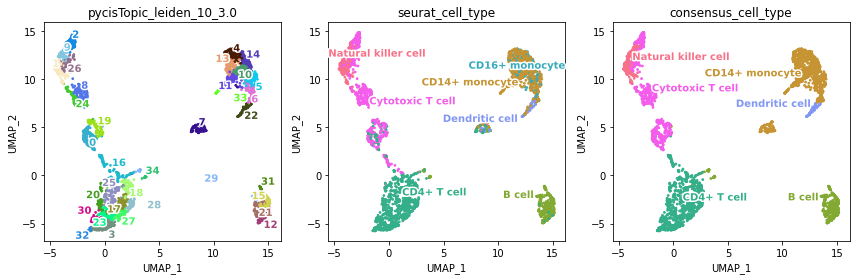

cistopic_objects/CNA_10xmultiome_2.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.consensus.pkl already exists!


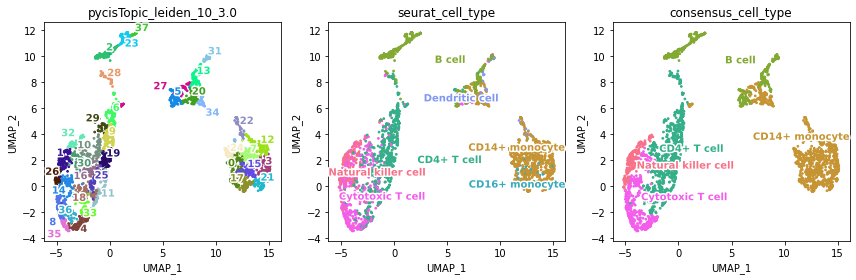

cistopic_objects/CNA_10xv11_1.FULL__cto.scrublet0-4.fmx.singlets.model_8topics.dimreduc.consensus.pkl already exists!


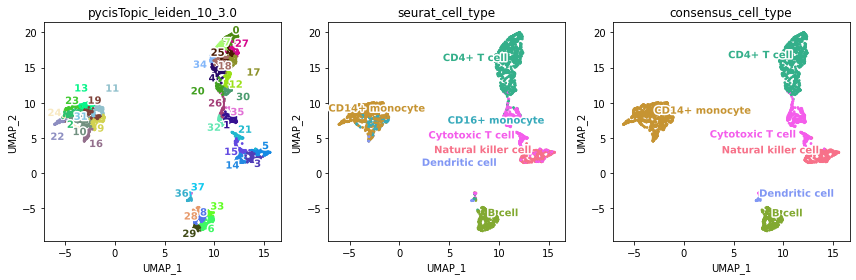

cistopic_objects/CNA_10xv11_2.FULL__cto.scrublet0-4.fmx.singlets.model_13topics.dimreduc.consensus.pkl already exists!


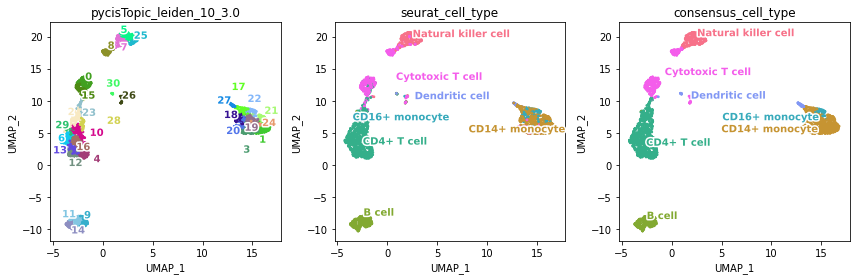

cistopic_objects/CNA_10xv11_3.FULL__cto.scrublet0-4.fmx.singlets.model_12topics.dimreduc.consensus.pkl already exists!


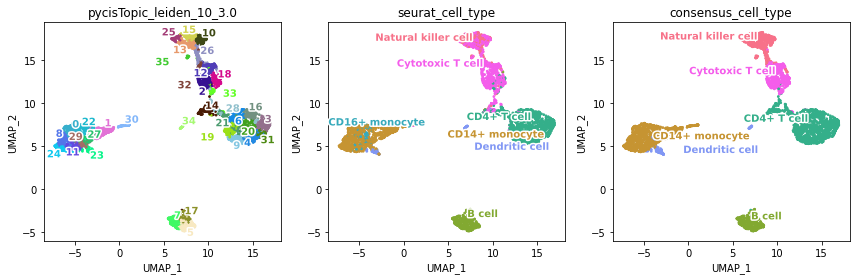

cistopic_objects/CNA_10xv11_4.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.consensus.pkl already exists!


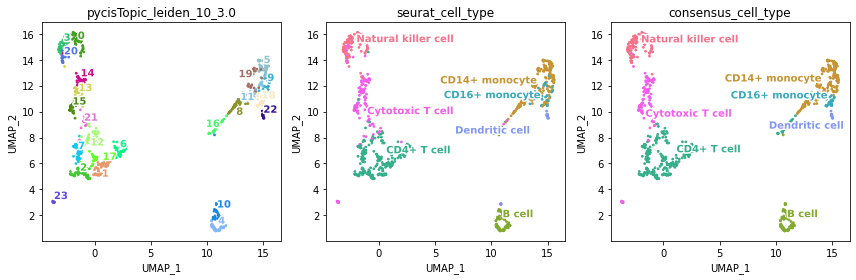

cistopic_objects/CNA_10xv11_5.FULL__cto.scrublet0-4.fmx.singlets.model_13topics.dimreduc.consensus.pkl already exists!


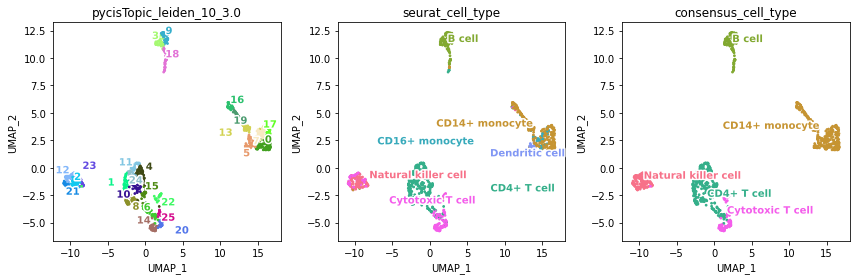

cistopic_objects/CNA_10xv2_1.FULL__cto.scrublet0-4.fmx.singlets.model_13topics.dimreduc.consensus.pkl already exists!


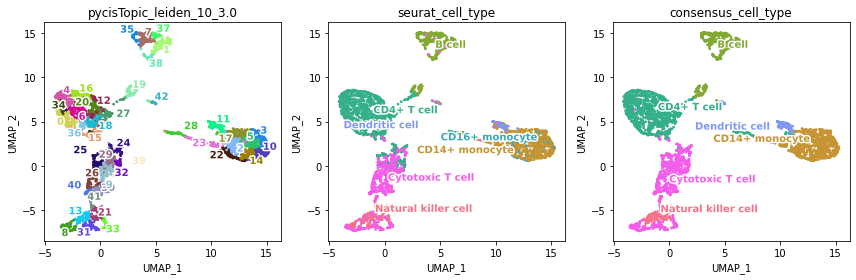

cistopic_objects/CNA_10xv2_2.FULL__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.consensus.pkl already exists!


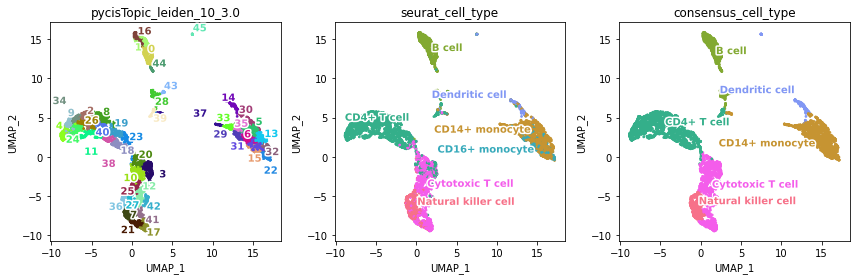

cistopic_objects/CNA_hydrop_1.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.consensus.pkl already exists!


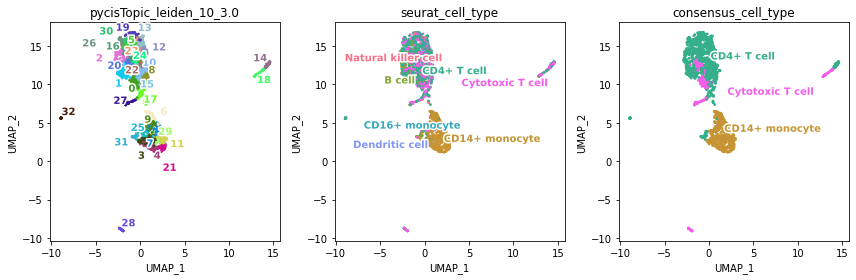

cistopic_objects/CNA_hydrop_2.FULL__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.consensus.pkl already exists!


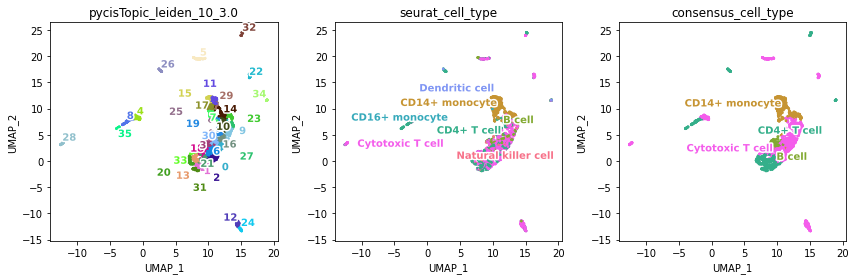

cistopic_objects/CNA_hydrop_3.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.consensus.pkl already exists!


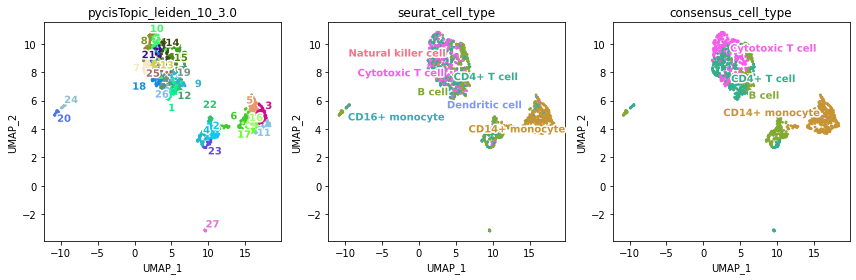

cistopic_objects/CNA_mtscatac_1.FULL__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.consensus.pkl already exists!


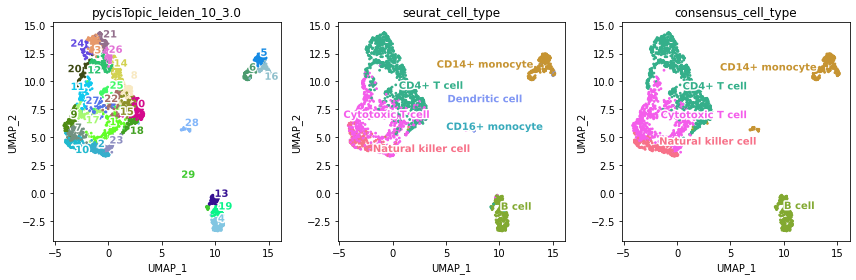

cistopic_objects/CNA_mtscatac_2.FULL__cto.scrublet0-4.fmx.singlets.model_12topics.dimreduc.consensus.pkl already exists!


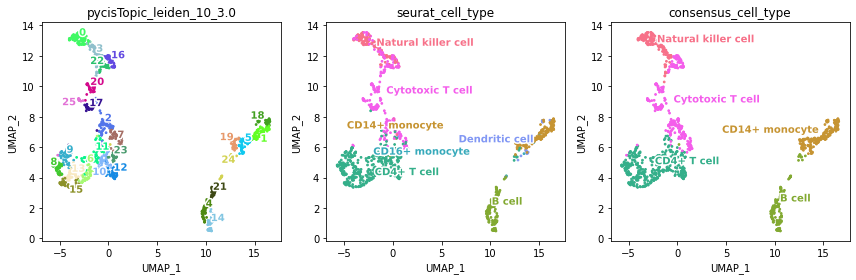

cistopic_objects/EPF_hydrop_1.FULL__cto.scrublet0-4.fmx.singlets.model_8topics.dimreduc.consensus.pkl already exists!


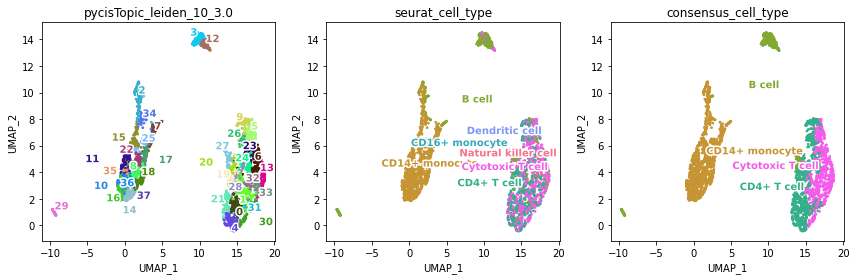

cistopic_objects/EPF_hydrop_2.FULL__cto.scrublet0-4.fmx.singlets.model_8topics.dimreduc.consensus.pkl already exists!


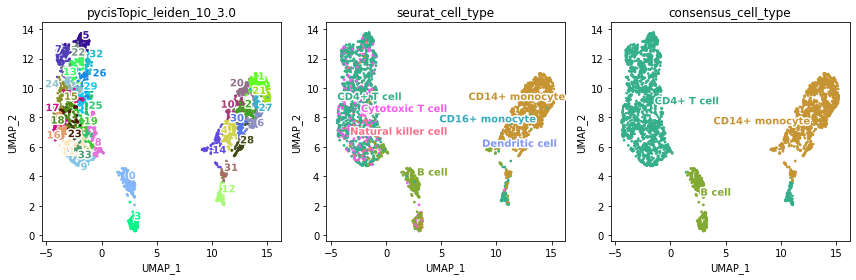

cistopic_objects/EPF_hydrop_3.FULL__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.consensus.pkl already exists!


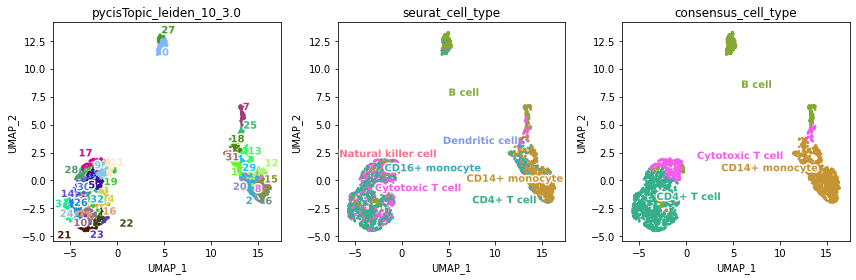

cistopic_objects/EPF_hydrop_4.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.consensus.pkl already exists!


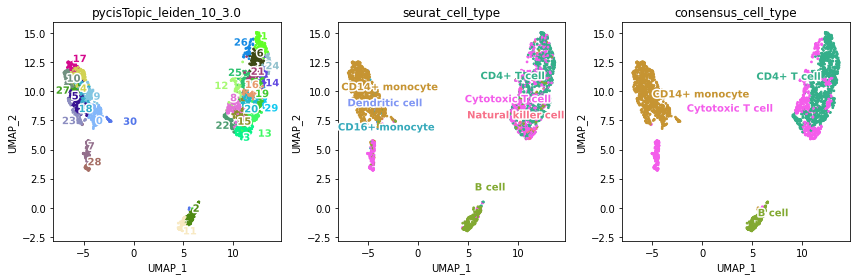

cistopic_objects/HAR_ddseq_1.FULL__cto.scrublet0-4.fmx.singlets.model_8topics.dimreduc.consensus.pkl already exists!


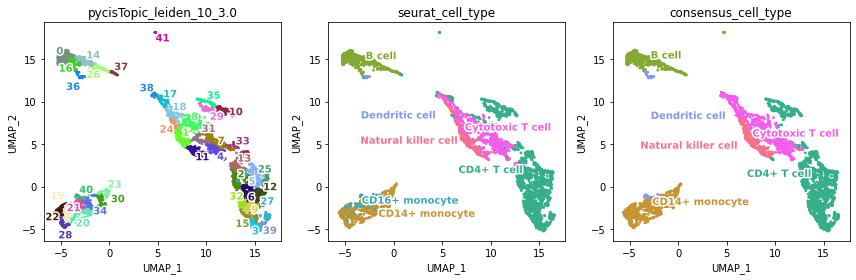

cistopic_objects/HAR_ddseq_2.FULL__cto.scrublet0-4.fmx.singlets.model_12topics.dimreduc.consensus.pkl already exists!


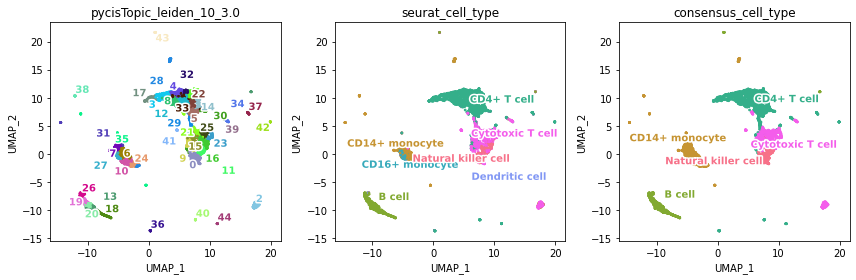

cistopic_objects/MDC_mtscatac_1.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.consensus.pkl already exists!


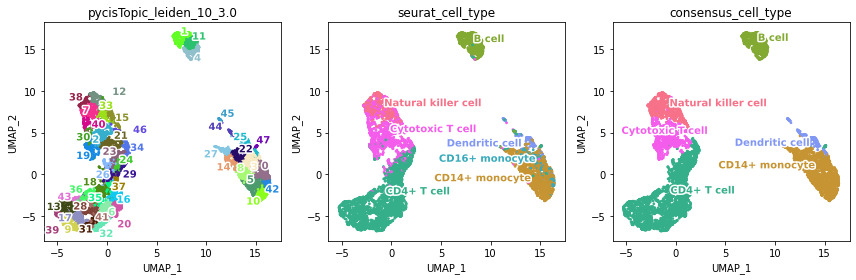

cistopic_objects/MDC_mtscatac_2.FULL__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.consensus.pkl already exists!


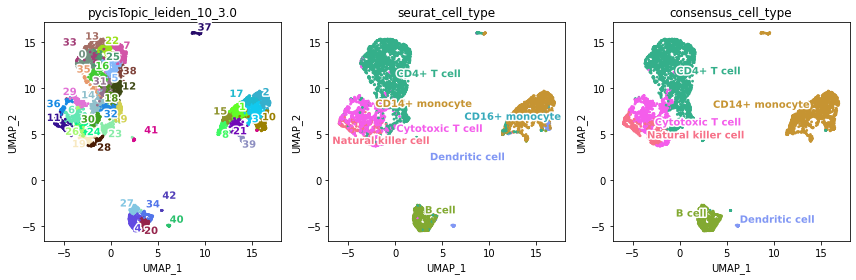

cistopic_objects/OHS_s3atac_1.FULL__cto.scrublet0-4.fmx.singlets.model_13topics.dimreduc.consensus.pkl already exists!


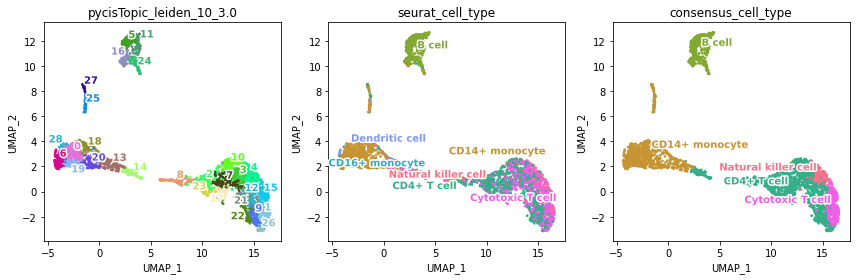

cistopic_objects/OHS_s3atac_2.FULL__cto.scrublet0-4.fmx.singlets.model_7topics.dimreduc.consensus.pkl already exists!


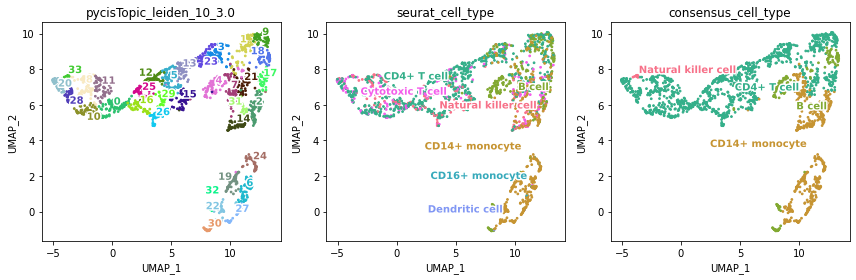

cistopic_objects/SAN_10xmultiome_1.FULL__cto.scrublet0-4.fmx.singlets.model_12topics.dimreduc.consensus.pkl already exists!


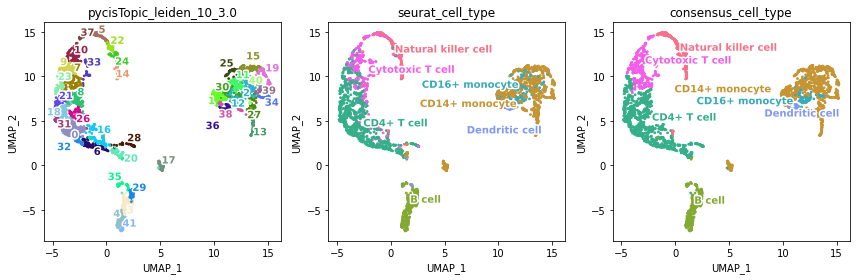

cistopic_objects/SAN_10xmultiome_2.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.consensus.pkl already exists!


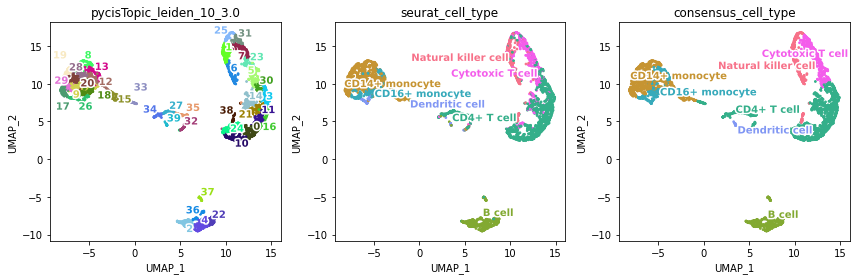

cistopic_objects/STA_10xv11_1.FULL__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.consensus.pkl already exists!


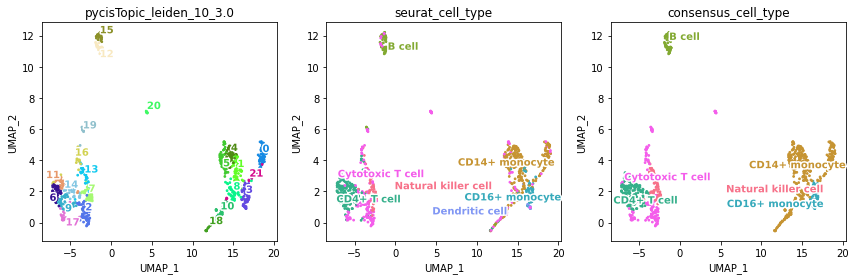

cistopic_objects/STA_10xv11_2.FULL__cto.scrublet0-4.fmx.singlets.model_12topics.dimreduc.consensus.pkl already exists!


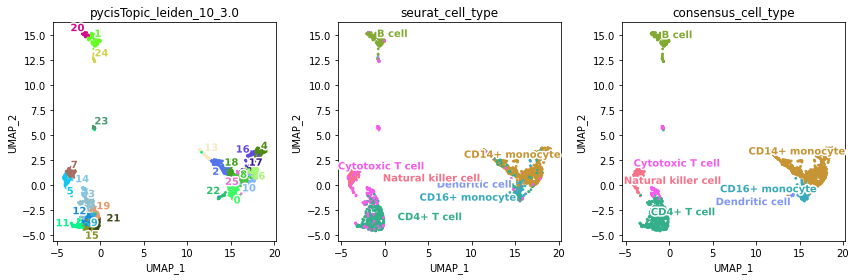

cistopic_objects/TXG_10xv11_1.FULL__cto.scrublet0-4.fmx.singlets.model_16topics.dimreduc.consensus.pkl already exists!


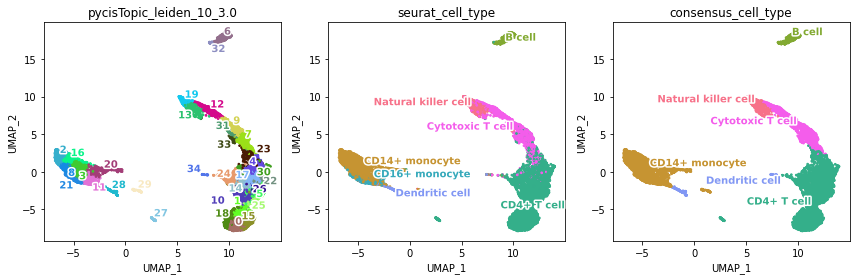

cistopic_objects/TXG_10xv2_1.FULL__cto.scrublet0-4.fmx.singlets.model_18topics.dimreduc.consensus.pkl already exists!


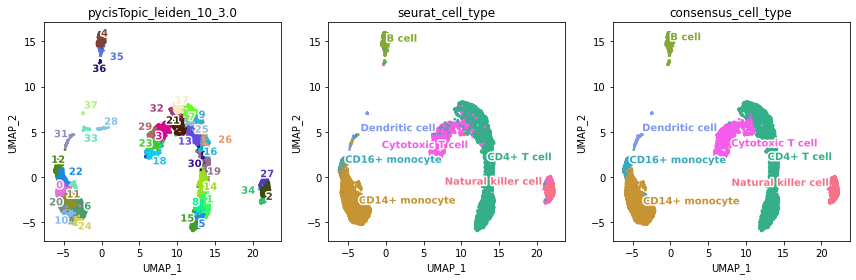

cistopic_objects/TXG_10xv2_2.FULL__cto.scrublet0-4.fmx.singlets.model_16topics.dimreduc.consensus.pkl already exists!


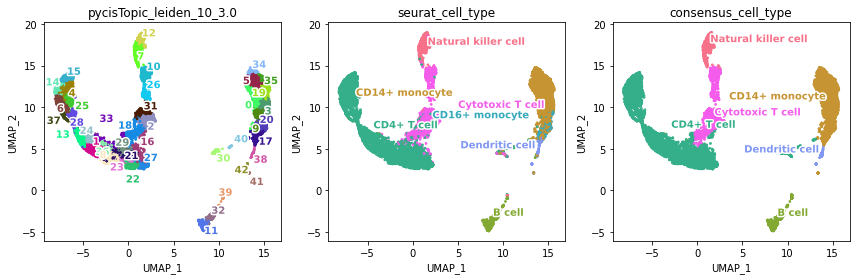

cistopic_objects/UCS_ddseq_1.FULL__cto.scrublet0-4.fmx.singlets.model_12topics.dimreduc.consensus.pkl already exists!


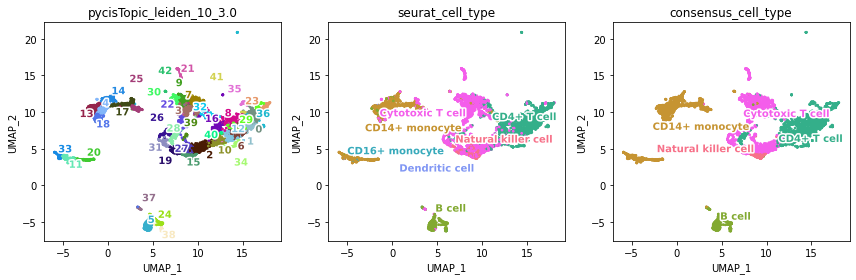

cistopic_objects/UCS_ddseq_2.FULL__cto.scrublet0-4.fmx.singlets.model_17topics.dimreduc.consensus.pkl already exists!


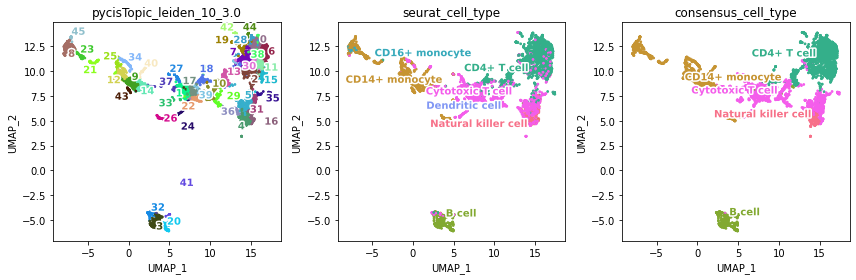

cistopic_objects/VIB_10xmultiome_1.FULL__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.consensus.pkl already exists!


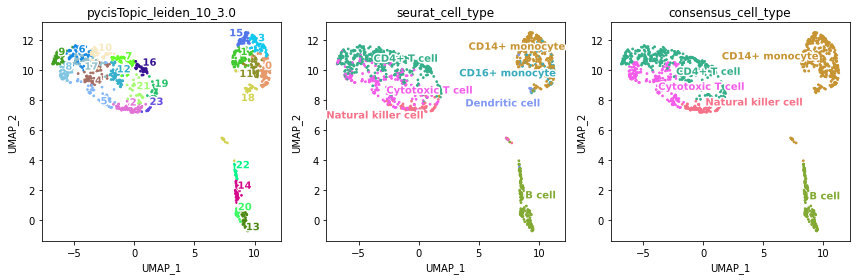

cistopic_objects/VIB_10xmultiome_2.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.consensus.pkl already exists!


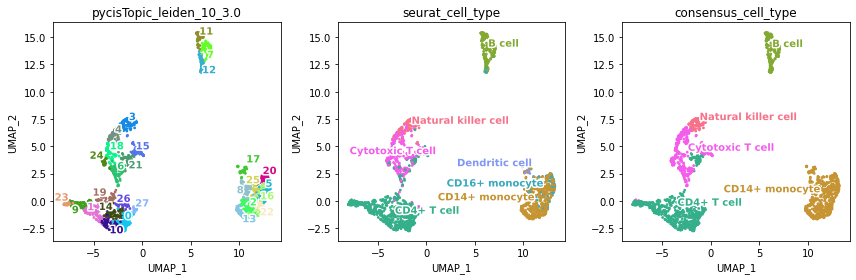

cistopic_objects/VIB_10xv1_1.FULL__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.consensus.pkl already exists!


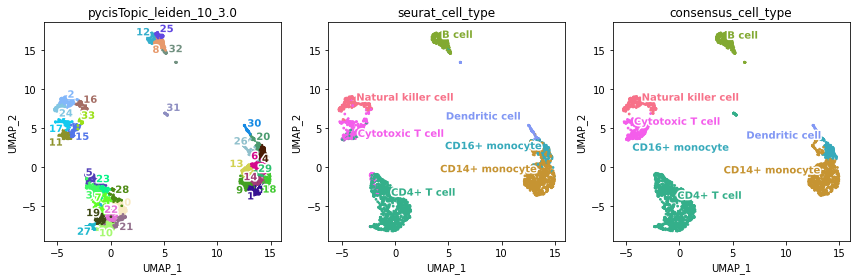

cistopic_objects/VIB_10xv1_2.FULL__cto.scrublet0-4.fmx.singlets.model_8topics.dimreduc.consensus.pkl already exists!


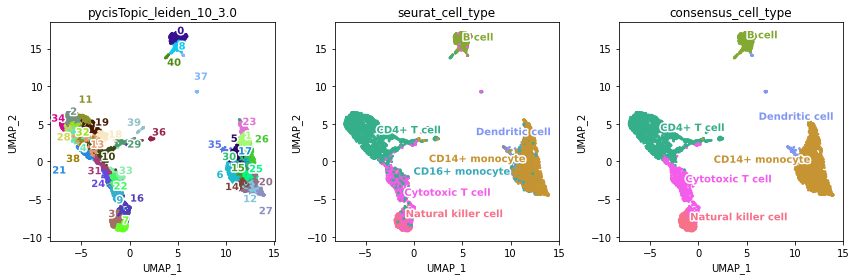

cistopic_objects/VIB_10xv2_1.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.consensus.pkl already exists!


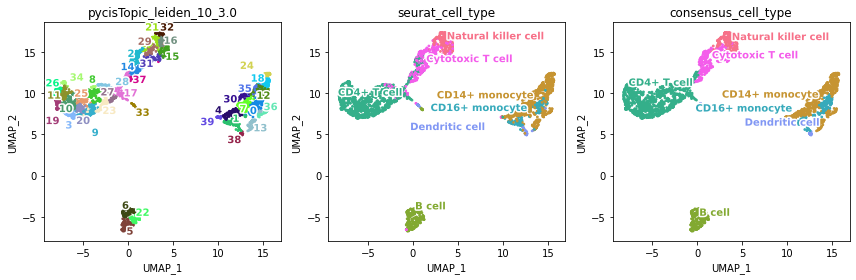

cistopic_objects/VIB_10xv2_2.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.consensus.pkl already exists!


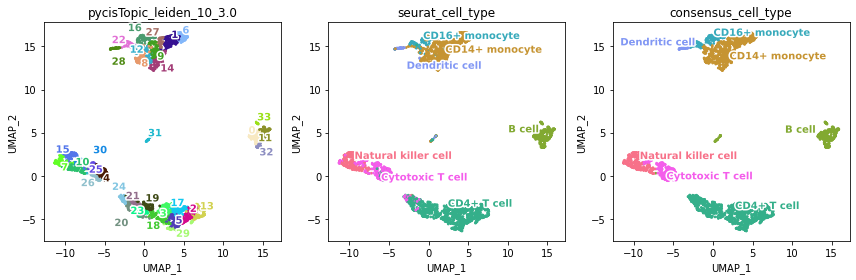

cistopic_objects/VIB_hydrop_1.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.consensus.pkl already exists!


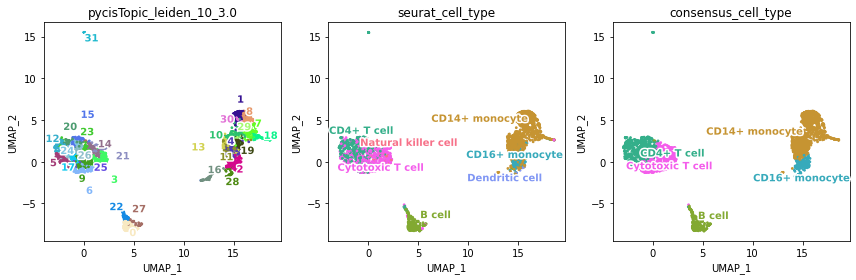

cistopic_objects/VIB_hydrop_11.FULL__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.consensus.pkl already exists!


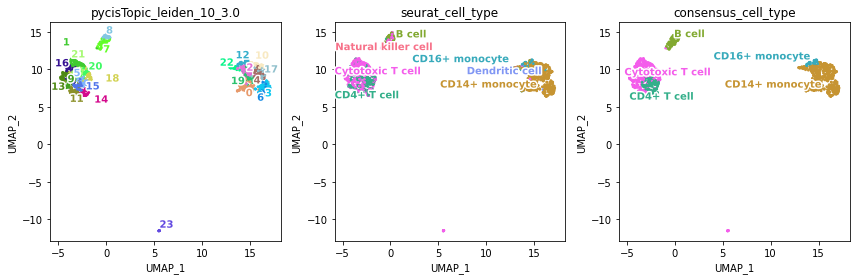

cistopic_objects/VIB_hydrop_12.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.consensus.pkl already exists!


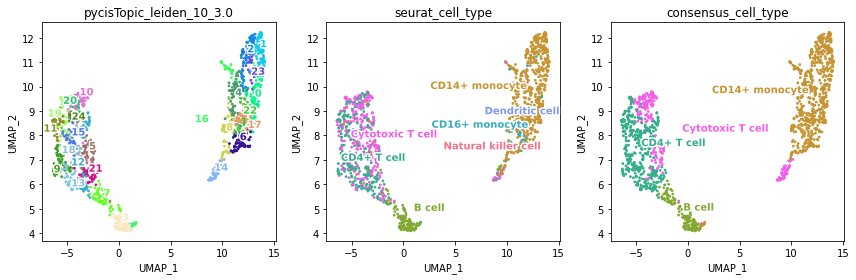

cistopic_objects/VIB_hydrop_2.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.consensus.pkl already exists!


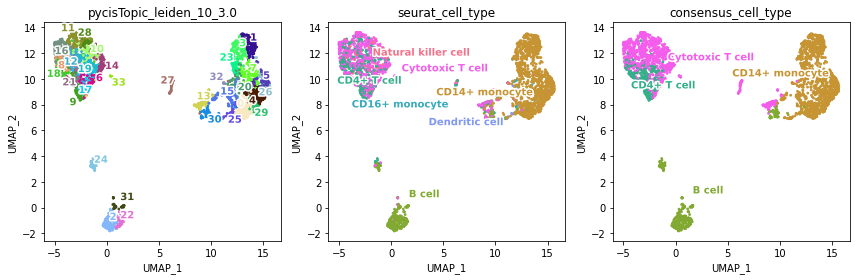

cistopic_objects/VIB_hydrop_21.FULL__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.consensus.pkl already exists!


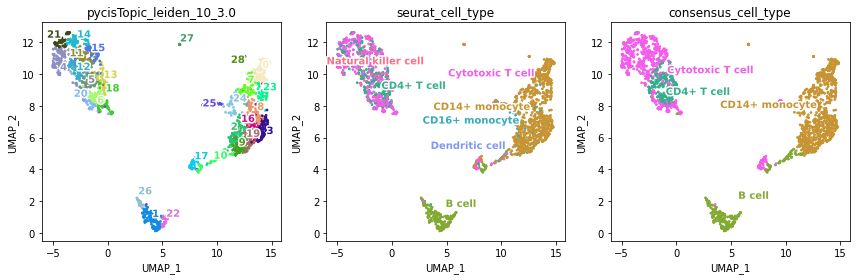

cistopic_objects/VIB_hydrop_22.FULL__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.consensus.pkl already exists!


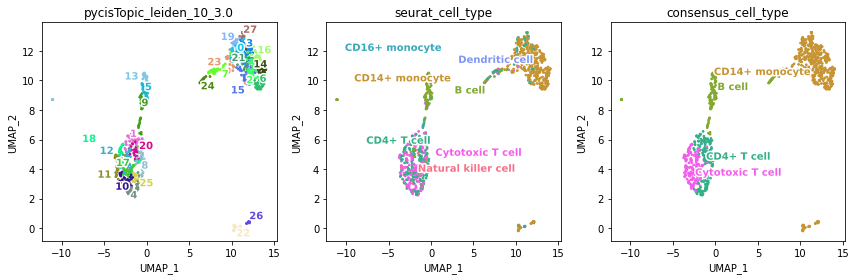

In [18]:
clustering='pycisTopic_leiden_10_3.0'
ct_pred_thr=0.7

to_plot = [clustering, 'seurat_cell_type', "consensus_cell_type"]
n_to_plot = len(to_plot)
n_cols = 3
n_rows = math.ceil(n_to_plot/n_cols)

clust_consensus = []
write = True
# for sample in ["BRO_mtscatac_1.LIBDS"]:
for sample in cto_model_path_dict.keys():
    cto_path = cto_model_path_dict[sample]
    cto_path_new = cto_path.replace(".pkl", ".consensus.pkl")
    if not os.path.exists(cto_path_new):
        with open(cto_path, 'rb') as f:
            cto = pickle.load(f)
        
        major_cell_type = []
        frac_of_cluster = []
        next_celltype = []
        next_frac_of_cluster = []
        diff_to_next = []
        
        celldata = cto.cell_data
        
        for c in celldata[clustering].unique():
            c1 = celldata[celldata[clustering]==c]
            # find proportions of each unique cell type detected in this cluster:
            ctp = pd.DataFrame([
                c1['seurat_cell_type'].unique(),
                [ c1[c1['seurat_cell_type']==x].shape[0] / c1.shape[0] for x in c1['seurat_cell_type'].unique() ]
            ]).T
            # sort/rank by proportion:
            ctps = ctp.sort_values(1,ascending=False)
            if ctp.shape[0]>1:
                n = ctps.iloc[1,0] # next cell type detected
                dtn = ctps.iloc[0,1] - ctps.iloc[1,1] # distance to next
                dtnf = ctps.iloc[1,1]
            else:
                dtn = None
                dtnf = None
                n = None
            major_cell_type.append(ctps.iloc[0,0])
            frac_of_cluster.append(ctps.iloc[0,1])
            next_celltype.append(n)
            next_frac_of_cluster.append(dtnf)
            diff_to_next.append(dtn)

        # collect results for this sample
        clust_consensus = pd.DataFrame([
                celldata[clustering].unique(),
                major_cell_type,
                frac_of_cluster,
                next_celltype,
                next_frac_of_cluster,
                diff_to_next,
            ]).T.set_axis(
                ['cluster', 'major_cell_type', 'frac_of_cluster', 
                 'next_celltype', 'next_frac_of_cluster', 'diff_to_next'],
                axis=1
            ).set_index(sample + '__' + celldata[clustering].unique())
        print(sample)
        clust_consensus['cluster_counts'] = clust_consensus['cluster'].map(celldata[clustering].value_counts())
        # print only rows where there is another cell type within 20%:
        if(sum(clust_consensus['diff_to_next']<0.20)>0):
            display(clust_consensus[ clust_consensus['diff_to_next']<0.20 ])
            
        else:
            print("No discrepant clusters")
            
        # add the mapping
        cto.cell_data['consensus_cell_type'] = ""
        for i,r in clust_consensus.iterrows():
            ix = cto.cell_data[clustering] == r['cluster']
            cto.cell_data.loc[ix,'consensus_cell_type'] = r['major_cell_type']
        
        plot_metadata(cto,
                      reduction_name='UMAP',
                      variables=to_plot,
                      target='cell',
                      num_columns=n_cols,
                      text_size=10,
                      dot_size=3,
                      figsize=(n_cols*4,n_rows*4),
                      save=f'plots_qc/{sample}__consensus_clusters_qc.png',
                      color_dictionary=palette_dict
                     )
        
        if write == True:
            with open(cto_path_new, 'wb') as f:
                pickle.dump(cto, f)
            print("dumped_cto")
    else:
        print(f'{cto_path_new} already exists!')
        display(Image(f'plots_qc/{sample}__consensus_clusters_qc.png'))
